# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [1]:
# if plotnine is not installed in Jupter then use the following command to install it 
!pip install plotnine

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!pip install  --upgrade kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Running this project require the following imports 

In [98]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
from sklearn.datasets import load_iris
import scipy.spatial.distance 
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
from kneed import KneeLocator
import scipy.cluster.hierarchy as shc 
from sklearn.cluster import SpectralClustering
from sklearn.metrics import pairwise_distances
%matplotlib inline

In [123]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



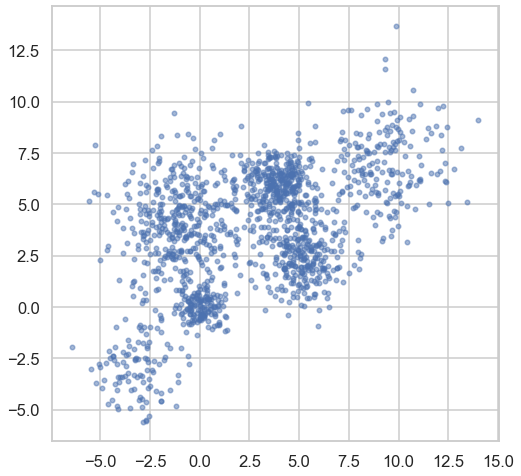

In [124]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* ***Use Kmeans with different values of K to cluster the above data ***
* ***Display the outcome of each value of K ***
* ***Plot distortion function versus K and choose the approriate value of k ***
* **Plot the silhouette_score versus K and use it to choose the best K** 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

Kmeans is one of the Clustering Techniques that is usedin order to cluster or group data .
It can be used to group data with certain features , values , etc.

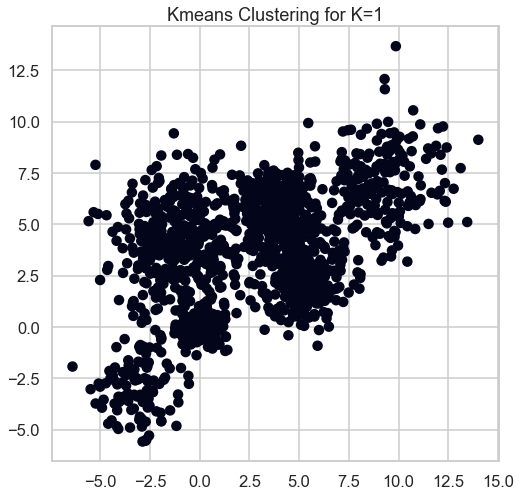

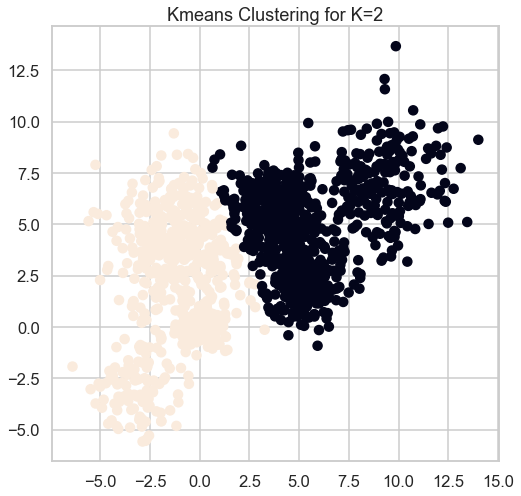

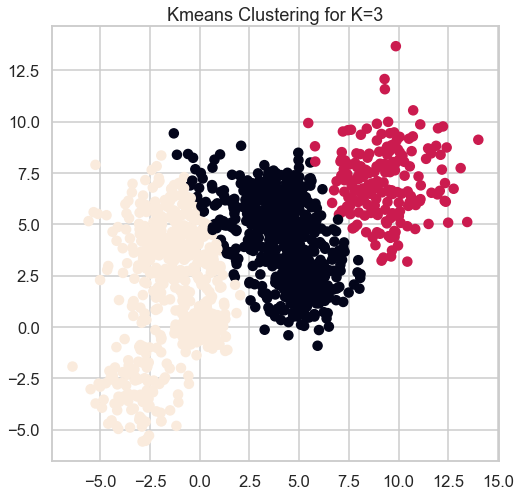

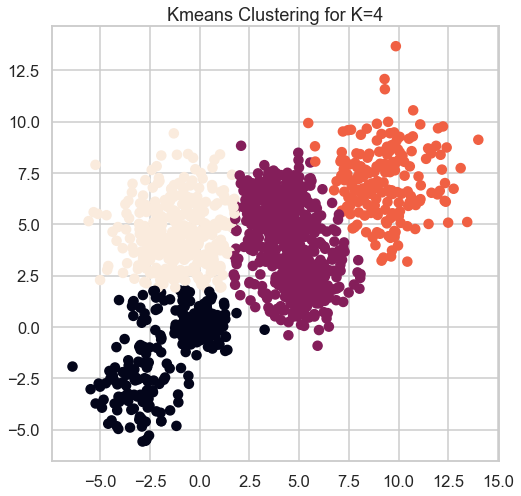

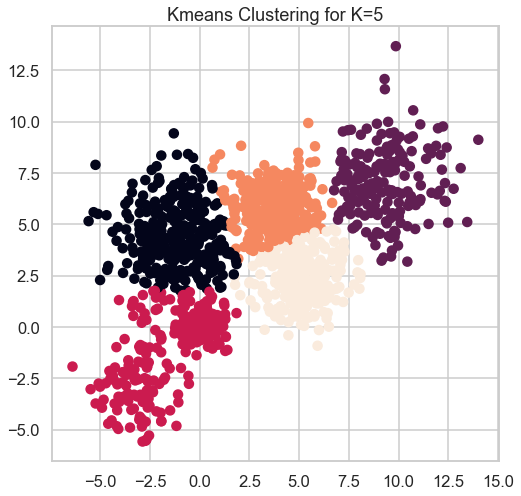

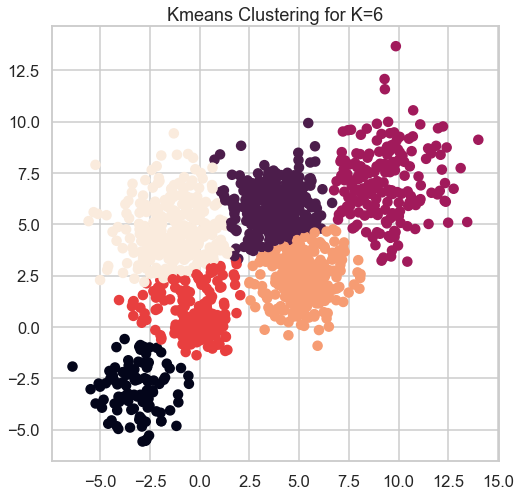

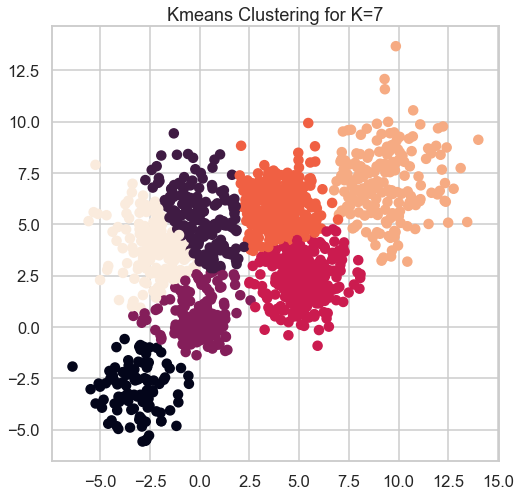

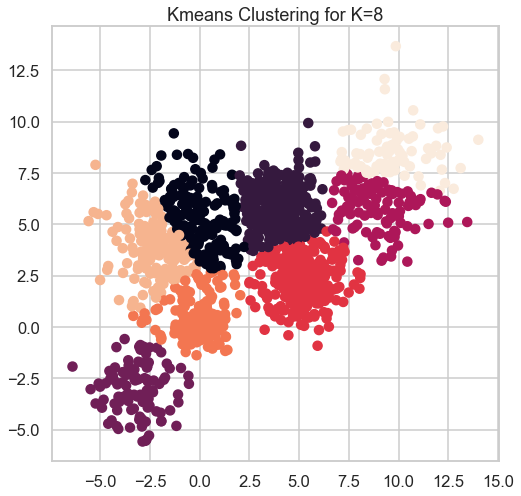

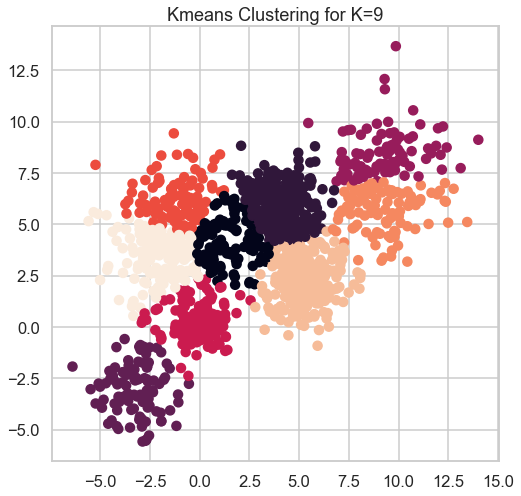

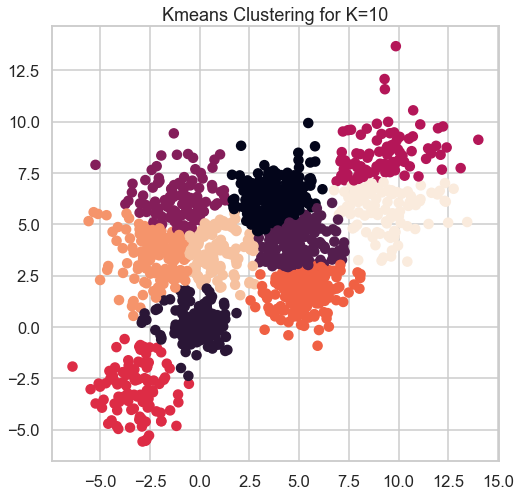

In [9]:
#Kmeans Clustering From 1 to 10 clusters
labels=[]
for k in range (1,11):
    kmeans = KMeans(n_clusters = k)
    #Fit the model to the data samples
    kmeans.fit(Multi_blob_Data)
    #Predict the cluster that each data sample belongs to using .predict() and store these as labels
    labels = kmeans.predict(Multi_blob_Data)
    plt.scatter(Multi_blob_Data[:,0], Multi_blob_Data[:,1], c=kmeans.labels_)
    plt.title("Kmeans Clustering for K="+str(k))
    plt.show()

Now there are two methods to detemine the optimal value of k clusters for the dataset.
1-Elbow Method
2-Silhouette Score

Elbow Method
(The metric used is cluster sum of squares): the distance of every point from its corresponding cluster center after clustering
The smaller value the better


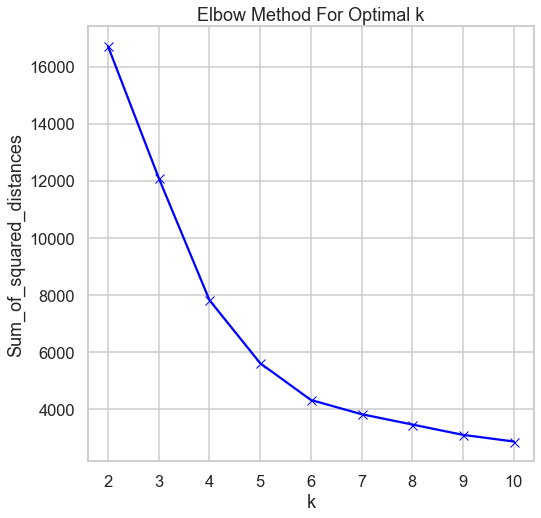

5

In [42]:
inertia = []
K = range(2,11)
distortions=[]
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(Multi_blob_Data)
    inertia.append(km.inertia_)
    distortions.append(sum(np.min(scipy.spatial.distance.cdist(Multi_blob_Data,
    km.cluster_centers_, 'euclidean'),axis=1)) /
    Multi_blob_Data.shape[0])
    
plt.plot(K, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()
kl = KneeLocator(range(2, 11), inertia, curve="convex", direction="decreasing")
kl.elbow

Silhouette Score

Silhouette Score for k=2 is 0.4751544541991239
Silhouette Score for k=3 is 0.43631793714185435
Silhouette Score for k=4 is 0.4628725400351352
Silhouette Score for k=5 is 0.48100602217073096
Silhouette Score for k=6 is 0.48614459735646176
Silhouette Score for k=7 is 0.46340972197949165
Silhouette Score for k=8 is 0.4444601357188936
Silhouette Score for k=9 is 0.4418780793091289
Silhouette Score for k=10 is 0.39663471004349216


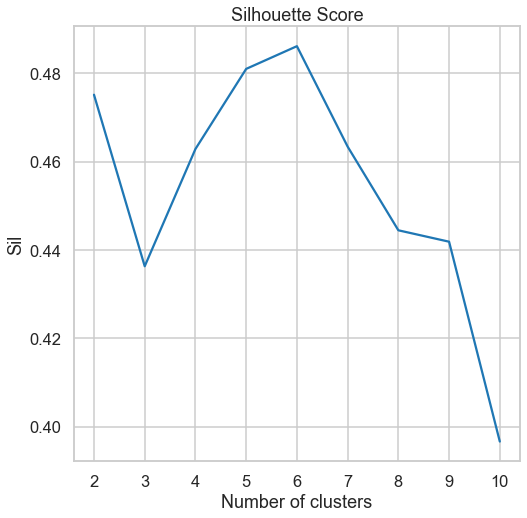

In [10]:
sil = []
scores=[]

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, 11):
  kmeans = KMeans(n_clusters = k).fit(Multi_blob_Data)
  labels = kmeans.labels_
  score=np.array(silhouette_score(Multi_blob_Data, labels))
  sil.append(score)
  print("Silhouette Score for k="+str(k),"is",str(score))
plt.plot(range(2, 11), sil)
plt.title('Silhouette Score')
plt.xlabel('Number of clusters')
plt.ylabel('Sil')
plt.show()


### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

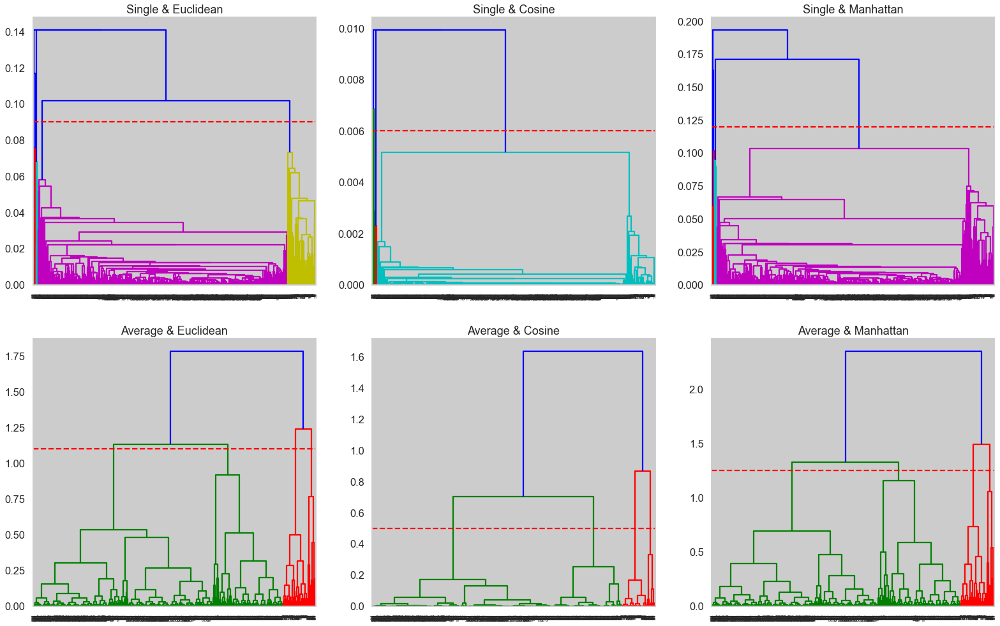

In [9]:

from sklearn.preprocessing import normalize
X1 = normalize(Multi_blob_Data)
Z1 = shc.linkage(X1, method='single', metric='euclidean')
Z2 = shc.linkage(X1, method='single', metric='cosine')
Z3 = shc.linkage(X1, method='single', metric='cityblock')
Z4 = shc.linkage(X1, method='average', metric='euclidean')
Z5 = shc.linkage(X1, method='average', metric='cosine')
Z6 = shc.linkage(X1, method='average', metric='cityblock')
plt.figure(figsize=(27, 17))
plt.subplot(2,3,1), dendrogram(Z1), plt.title('Single & Euclidean'),plt.axhline(y=0.09, color='r', linestyle='--')
plt.subplot(2,3,2), dendrogram(Z2), plt.title('Single & Cosine'),plt.axhline(y=0.006, color='r', linestyle='--')
plt.subplot(2,3,3), dendrogram(Z3), plt.title('Single & Manhattan'),plt.axhline(y=0.12, color='r', linestyle='--')
plt.subplot(2,3,4), dendrogram(Z4), plt.title('Average & Euclidean'),plt.axhline(y=1.1, color='r', linestyle='--')
plt.subplot(2,3,5), dendrogram(Z5), plt.title('Average & Cosine'),plt.axhline(y=0.5, color='r', linestyle='--')
plt.subplot(2,3,6), dendrogram(Z6), plt.title("Average & Manhattan"),plt.axhline(y=1.25, color='r', linestyle='--')
plt.show()

In [49]:
kmax=11
hierarchical_kscore = [0] * kmax

for k in range(2,kmax):
    hierarchical = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='single').fit(Multi_blob_Data)
    hierarchical_kscore[k] = silhouette_score(Multi_blob_Data, kmeans.labels_)
hierarchical_best_k = np.argmax(hierarchical_kscore)
hierarchical_best_k

2

[19.4648693   5.46304721]


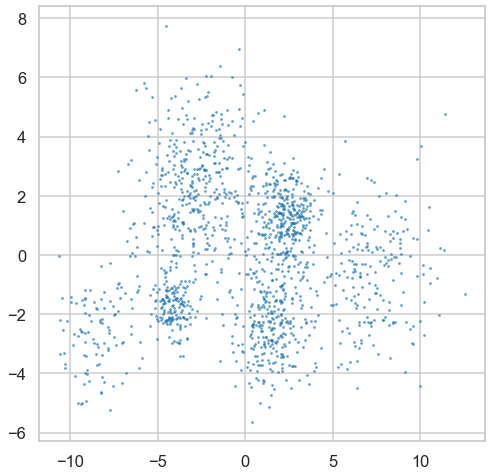

In [7]:
from sklearn.decomposition import PCA
#PCA with two principal components
PCA_2d = PCA(n_components=2).fit(Multi_blob_Data)
#PCA_2d.head()
print(PCA_2d.explained_variance_)
PCA_2d = PCA(n_components=2).fit_transform(Multi_blob_Data)
plt.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7, edgecolor='k')

Euclidean & Average
(Based on Silhouette Score best K is 4 clusters)

For n_clusters = 2 The average silhouette_score is : 0.4716908069861964
For n_clusters = 3 The average silhouette_score is : 0.4307906732655957
For n_clusters = 4 The average silhouette_score is : 0.4490582469502603
For n_clusters = 5 The average silhouette_score is : 0.433187948807373
For n_clusters = 6 The average silhouette_score is : 0.41478815574933364
For n_clusters = 7 The average silhouette_score is : 0.3628728418024079
For n_clusters = 8 The average silhouette_score is : 0.3239073246461488
For n_clusters = 9 The average silhouette_score is : 0.3831563063543532
For n_clusters = 10 The average silhouette_score is : 0.37378418096239385


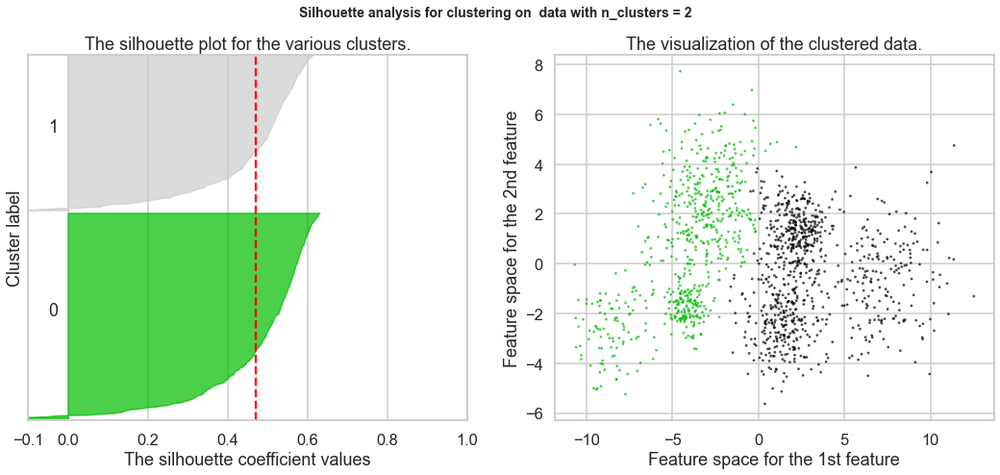

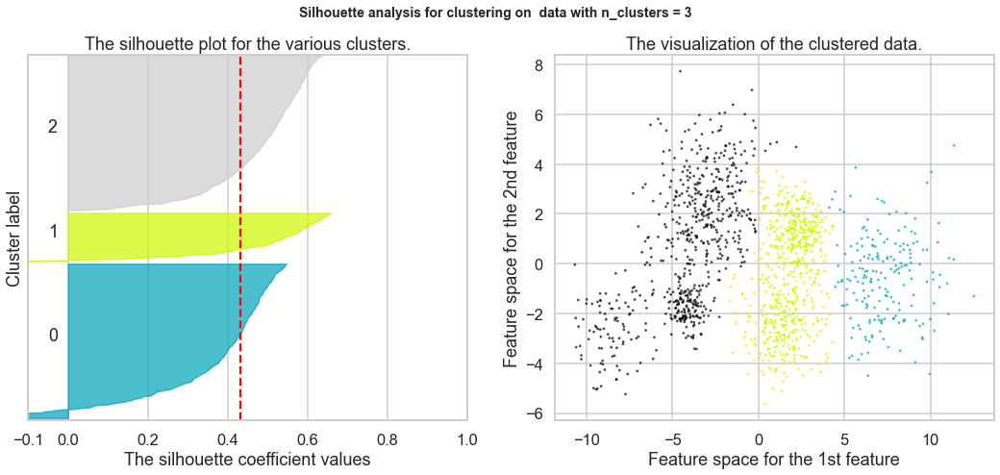

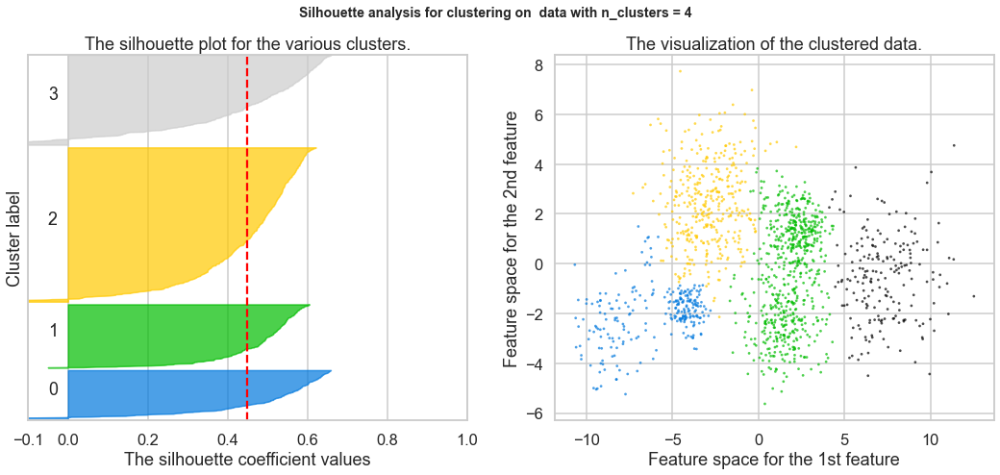

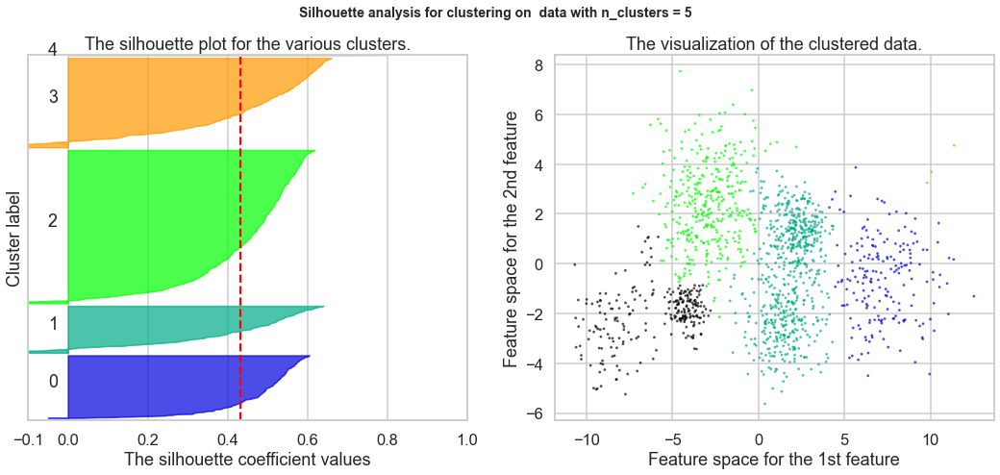

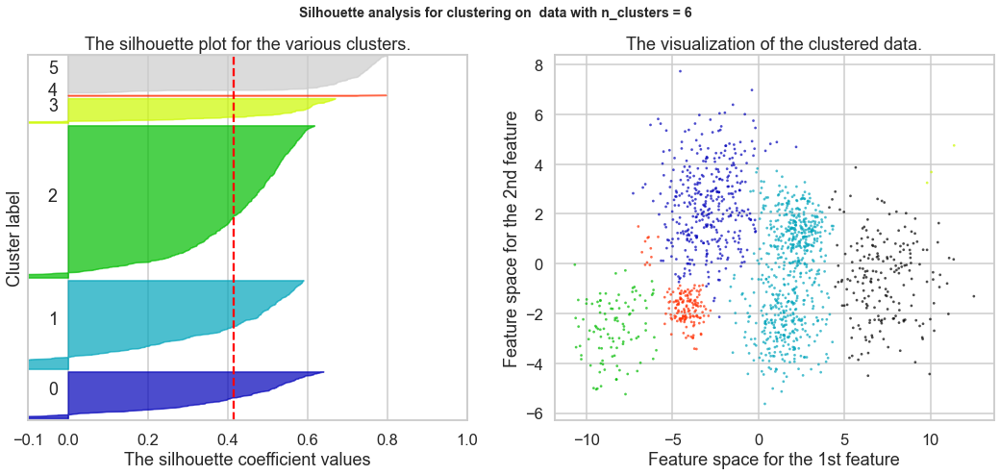

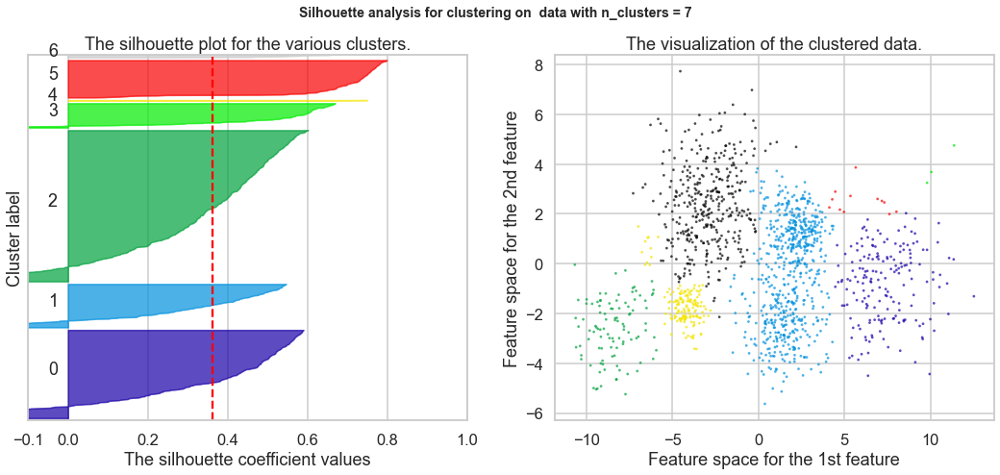

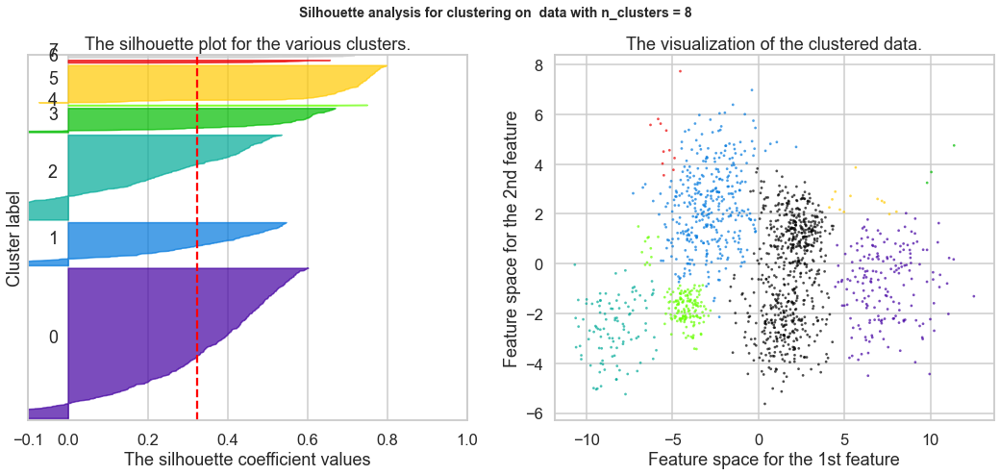

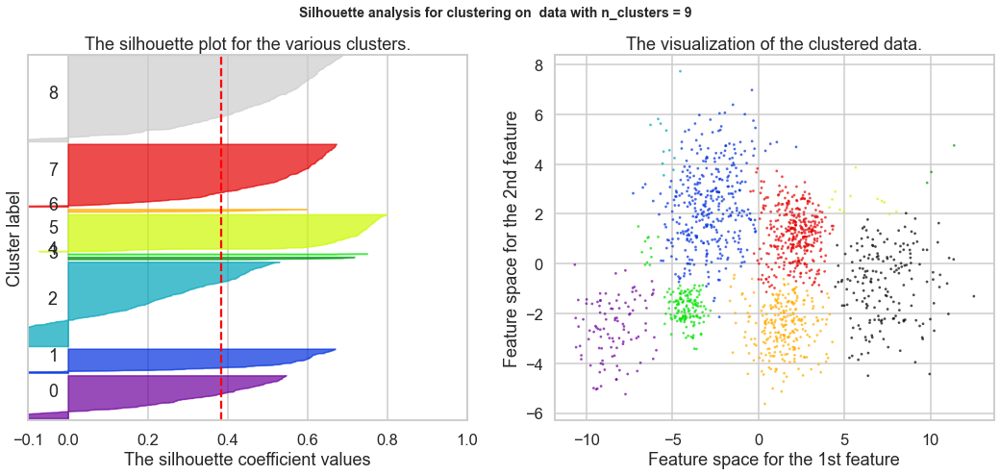

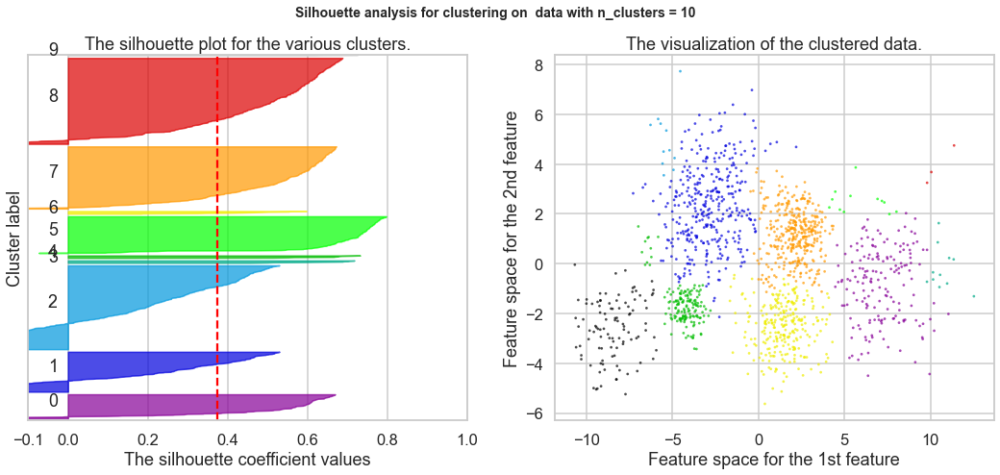

In [10]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='average')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Euclidean & Single
(Based on Silhouette Score best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.3218066204847175
For n_clusters = 3 The average silhouette_score is : 0.23622772250901033
For n_clusters = 4 The average silhouette_score is : 0.2074012584493559
For n_clusters = 5 The average silhouette_score is : 0.17400752332621522
For n_clusters = 6 The average silhouette_score is : 0.08705564851389591
For n_clusters = 7 The average silhouette_score is : -0.0677592570476665
For n_clusters = 8 The average silhouette_score is : -0.144702446818925
For n_clusters = 9 The average silhouette_score is : -0.14944154607335855
For n_clusters = 10 The average silhouette_score is : -0.16229244637257356


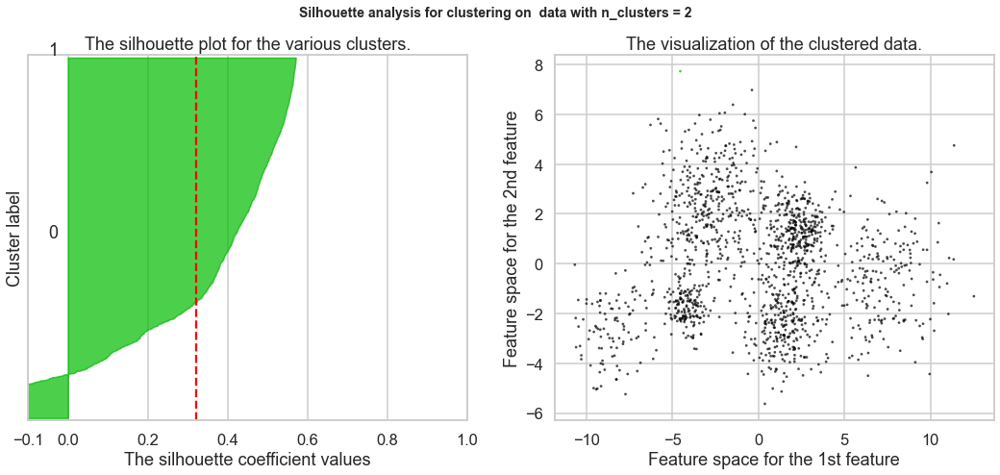

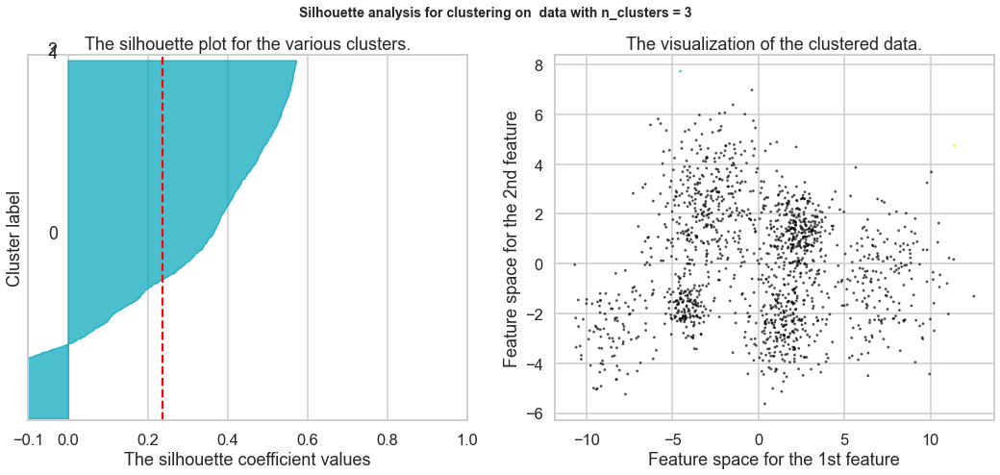

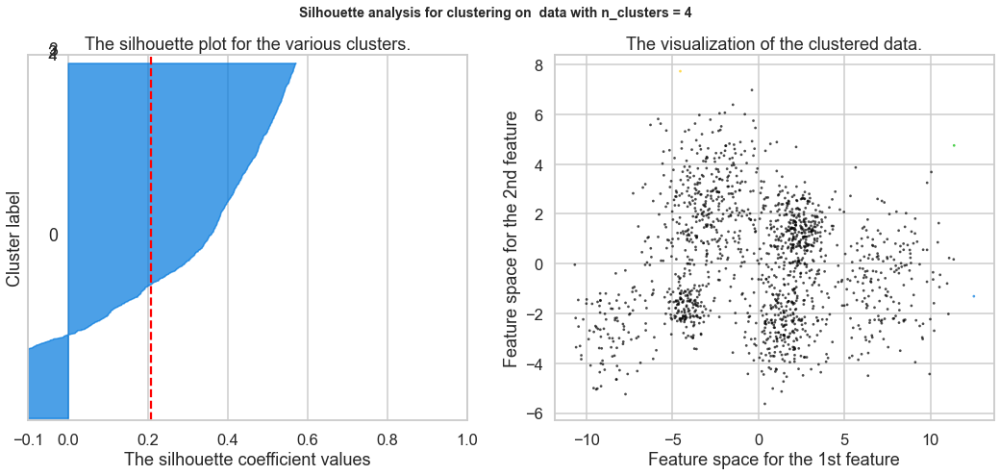

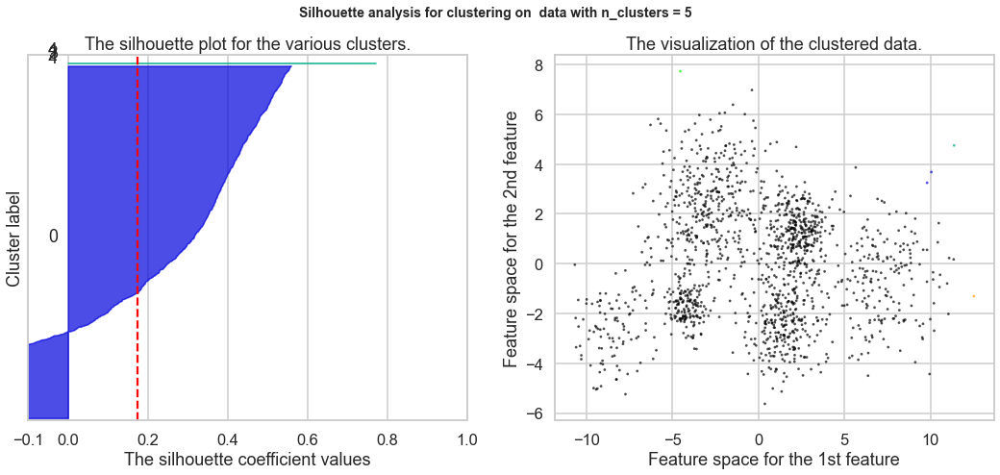

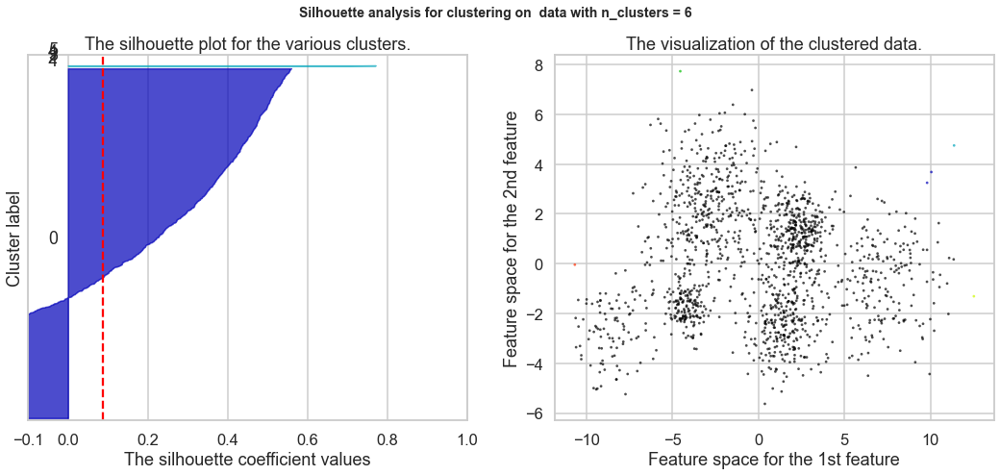

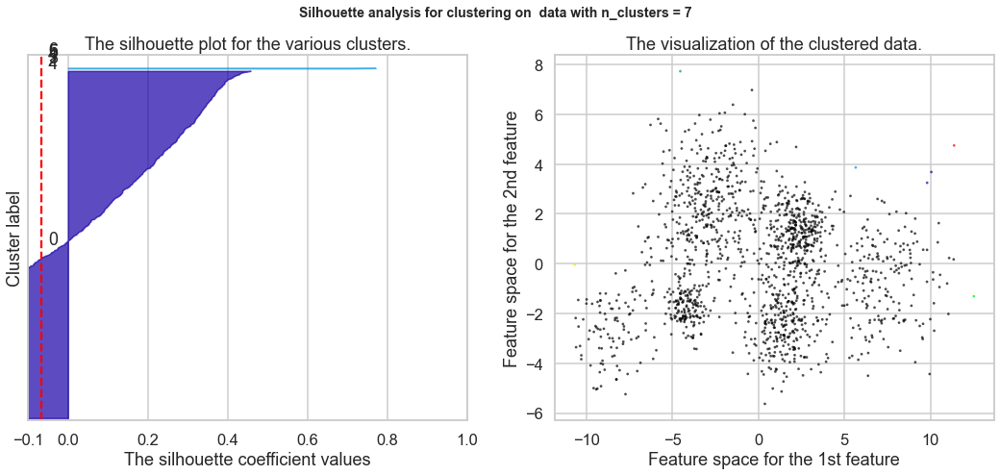

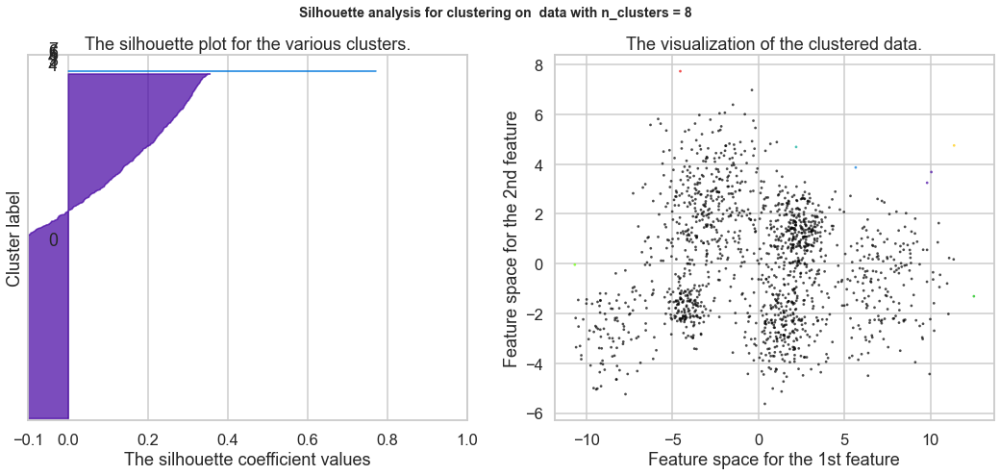

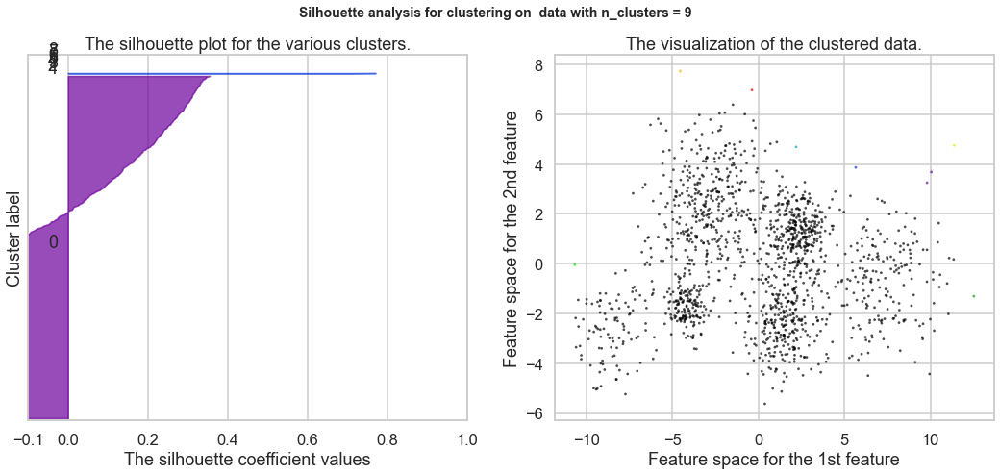

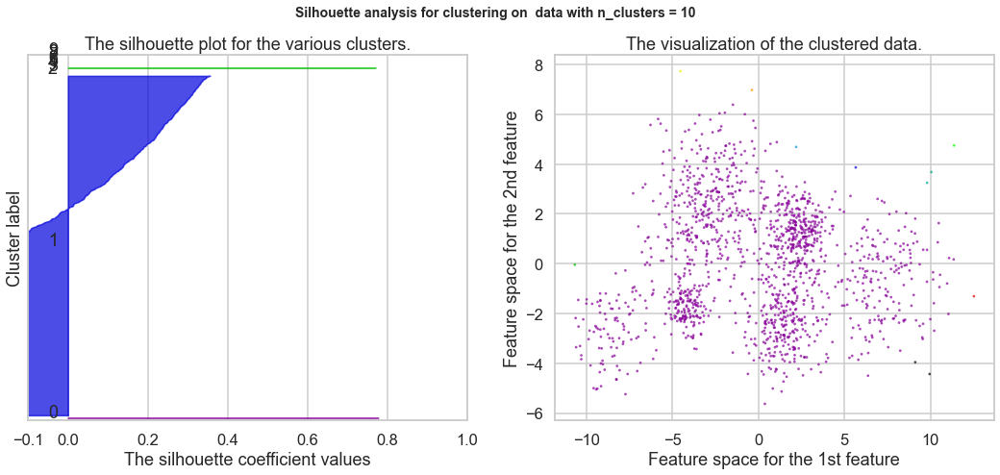

In [11]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='single')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Cosine & Average
(Based on Silhouette Score best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.35251834131557364
For n_clusters = 3 The average silhouette_score is : 0.13500755155170832
For n_clusters = 4 The average silhouette_score is : 0.28022113778340446
For n_clusters = 5 The average silhouette_score is : 0.24927357773894548
For n_clusters = 6 The average silhouette_score is : 0.2035575393889621
For n_clusters = 7 The average silhouette_score is : 0.181336268349682
For n_clusters = 8 The average silhouette_score is : 0.16929456557833833
For n_clusters = 9 The average silhouette_score is : 0.1586676065286782
For n_clusters = 10 The average silhouette_score is : 0.13279922849410558


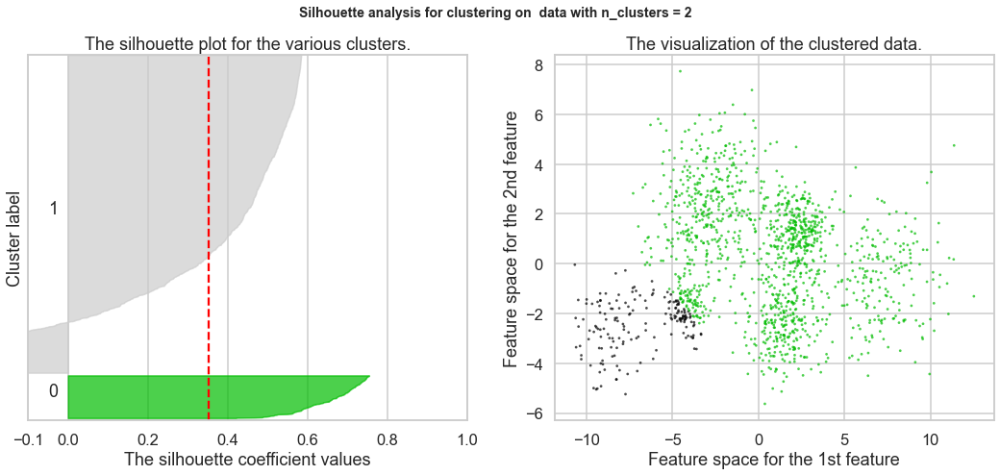

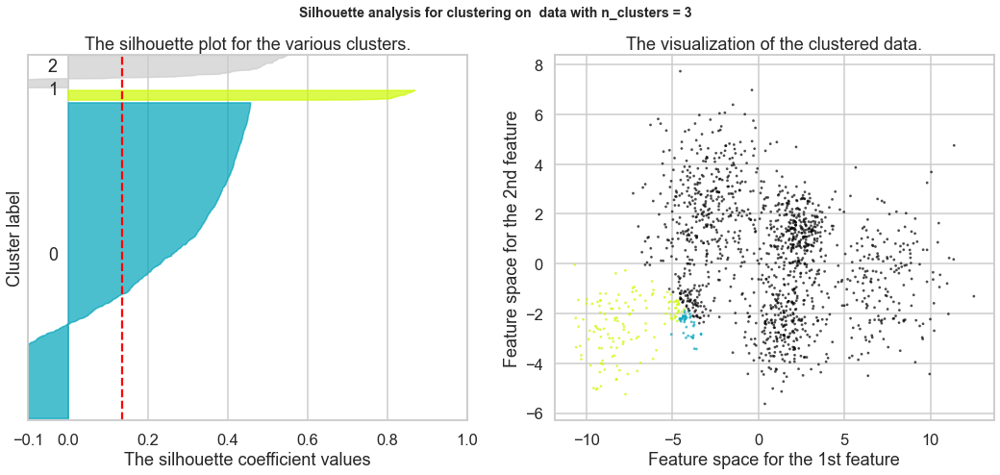

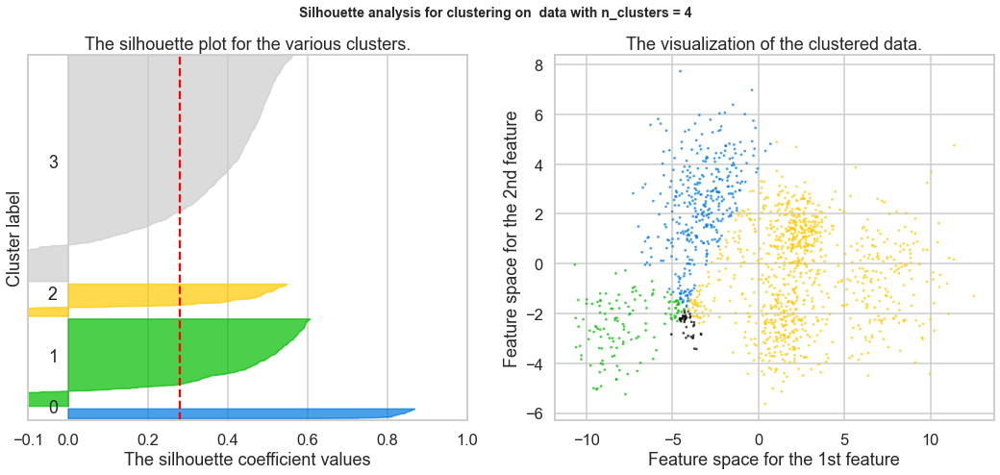

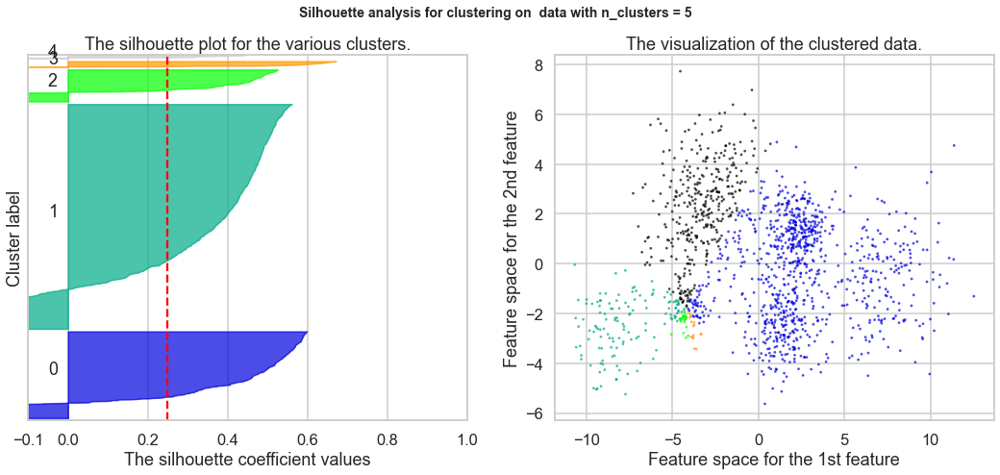

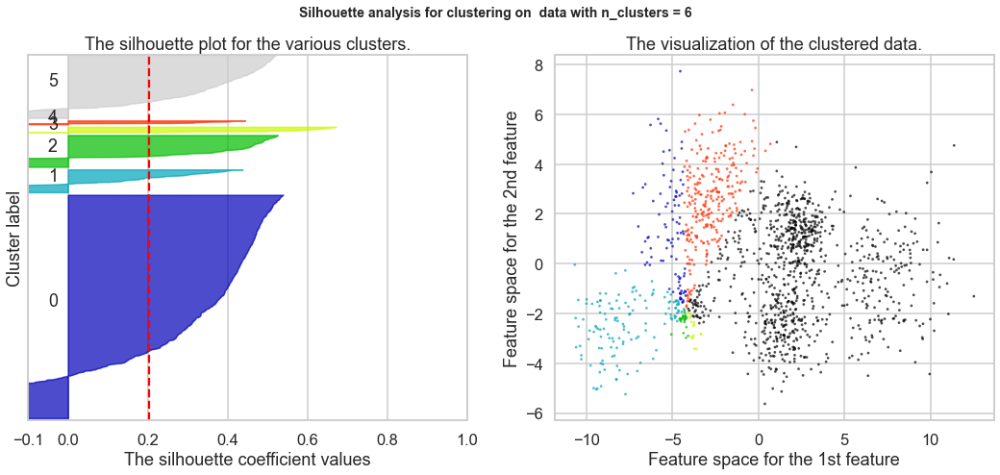

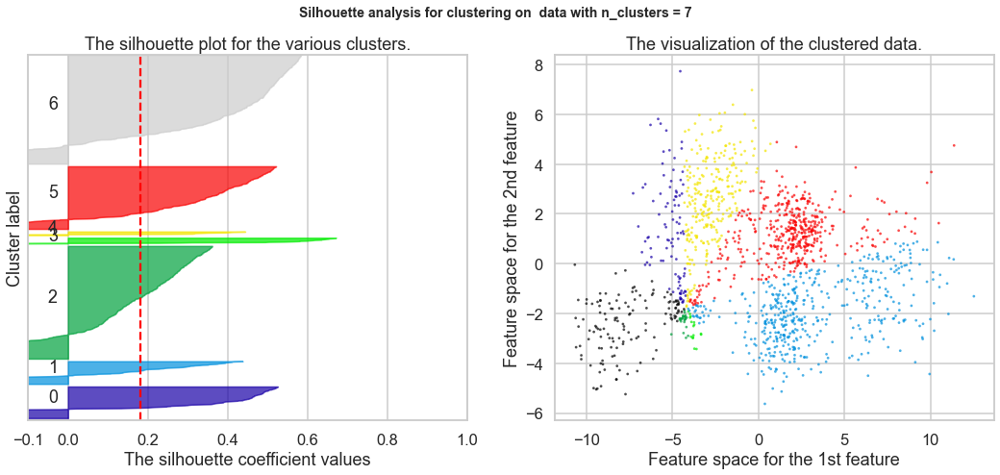

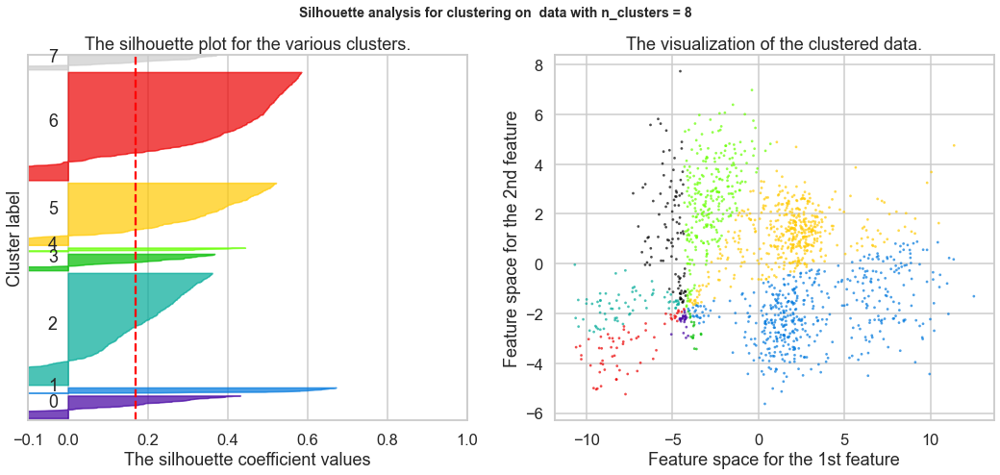

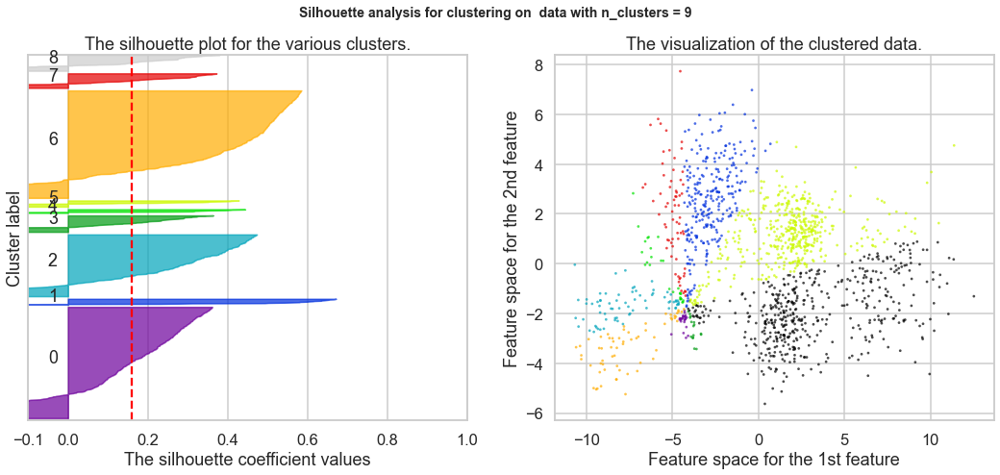

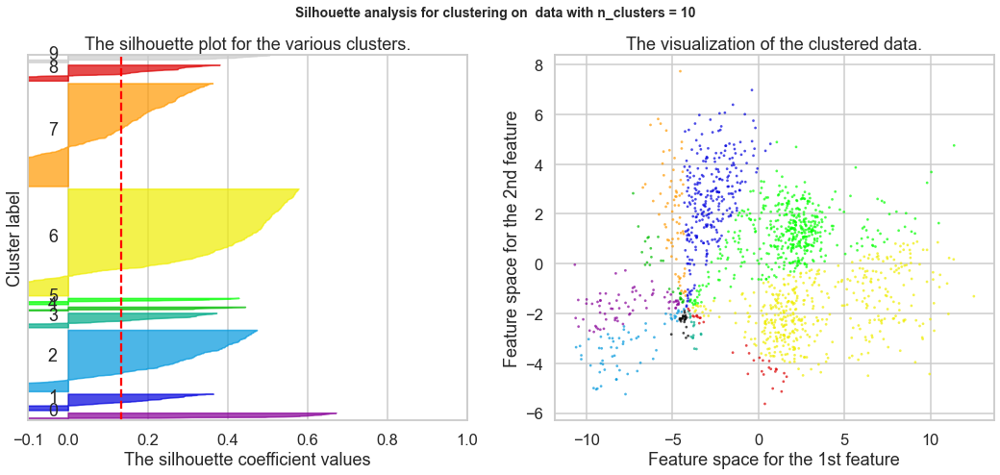

In [12]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='average')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Cosine & Single
(Based on Silhouette Score best K is 6 clusters)

For n_clusters = 2 The average silhouette_score is : -0.016763591291336317
For n_clusters = 3 The average silhouette_score is : -0.027300281882024397
For n_clusters = 4 The average silhouette_score is : -0.03872065159633617
For n_clusters = 5 The average silhouette_score is : 0.07699405164704985
For n_clusters = 6 The average silhouette_score is : 0.07162243486315635
For n_clusters = 7 The average silhouette_score is : 0.06651618506054162
For n_clusters = 8 The average silhouette_score is : 0.06578628874743636
For n_clusters = 9 The average silhouette_score is : 0.06552123013272089
For n_clusters = 10 The average silhouette_score is : 0.040594337326923476


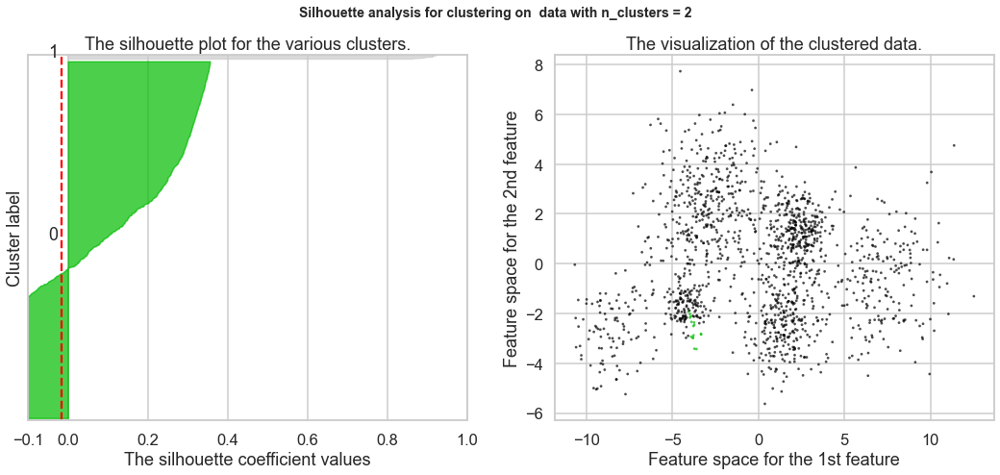

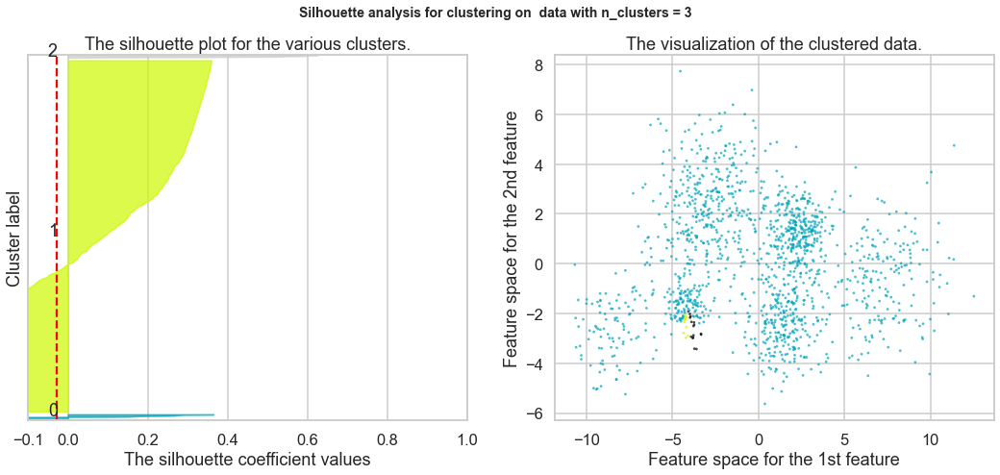

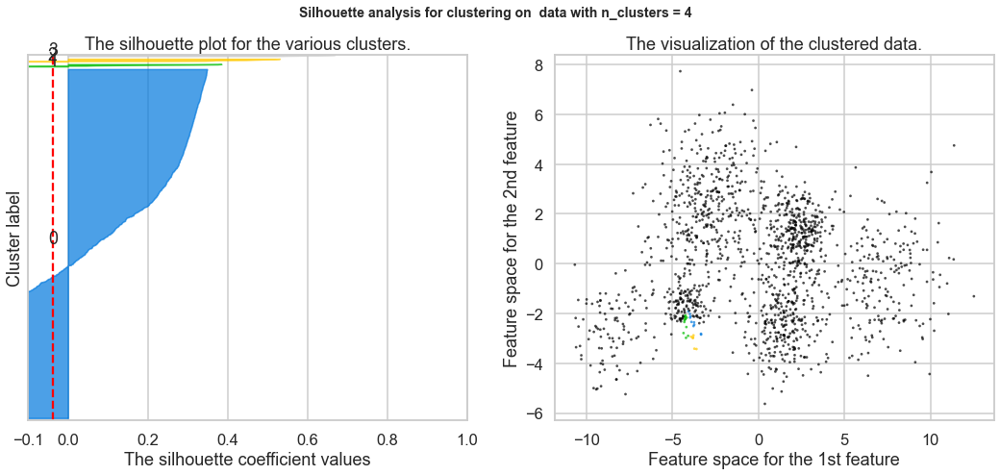

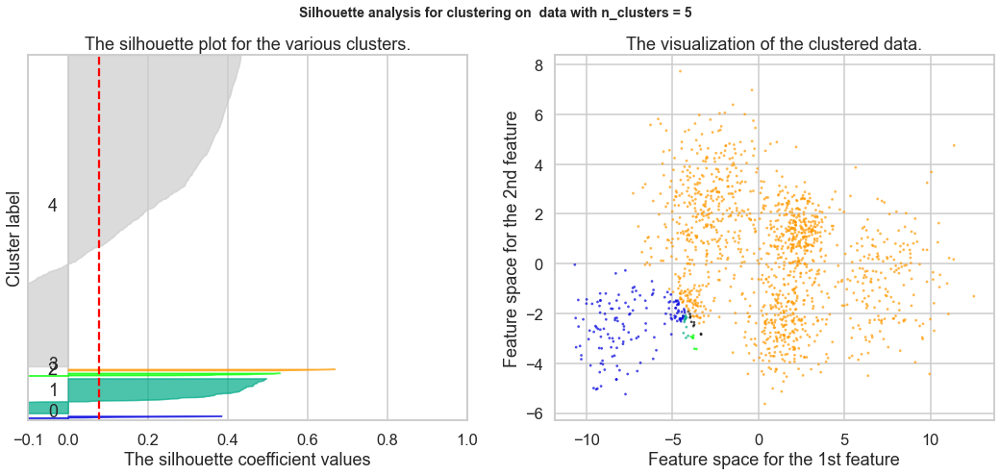

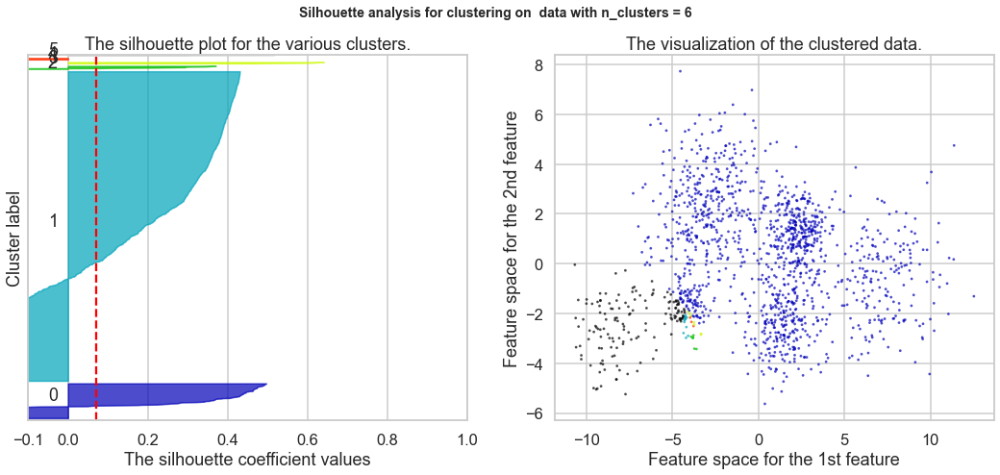

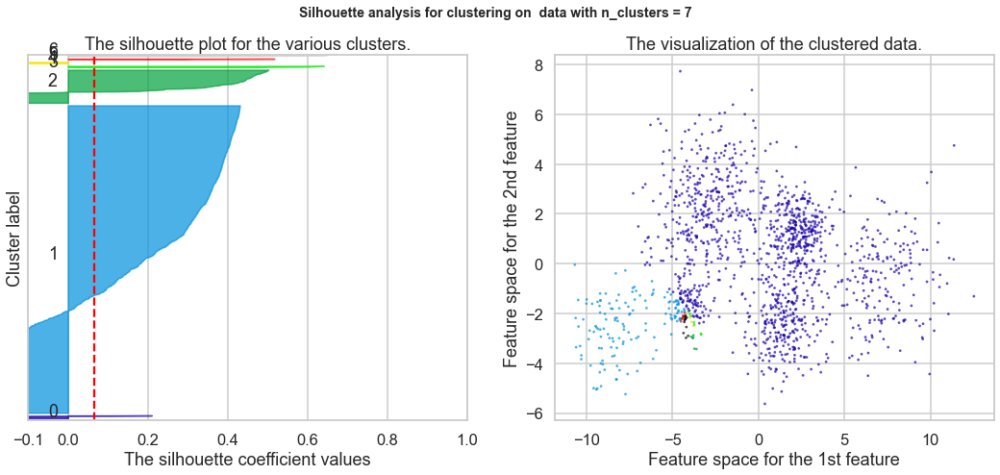

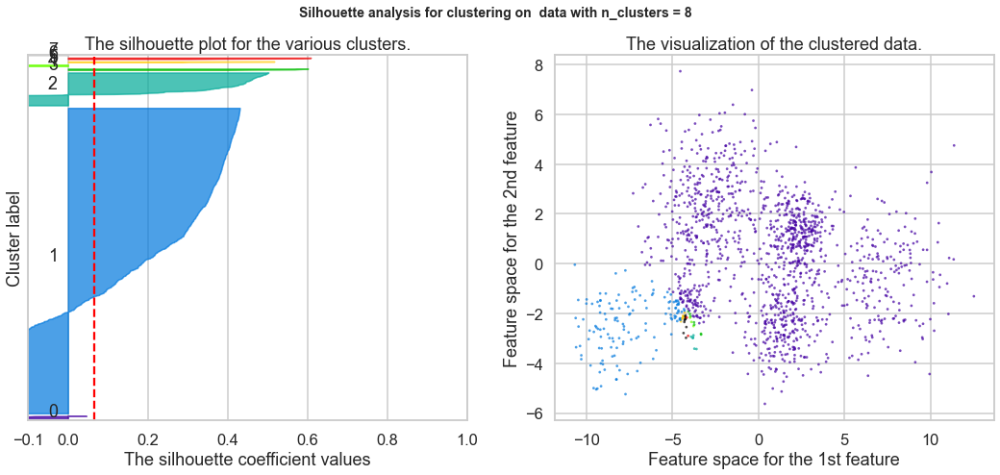

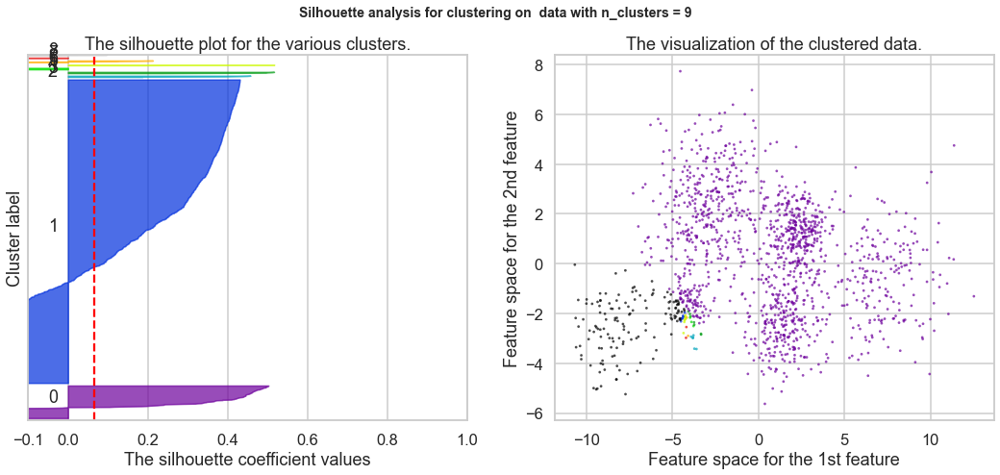

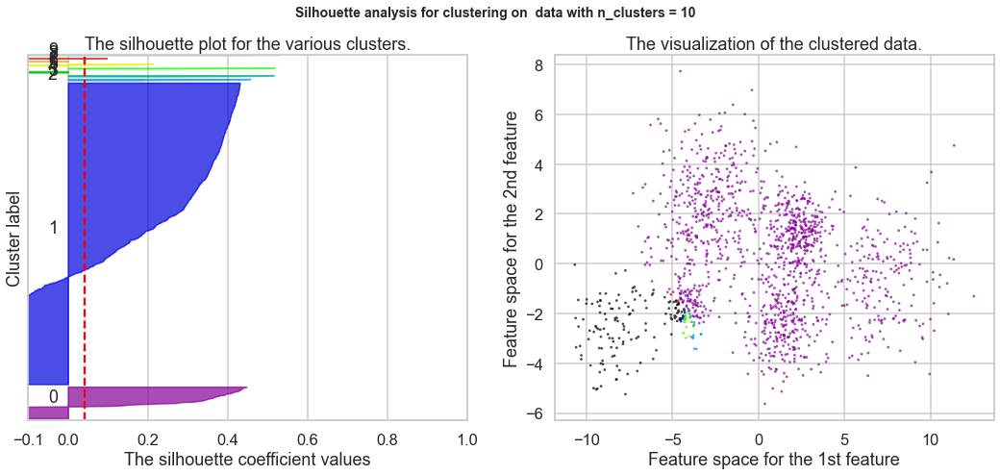

In [16]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='single')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Manhattan & Average
(Based on Silhouette Score best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.46762361386512785
For n_clusters = 3 The average silhouette_score is : 0.40908233229322877
For n_clusters = 4 The average silhouette_score is : 0.38321869346484616
For n_clusters = 5 The average silhouette_score is : 0.39540970031359807
For n_clusters = 6 The average silhouette_score is : 0.38029768112070367
For n_clusters = 7 The average silhouette_score is : 0.3944434066620488
For n_clusters = 8 The average silhouette_score is : 0.41576362151004215
For n_clusters = 9 The average silhouette_score is : 0.399558543983381
For n_clusters = 10 The average silhouette_score is : 0.38684142725563375


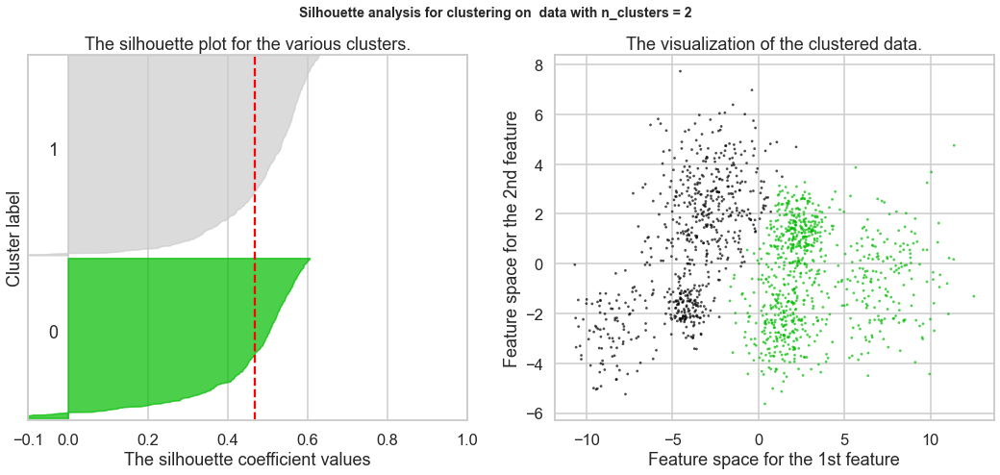

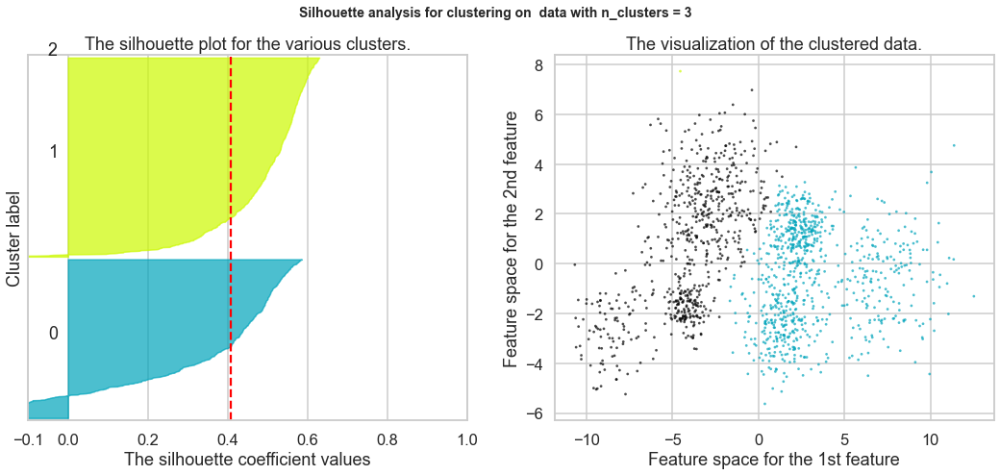

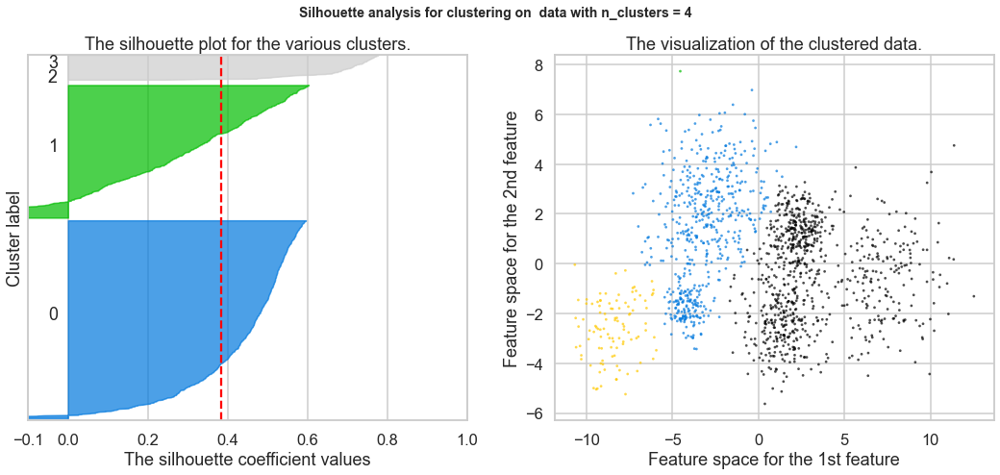

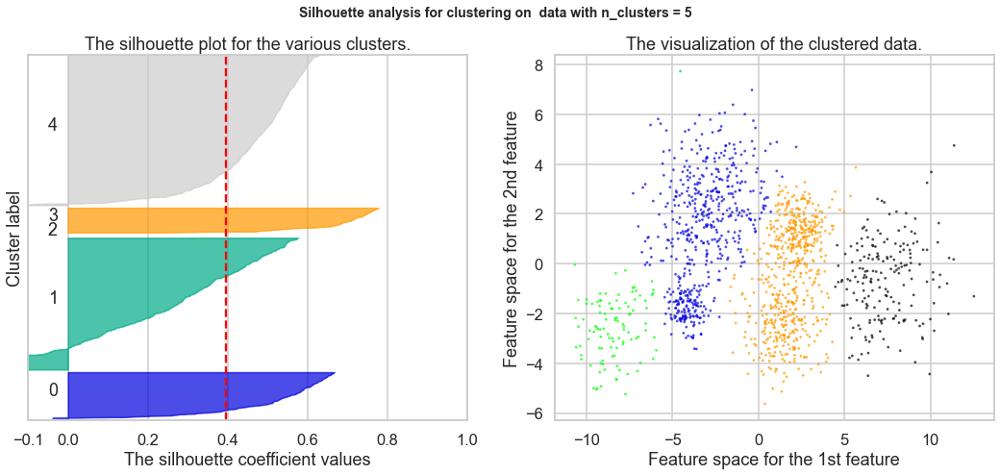

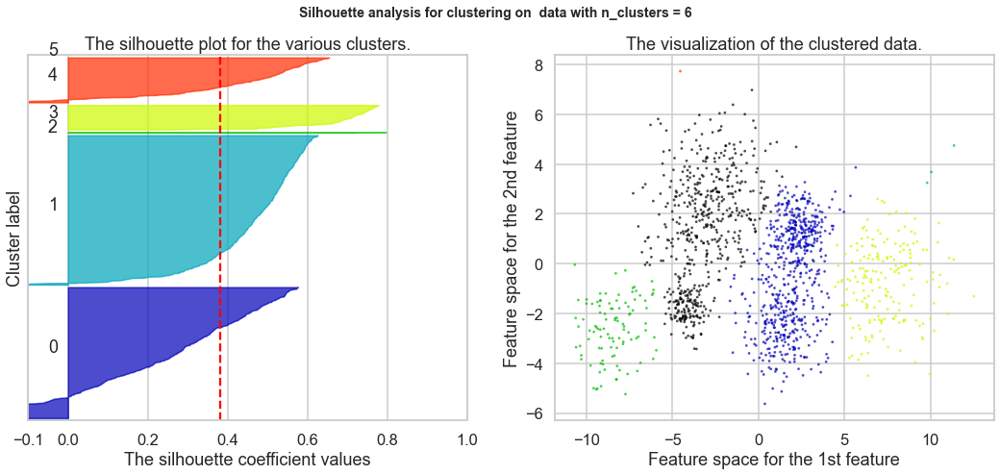

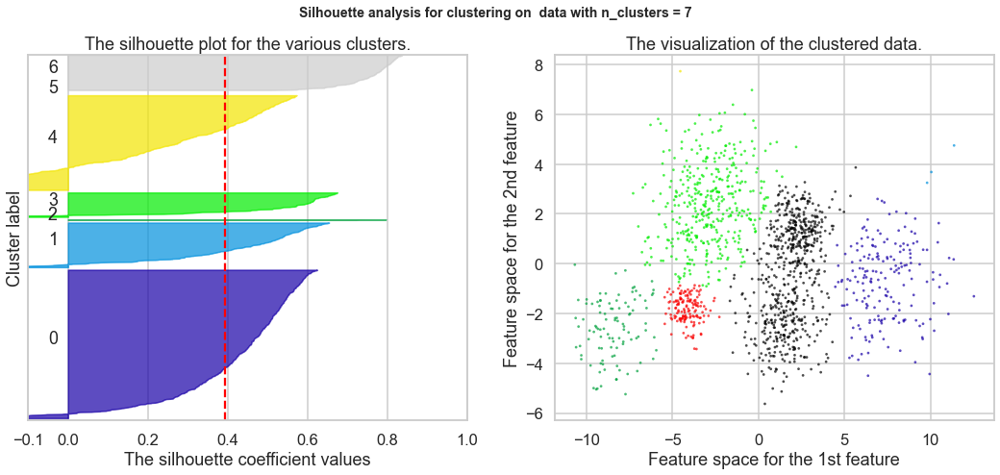

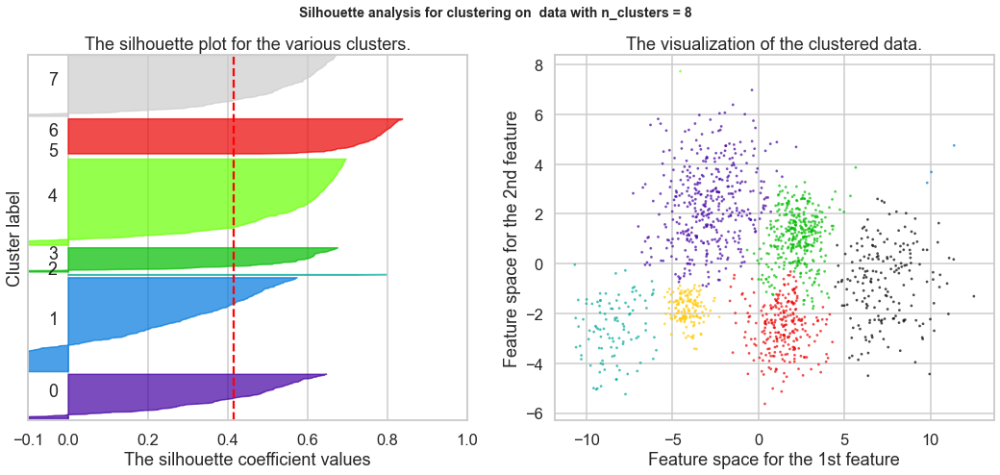

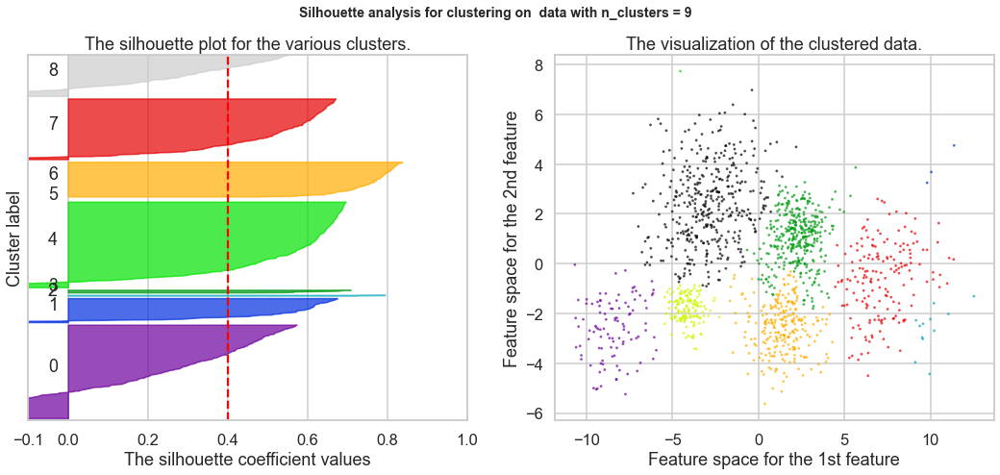

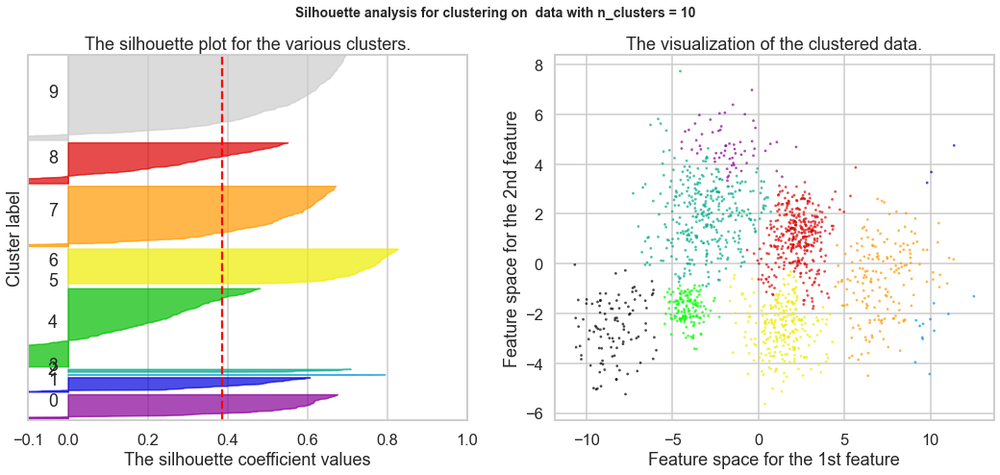

In [14]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='average')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Manhattan & Single
(Based on Silhouette Score best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.3218066204847175
For n_clusters = 3 The average silhouette_score is : 0.23622772250901033
For n_clusters = 4 The average silhouette_score is : 0.14871638406533946
For n_clusters = 5 The average silhouette_score is : 0.12029307224096318
For n_clusters = 6 The average silhouette_score is : 0.08705564851389591
For n_clusters = 7 The average silhouette_score is : -0.13183149076879896
For n_clusters = 8 The average silhouette_score is : -0.144702446818925
For n_clusters = 9 The average silhouette_score is : -0.14944154607335855
For n_clusters = 10 The average silhouette_score is : -0.35201882557759656


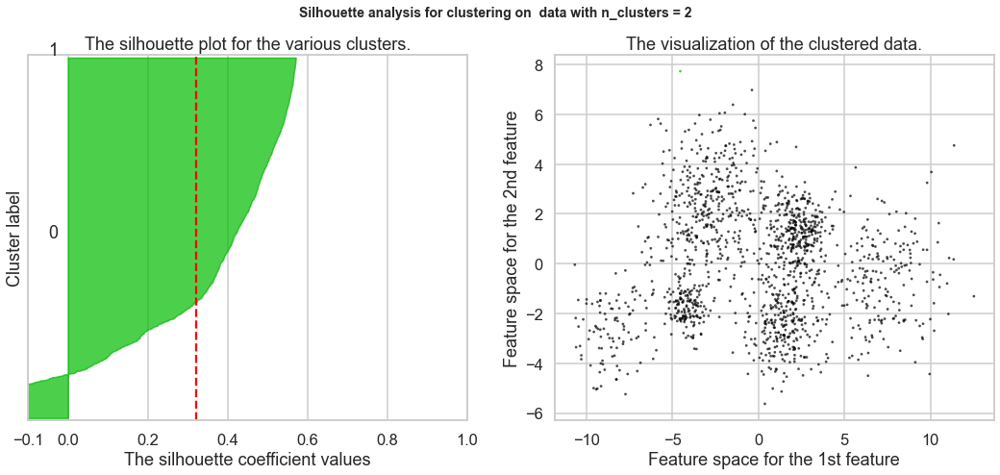

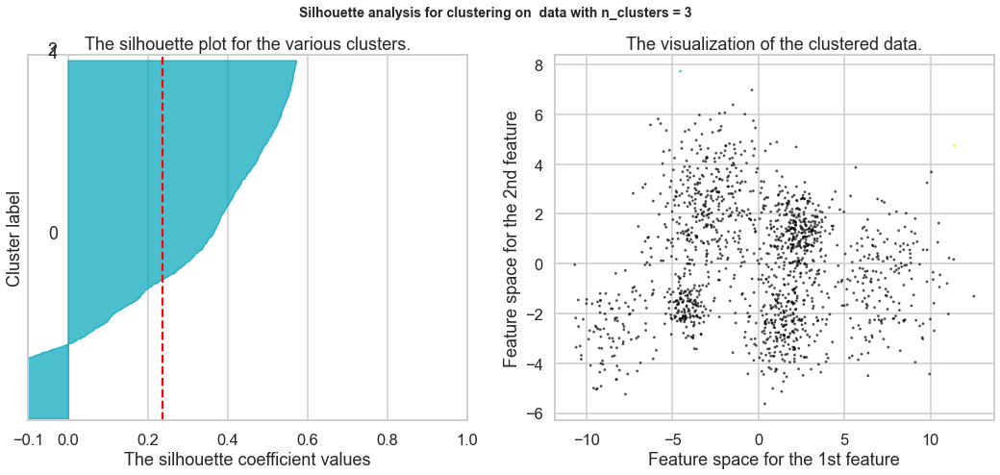

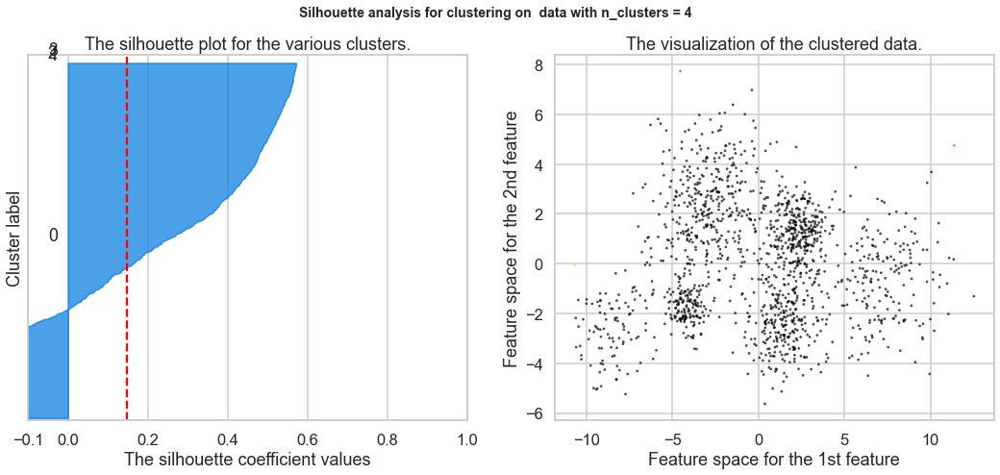

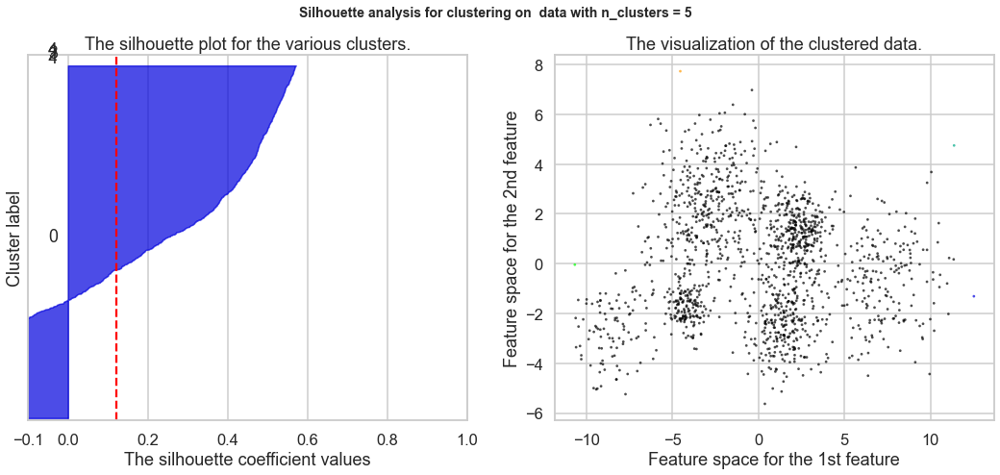

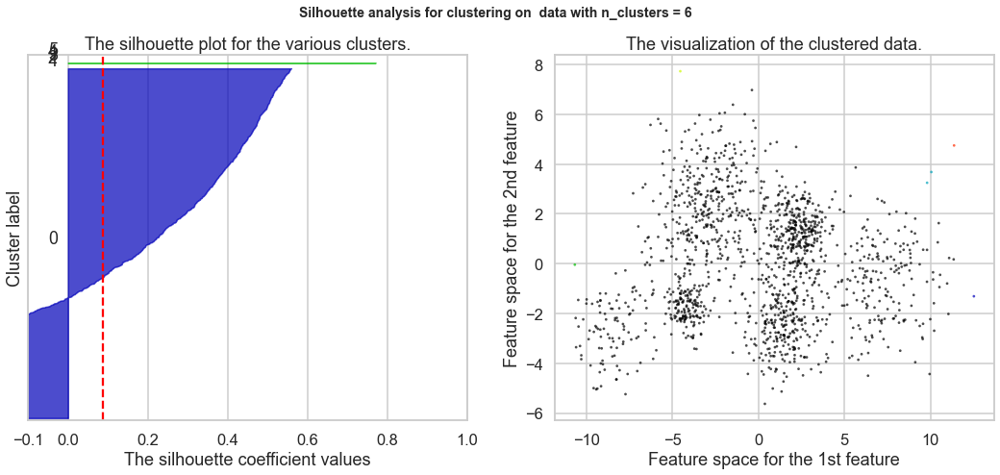

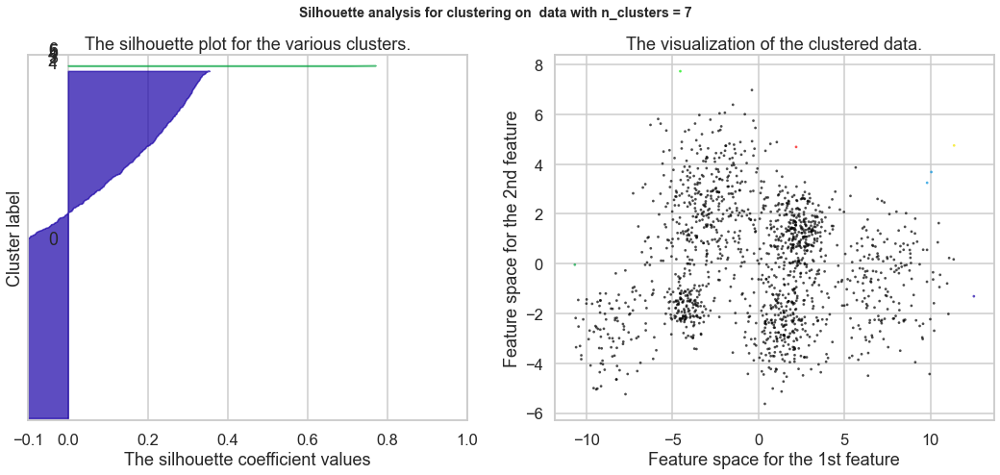

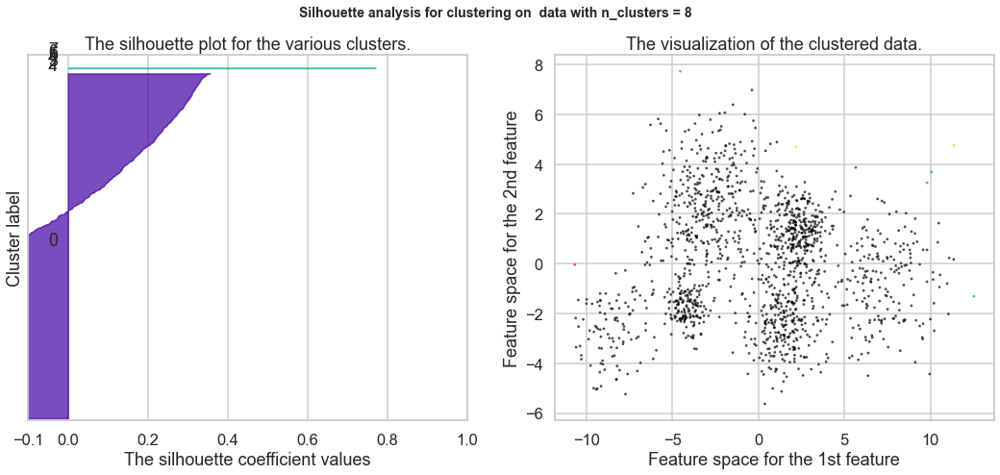

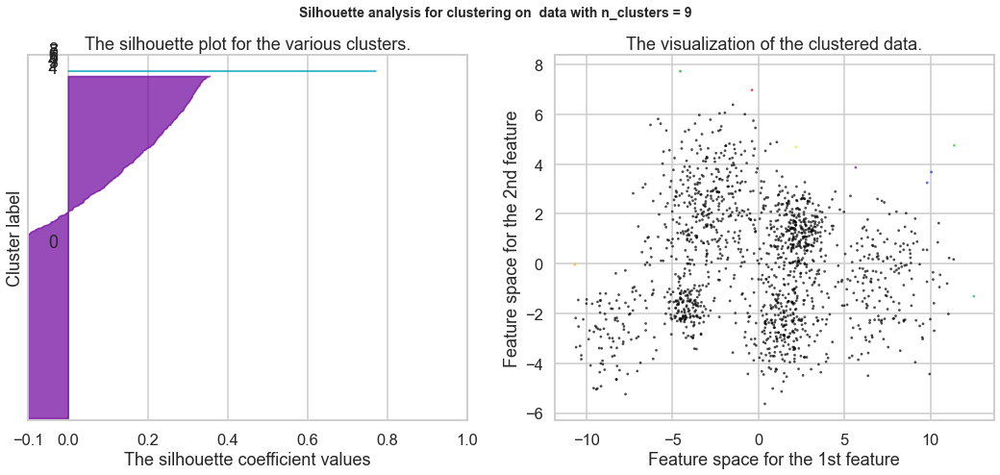

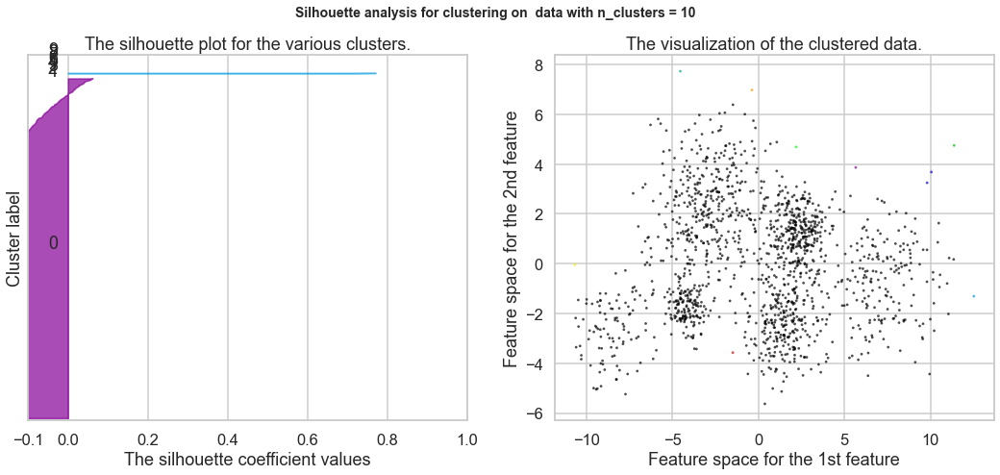

In [15]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='single')
    cluster_labels = clusterer.fit_predict(Multi_blob_Data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Multi_blob_Data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Another Way

In [350]:
def hierachy_plot(df, numk):
    distortions = []
    for k in range(2,numk):
        hac = AgglomerativeClustering(n_clusters=k).fit(df)
        df_l = hac.labels_
        distortions.append(silhouette_score(df, df_l))

    print(distortions)
    K = range(2, numk)    
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title('The Hierachy Method using silhouette_score')
    plt.show()

[0.4269480002112768, 0.40881905999201956, 0.4264522867538804, 0.46941860470586316, 0.4652613157528439, 0.4548664117944667, 0.4448300068150569, 0.3955359364369385, 0.39408604266622566, 0.33917339611478714, 0.3320826528764155, 0.33359511221490185, 0.3289887941851813]


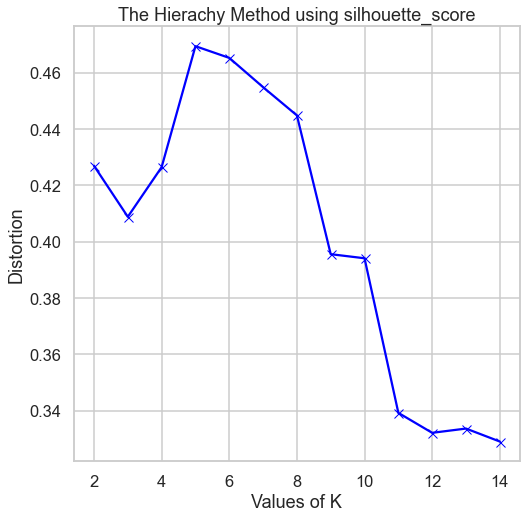

In [351]:
df_scale=StandardScaler().fit_transform(Multi_blob_Data)
hierachy_plot(df_scale, 15)

In [367]:
hac = AgglomerativeClustering(n_clusters= 2).fit(df_scale)
df_scale_l = hac.labels_
db_clustered_l=hac.labels_
print('/*---------------- Grap Hierarchical----------------*/')
db_clustered = df_scale[(df_scale_l >= 0)]
print(silhouette_score(db_clustered, db_clustered_l))
print('/*---------------- overall Hierarchical----------------*/')
silhouette_score(df_scale, df_scale_l)

/*---------------- Grap Hierarchical----------------*/
0.4269480002112768
/*---------------- overall Hierarchical----------------*/


0.4269480002112768

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

In [18]:

## Finding best values of eps and min_samples
import numpy as np
import pandas as pd
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
 
# Defining the list of hyperparameters to try
eps_list=np.arange(start=0.1, stop=3, step=0.1)
min_sample_list=np.arange(start=5, stop=25, step=1)
 
# Creating empty data frame to store the silhouette scores for each trials
silhouette_scores_data=pd.DataFrame()
 
for eps_trial in eps_list:
    for min_sample_trial in min_sample_list:
        
        # Generating DBSAN clusters
        db = DBSCAN(eps=eps_trial, min_samples=min_sample_trial)
        
        if(len(np.unique(db.fit_predict(Multi_blob_Data)))>1):
            sil_score=silhouette_score(Multi_blob_Data, db.fit_predict(Multi_blob_Data))
        else:
            continue
        trial_parameters="eps:" + str(eps_trial.round(1)) +" min_sample :" + str(min_sample_trial)
        
        silhouette_scores_data=silhouette_scores_data.append(pd.DataFrame(data=[[sil_score,trial_parameters]], columns=["score", "parameters"]))
 
# Finding out the best hyperparameters with highest Score
silhouette_scores_data.sort_values(by='score', ascending=False).head(1)


,score,parameters
0,0.468521,eps:2.9 min_sample :24


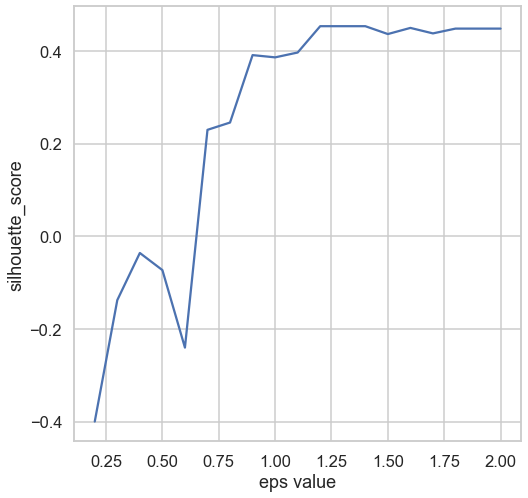

In [196]:
from sklearn.metrics import silhouette_score

# list of eps values
# eps_range=[0.1,0.25,0.5,0.75,0.8,0.9,1,1.25,1.5,1.75,1.8,1.9,2,2.25,2.5]
eps_range = [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8,1.9,2]
#               1.9,2,2.1,2.2,2.3,2.4]
# 2.5,2.6,2.7,2.8,2.9,]

# list to store silhouette_score values
silhouette_scores =[]

# loop over different eps values
for eps in eps_range:
    # perform clustering using DBSCAN
    db = DBSCAN(eps=eps)
    if(len(np.unique(db.fit_predict(Multi_blob_Data)))>1):
        sil_score=silhouette_score(Multi_blob_Data, db.fit_predict(Multi_blob_Data))
    else:
        continue
#     clustering_model.fit(Multi_blob_Data)
    # calculate silhouette_score
    silhouette_score_value = silhouette_score(Multi_blob_Data, db.labels_)
    # store silhouette_score in list
    silhouette_scores.append(silhouette_score_value)

# plot silhouette_score versus eps

plt.plot(eps_range, silhouette_scores)
plt.xlabel('eps value')
plt.ylabel('silhouette_score')
plt.show()

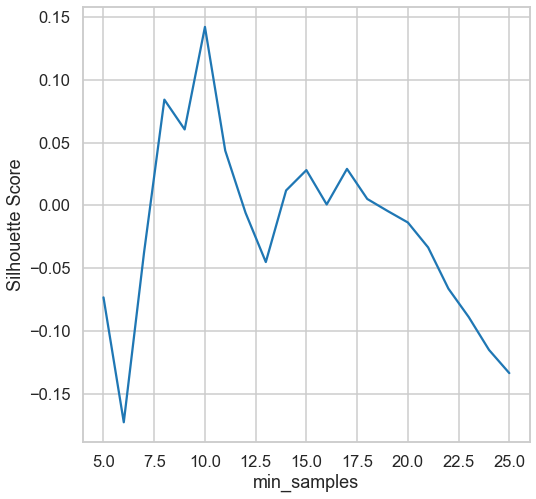

In [81]:
min_samples_values = [5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25]

scores = []

for min_samples in min_samples_values:
    dbscan = DBSCAN(min_samples=min_samples)
    dbscan.fit(Multi_blob_Data)
    labels = dbscan.labels_
    scores.append(silhouette_score(Multi_blob_Data, labels))

plt.plot(min_samples_values, scores)
plt.xlabel('min_samples')
plt.ylabel('Silhouette Score')
plt.show()

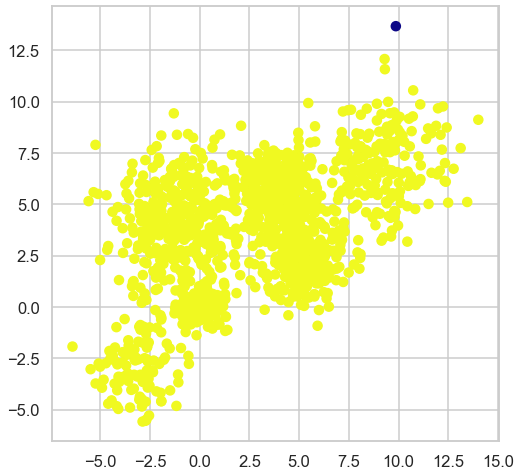

{0, -1}
Estimated no. of clusters: 2
Estimated no. of noise points: 1


In [226]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps = 2.9, min_samples = 24).fit(Multi_blob_Data) # fitting the model
labels = dbscan.labels_ # getting the labels
core_samples_mask=np.zeros_like(dbscan.labels_,dtype=bool)
core_samples_mask[dbscan.core_sample_indices_]=True
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:,1], c = labels, cmap= "plasma") # plotting the clusters
plt.show() # showing the plot
no_clusters = len(set(labels))
no_noise = list(labels).count(-1)
print(set(labels))
print('Estimated no. of clusters: %d' % no_clusters)
print('Estimated no. of noise points: %d' % no_noise)

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

In [121]:
import numpy as np
from sklearn.datasets.samples_generator import make_blobs
from sklearn.mixture import GaussianMixture
from matplotlib import pyplot as plt
import seaborn as sns
sns.set()

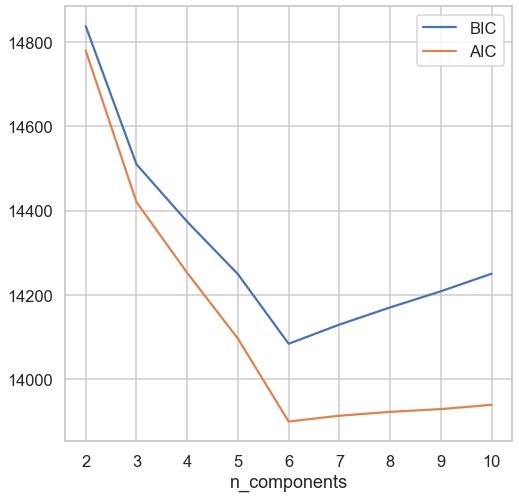

In [126]:
#The optimal number of clusters (K) is the value that minimizes the Akaike information criterion (AIC) or the Bayesian information criterion (BIC).
n_components = np.arange(2, 11)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(Multi_blob_Data) for n in n_components]
plt.plot(n_components, [m.bic(Multi_blob_Data) for m in models], label='BIC')
plt.plot(n_components, [m.aic(Multi_blob_Data) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('K');

In [127]:
gmm = GaussianMixture(n_components=6)
gmm.fit(Multi_blob_Data)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=6, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

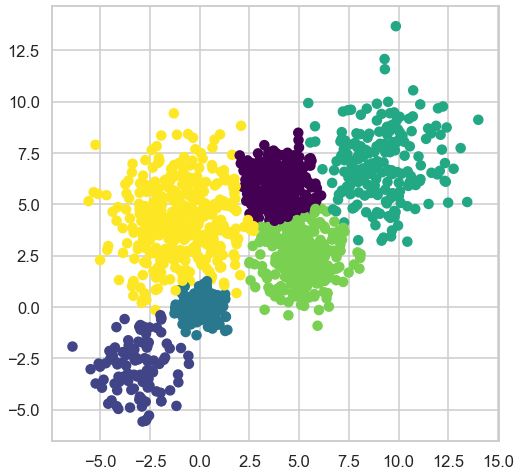

In [128]:
labels = gmm.predict(Multi_blob_Data)
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, cmap='viridis');

In [28]:
from matplotlib.patches import Ellipse

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))

In [29]:
def plot_gmm(gmm, X, label=True, ax=None):
    ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)
    if label:
        ax.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis', zorder=2)
    else:
        ax.scatter(X[:, 0], X[:, 1], s=40, zorder=2)
    ax.axis('equal')
    
    w_factor = 0.2 / gmm.weights_.max()
    for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
        draw_ellipse(pos, covar, alpha=w * w_factor)


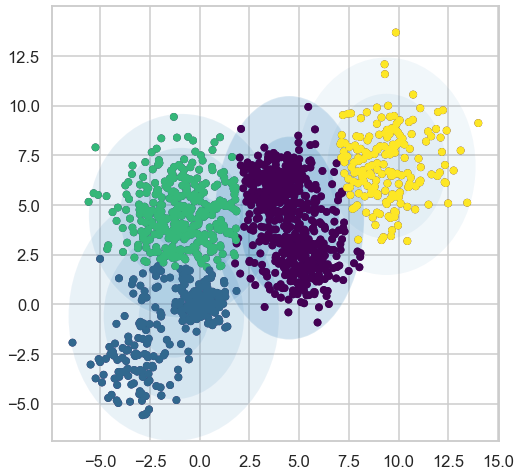

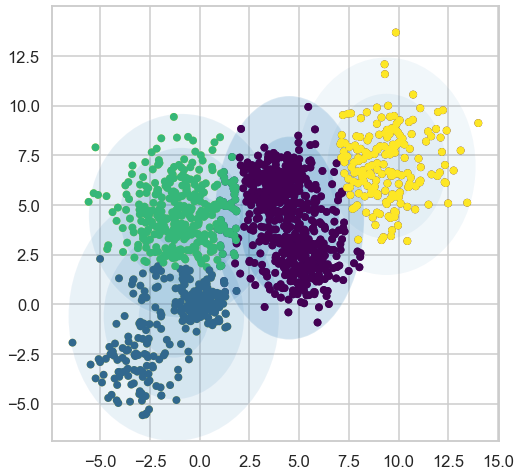

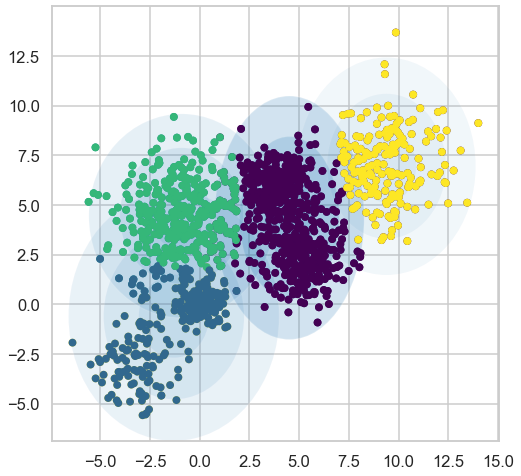

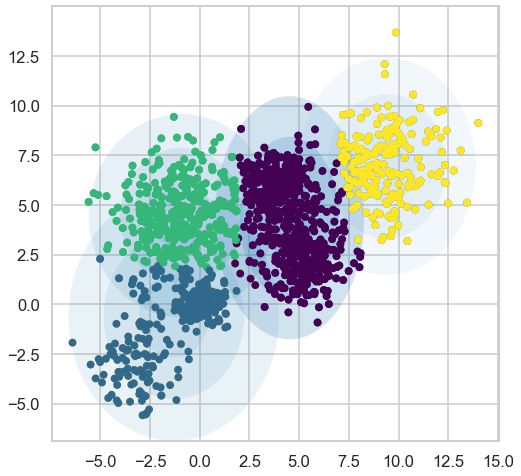

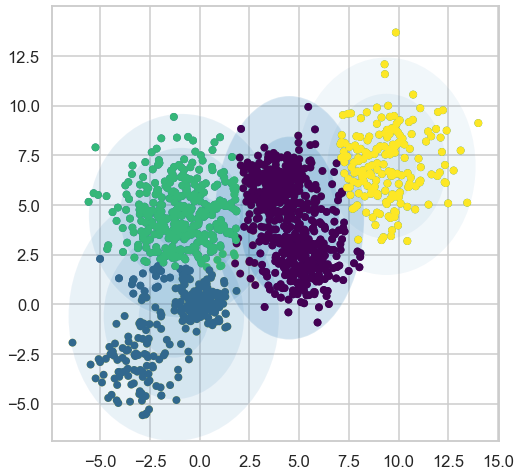

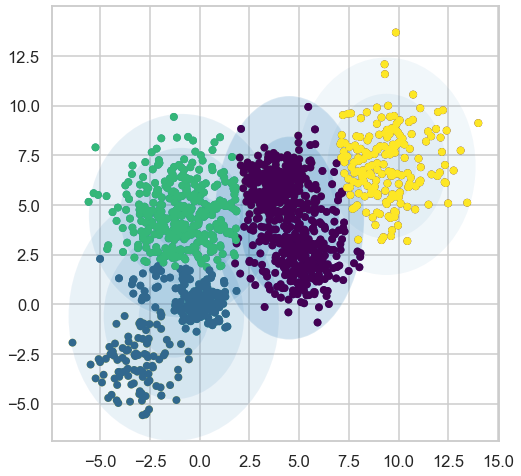

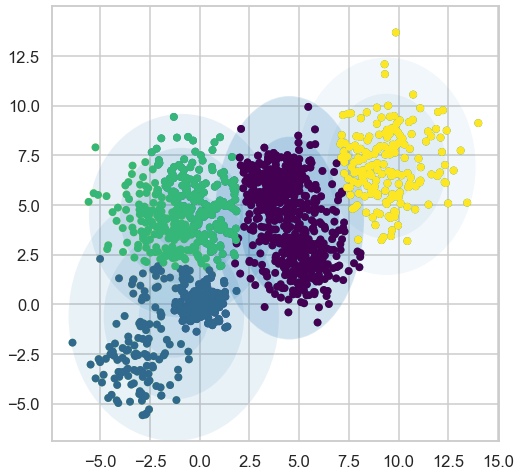

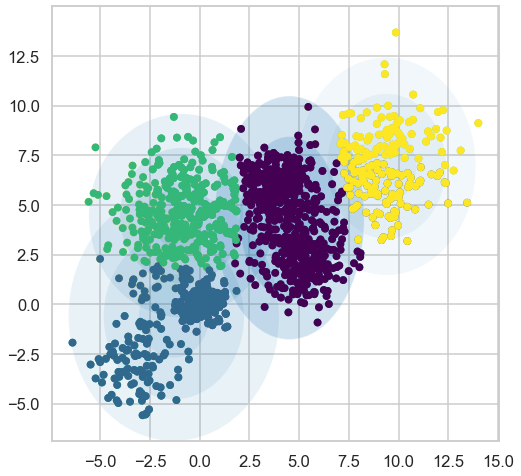

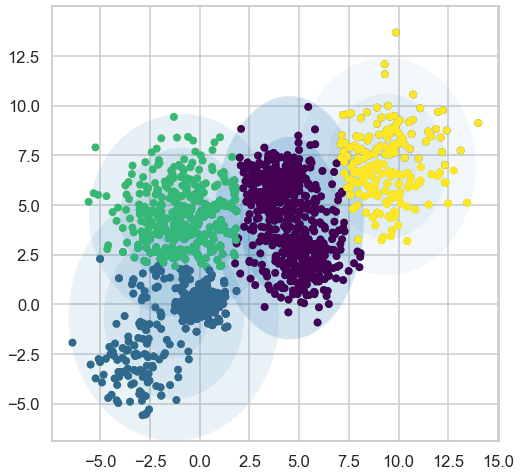

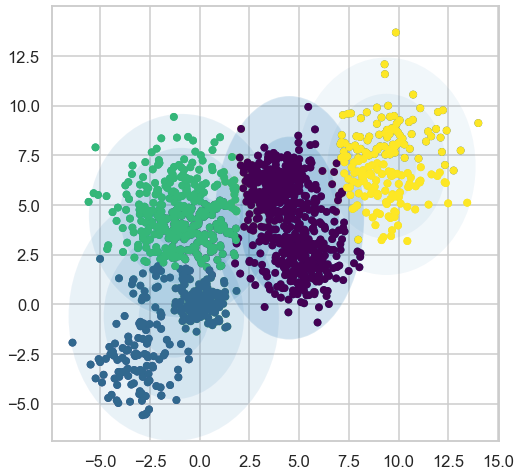

In [87]:
from sklearn import mixture
# X_stretched = np.dot(Multi_blob_Data, np.random.randn(2, 2))

for k in range (1,11):
    gmm = mixture.GaussianMixture(n_components=k).fit(Multi_blob_Data)
    labels = gmm.predict(Multi_blob_Data)
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, s=40, cmap='viridis');
    gmm = mixture.GaussianMixture(n_components=4, covariance_type='diag', random_state=42)
    plot_gmm(gmm, Multi_blob_Data)
    plt.show()

In [35]:
df_scale=StandardScaler().fit_transform(Multi_blob_Data)
def GaussianMixture_plot(df, numk):
    distortions = []
    for k in range(2,numk):
        gm = GaussianMixture(k)
        gm.fit(df)
        df_l = gm.predict(df)
        distortions.append(silhouette_score(df, df_l))
    K = range(2, numk)    
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title('The GaussianMixture using silhouette_score')
    plt.show()

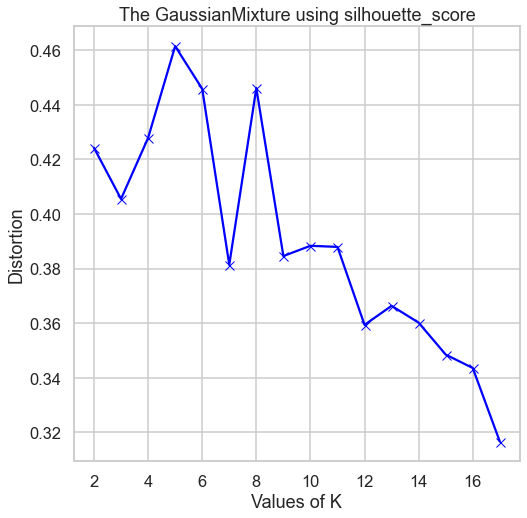

In [36]:
GaussianMixture_plot(df_scale, 18)

In [374]:
gm = GaussianMixture(2).fit(df_scale)
df_scale_ = gm.predict(df_scale)
db_clustered_l=gm.predict(df_scale)
print('/*----------------GaussianMixture----------------*/')
db_clustered = df_scale[(df_scale_l >= 0)]
print(silhouette_score(db_clustered, db_clustered_l))

print('/*---------------- Overall GaussianMixture----------------*/')
print(silhouette_score(df_scale, df_scale_l))

/*----------------GaussianMixture----------------*/
0.4242360845381711
/*---------------- Overall GaussianMixture----------------*/
0.4269480002112768


## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


# Kmeans

In [40]:
from sklearn.datasets import load_iris
from sklearn import datasets
iris= datasets.load_iris()
# iris.target[[10, 25, 50]]
# #array([0, 0, 1])
# list(iris.target_names)
# ['setosa', 'versicolor', 'virginica']
# # df=pd.DataFrame(iris_data.data)
# x=np.array(iris.data)
# y=np.array(iris.target[[10, 25, 50]])
df = pd.DataFrame(iris.data, columns = iris.feature_names)
df['target'] = iris.target
X = iris.data
df.sample(4)


,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
119,6.0,2.2,5.0,1.5,2
135,7.7,3.0,6.1,2.3,2
132,6.4,2.8,5.6,2.2,2
121,5.6,2.8,4.9,2.0,2


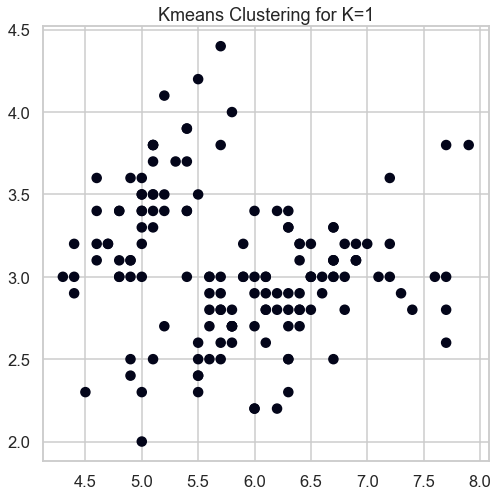

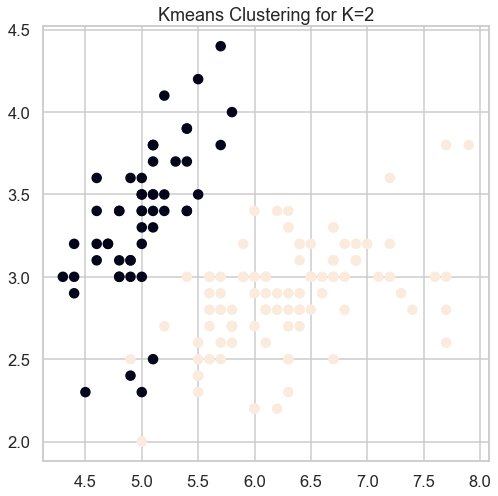

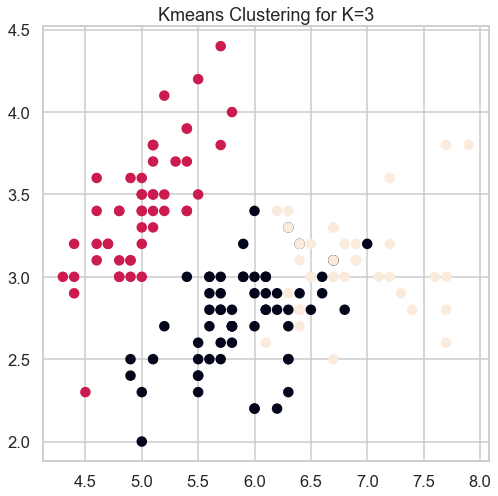

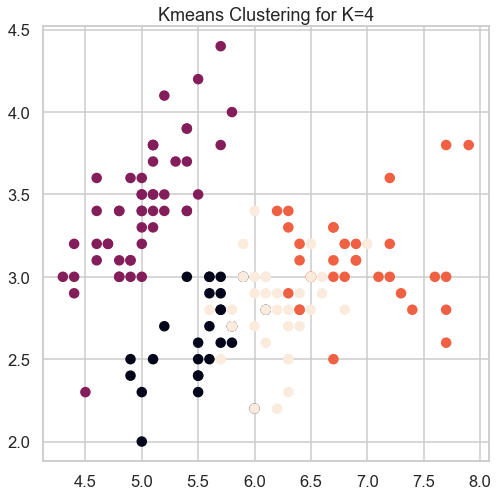

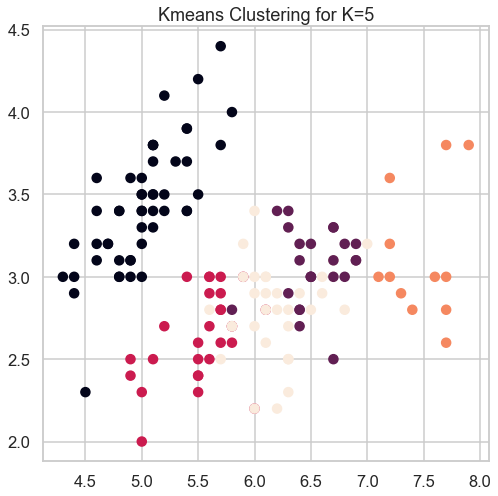

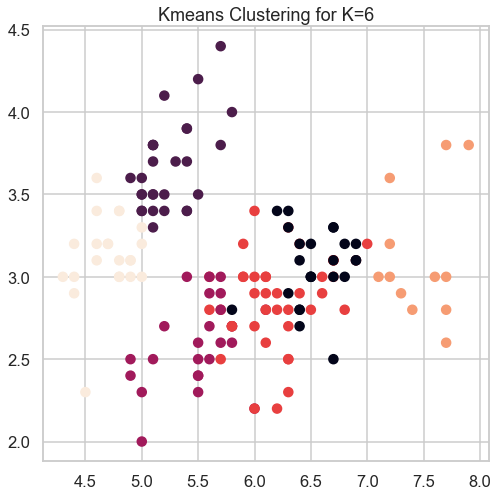

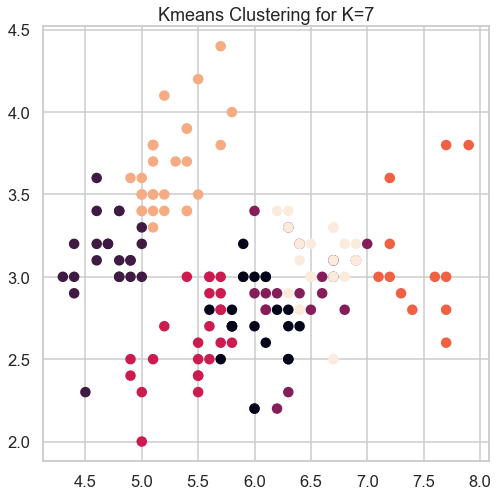

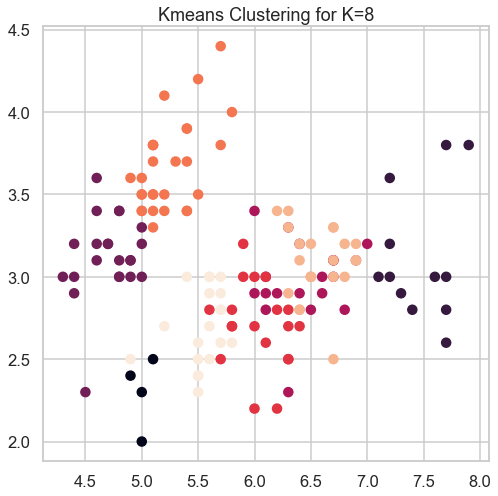

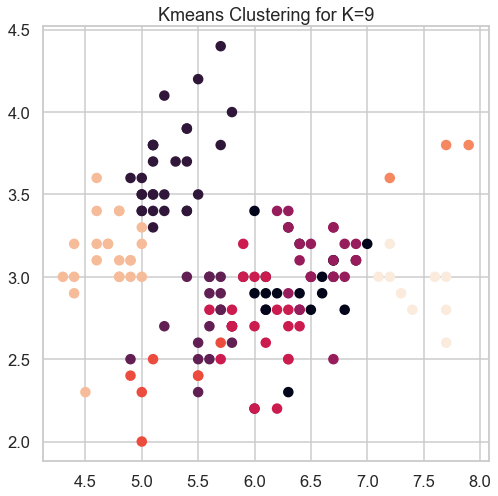

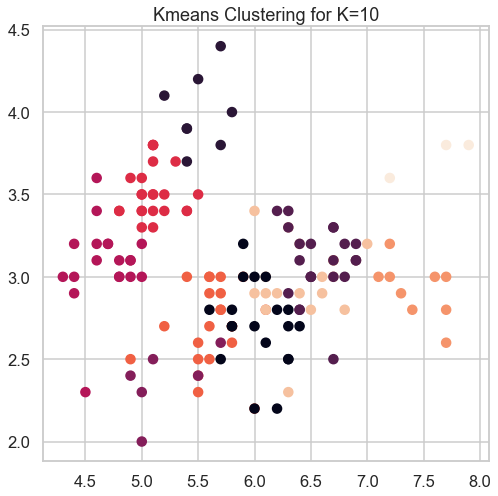

In [42]:

cs = []
for k in range (1,11):
    kmeans = KMeans(n_clusters = k, init = 'k-means++', max_iter = 30, n_init = 10, random_state = 0)
    kmeans.fit(X)
    cs.append(kmeans.inertia_)
    plt.scatter(X[:,0], X[:,1], c=kmeans.labels_)
    plt.title("Kmeans Clustering for K="+str(k))
    plt.show()

Elbow Method

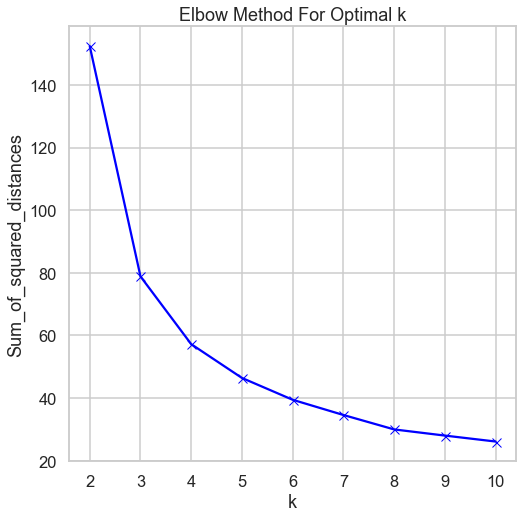

4

In [43]:
inertia = []
K = range(2,11)
distortions=[]
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(X)
    inertia.append(km.inertia_)
    distortions.append(sum(np.min(scipy.spatial.distance.cdist(X,
    km.cluster_centers_, 'euclidean'),axis=1)) /
    df.shape[0])
plt.plot(K, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()
kl = KneeLocator(range(2, 11), inertia, curve="convex", direction="decreasing")
kl.elbow

Silhouette Score

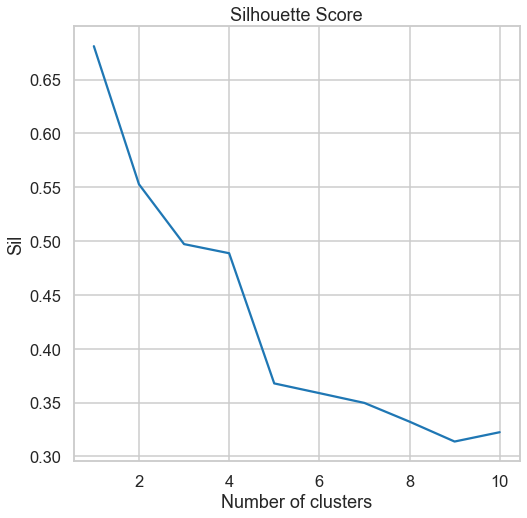

In [44]:
sil = []
kmax = 11

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, kmax+1):
  kmeans = KMeans(n_clusters = k).fit(X)
  labels = kmeans.labels_
  sil.append(silhouette_score(X, labels, metric = 'euclidean'))
plt.plot(range(1, 11), sil)
plt.title('Silhouette Score')
plt.xlabel('Number of clusters')
plt.ylabel('Sil')
plt.show()

# Hierarchal Clustering

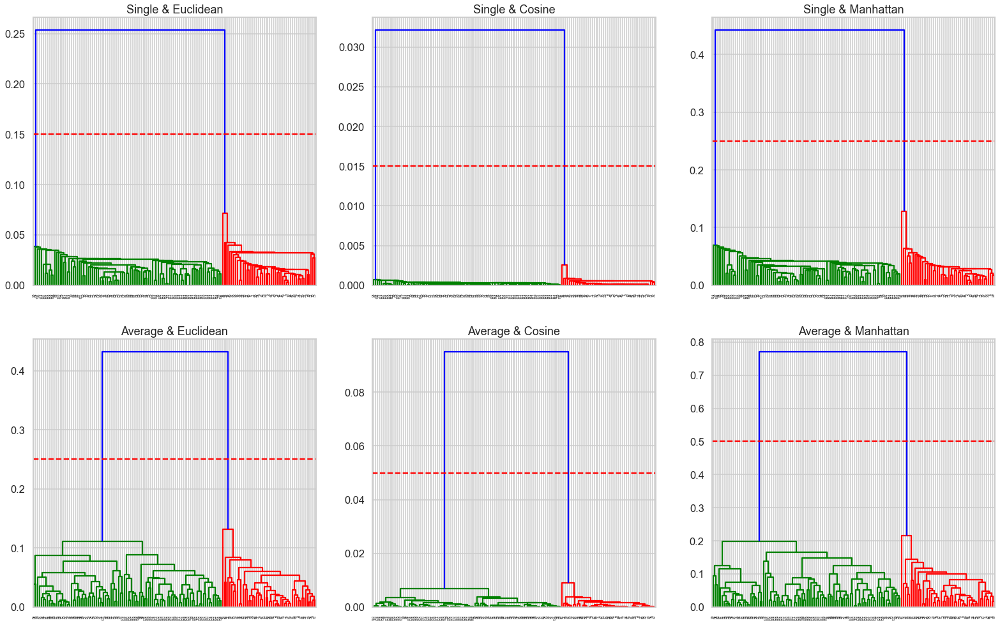

In [56]:
from sklearn.preprocessing import normalize
X1_1 = normalize(X)
Z1_1 = shc.linkage(X1_1, method='single', metric='euclidean')
Z2_1 = shc.linkage(X1_1, method='single', metric='cosine')
Z3_1 = shc.linkage(X1_1, method='single', metric='cityblock')
Z4_1 = shc.linkage(X1_1, method='average', metric='euclidean')
Z5_1 = shc.linkage(X1_1, method='average', metric='cosine')
Z6_1 = shc.linkage(X1_1, method='average', metric='cityblock')
plt.figure(figsize=(27, 17))
plt.subplot(2,3,1), dendrogram(Z1_1), plt.title('Single & Euclidean'),plt.axhline(y=0.15, color='r', linestyle='--')
plt.subplot(2,3,2), dendrogram(Z2_1), plt.title('Single & Cosine'),plt.axhline(y=0.015, color='r', linestyle='--')
plt.subplot(2,3,3), dendrogram(Z3_1), plt.title('Single & Manhattan'),plt.axhline(y=0.25, color='r', linestyle='--')
plt.subplot(2,3,4), dendrogram(Z4_1), plt.title('Average & Euclidean'),plt.axhline(y=0.25, color='r', linestyle='--')
plt.subplot(2,3,5), dendrogram(Z5_1), plt.title('Average & Cosine'),plt.axhline(y=0.05, color='r', linestyle='--')
plt.subplot(2,3,6), dendrogram(Z6_1), plt.title("Average & Manhattan"),plt.axhline(y=0.5, color='r', linestyle='--')
plt.show()

[4.22824171 0.24267075]


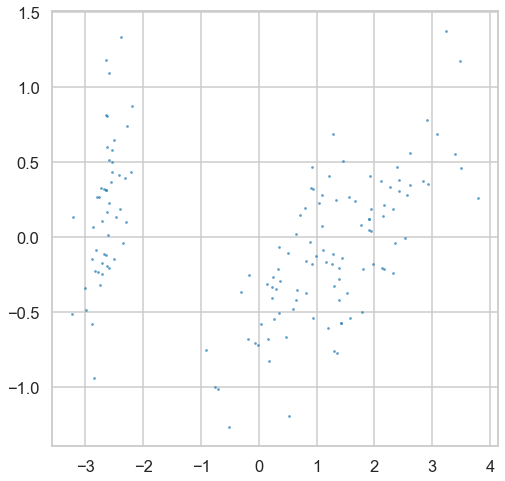

In [47]:
from sklearn.decomposition import PCA
#PCA with two principal components
PCA_2d = PCA(n_components=2).fit(X)
#PCA_2d.head()
print(PCA_2d.explained_variance_)
PCA_2d = PCA(n_components=2).fit_transform(X)
plt.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7, edgecolor='k')

Euclidean & Single
(Based on the Silhouette Score the best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.5121107753649307
For n_clusters = 4 The average silhouette_score is : 0.28193919132003853
For n_clusters = 5 The average silhouette_score is : 0.2838119645524374
For n_clusters = 6 The average silhouette_score is : 0.22144270332813407
For n_clusters = 7 The average silhouette_score is : 0.13276311217217873
For n_clusters = 8 The average silhouette_score is : 0.0587028514537829
For n_clusters = 9 The average silhouette_score is : 0.02243027834875979
For n_clusters = 10 The average silhouette_score is : 0.02514780977220397


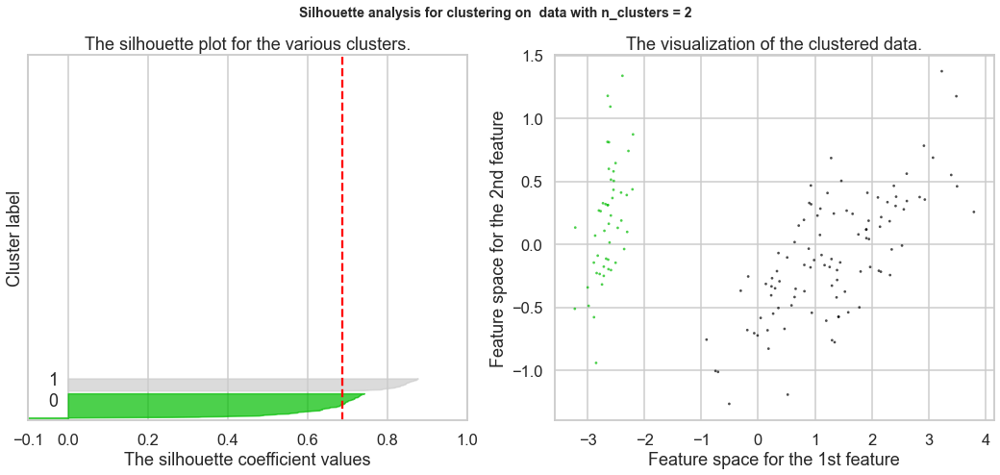

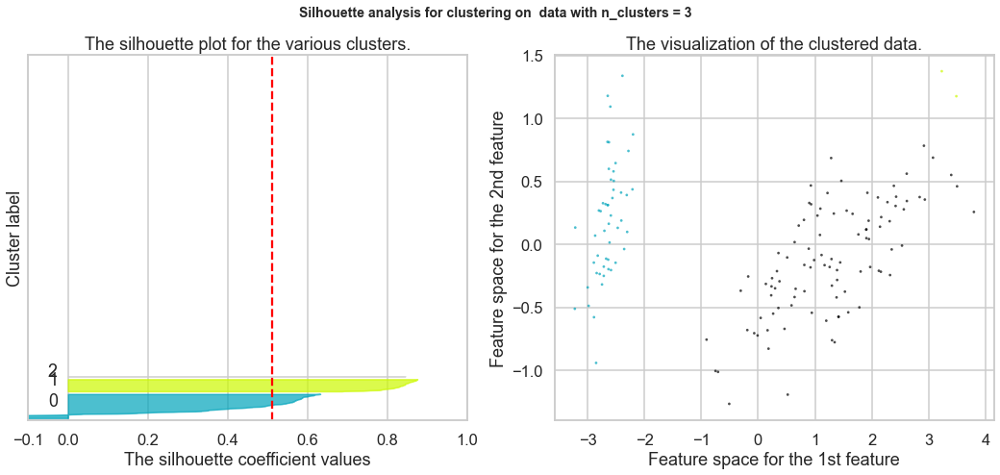

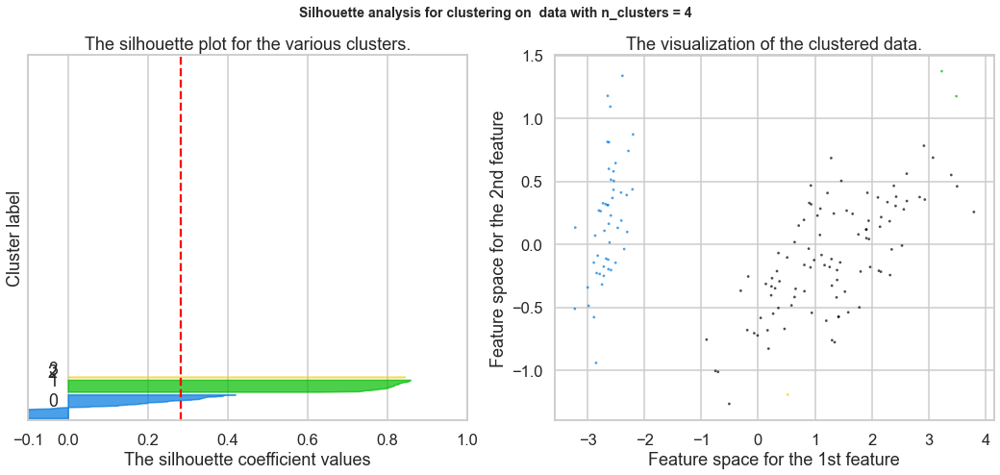

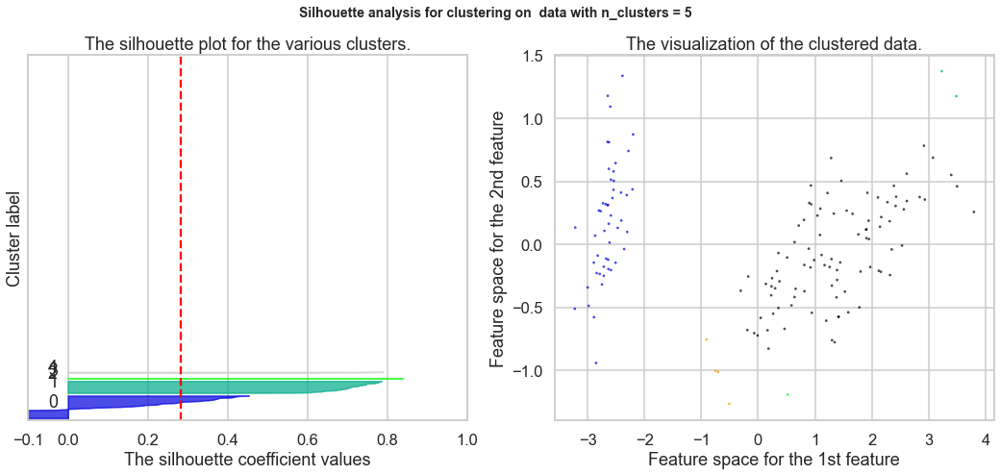

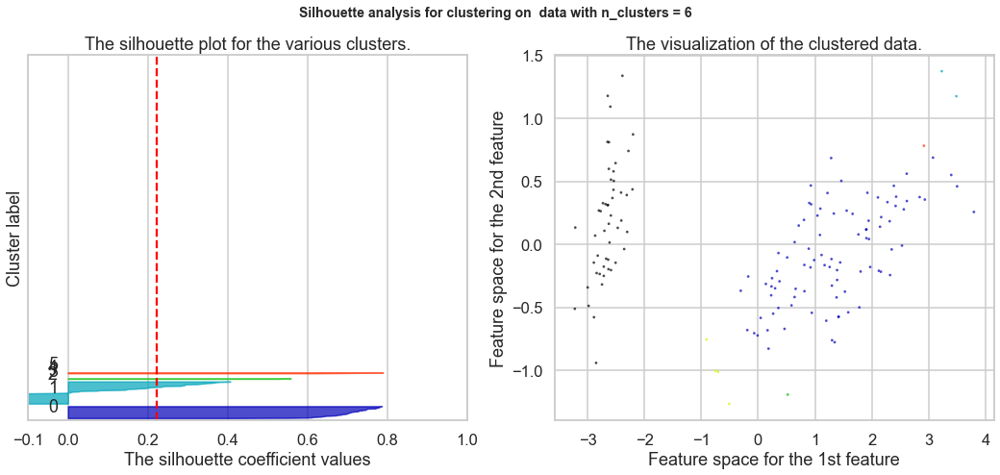

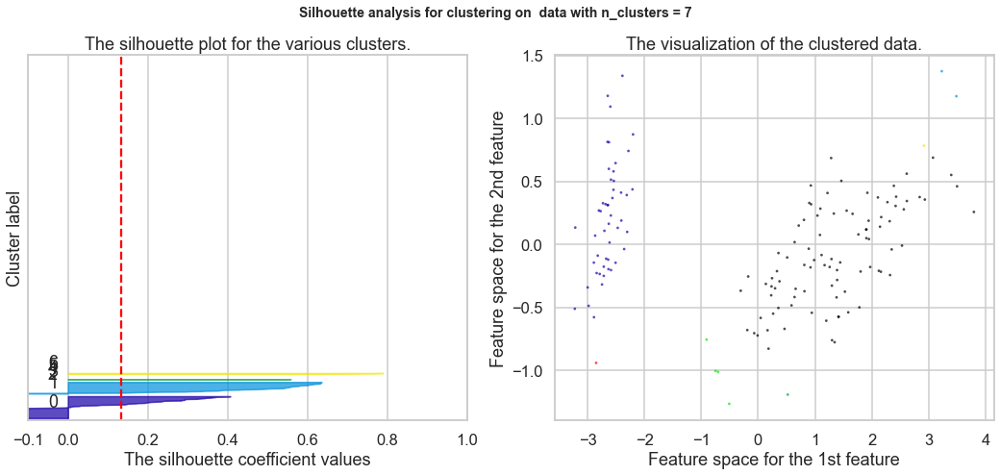

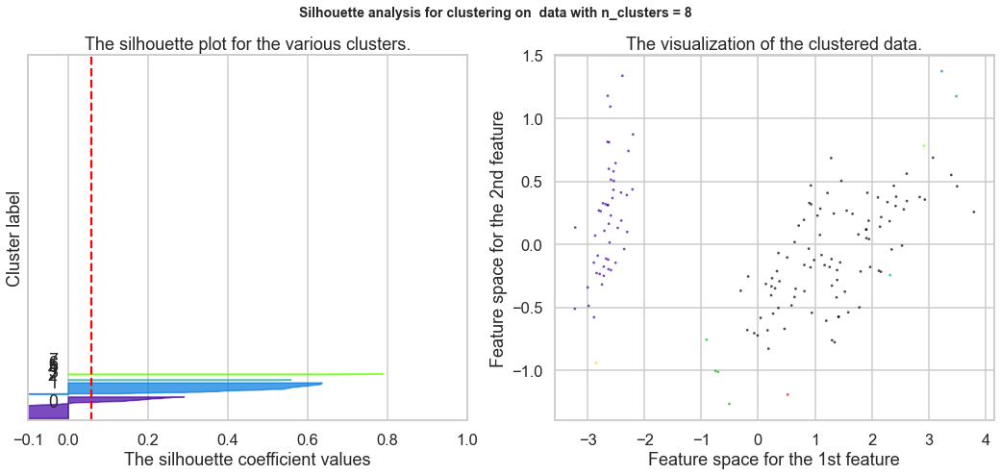

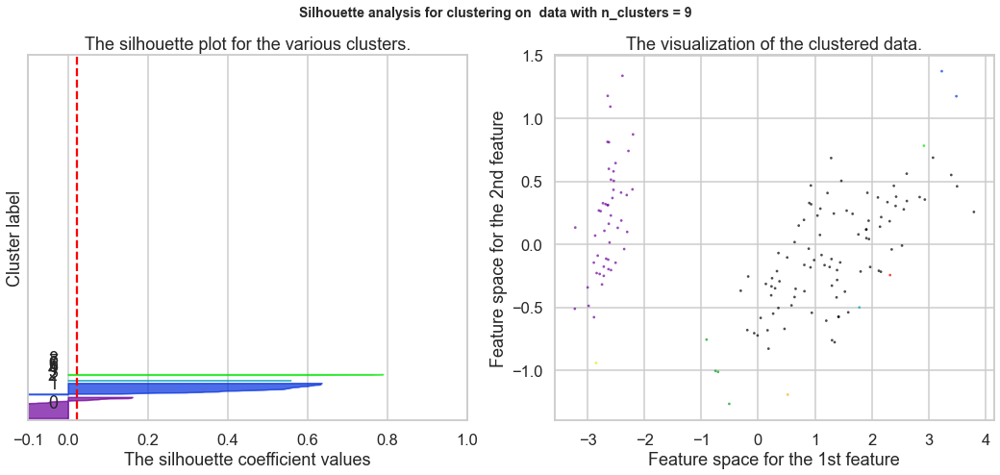

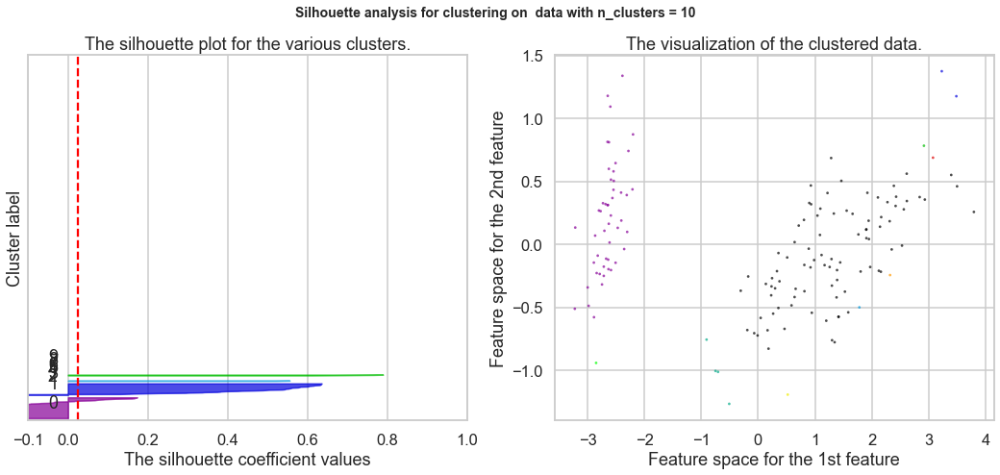

In [48]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='single')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Euclidean & Average
(Based on the Silhouette Score the best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.5541608580282851
For n_clusters = 4 The average silhouette_score is : 0.47199360849942534
For n_clusters = 5 The average silhouette_score is : 0.4306699739542554
For n_clusters = 6 The average silhouette_score is : 0.3419903827983001
For n_clusters = 7 The average silhouette_score is : 0.3707424079292073
For n_clusters = 8 The average silhouette_score is : 0.3658753388418651
For n_clusters = 9 The average silhouette_score is : 0.31668069036181595
For n_clusters = 10 The average silhouette_score is : 0.30828513418773884


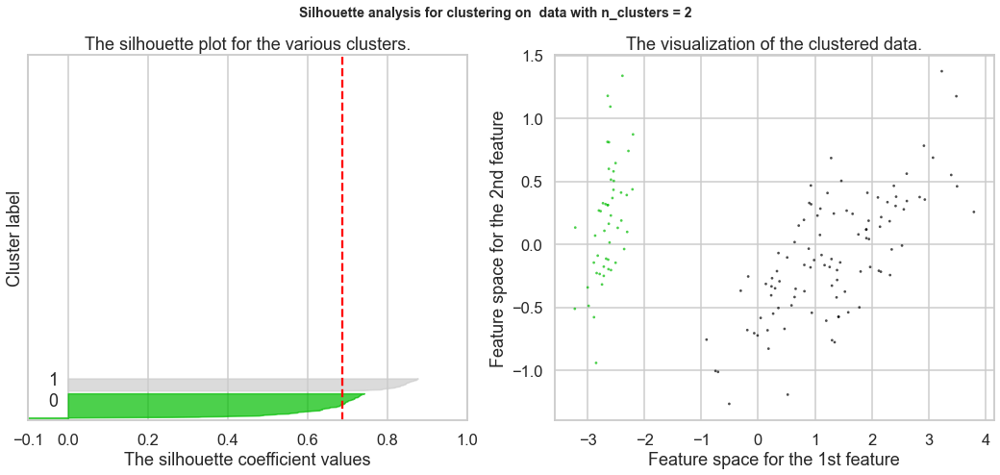

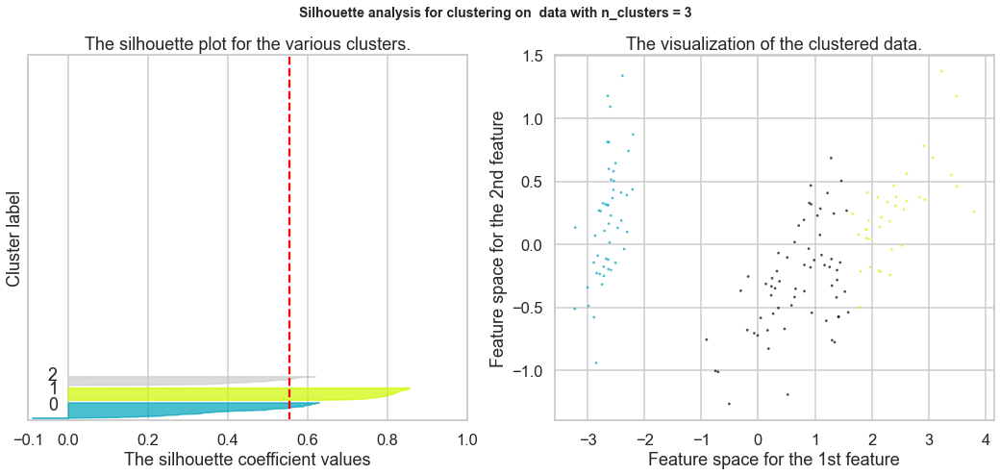

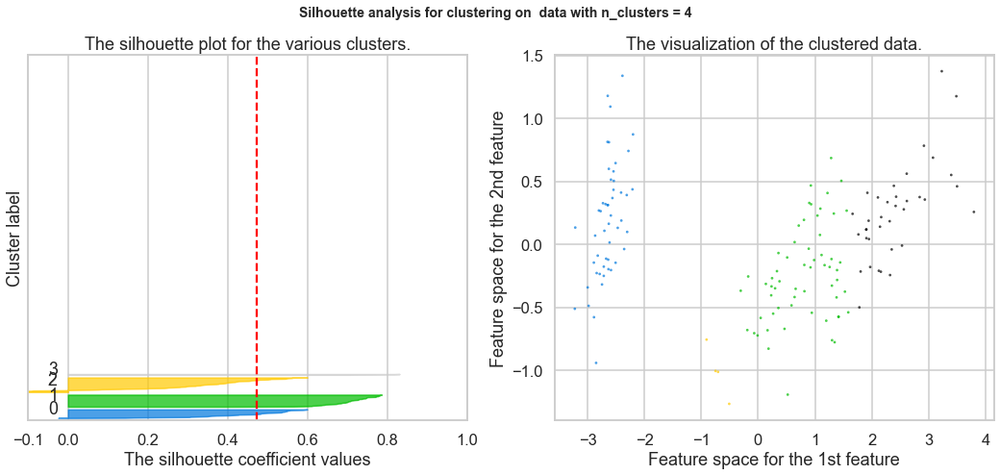

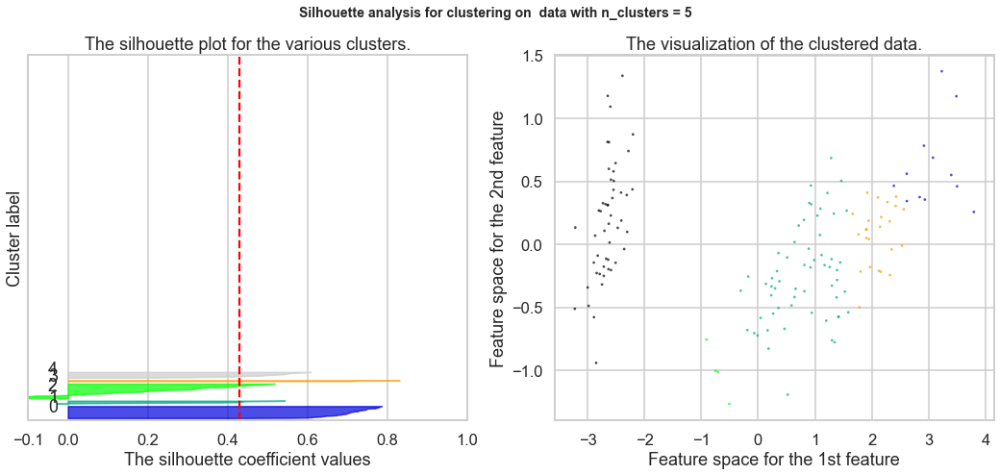

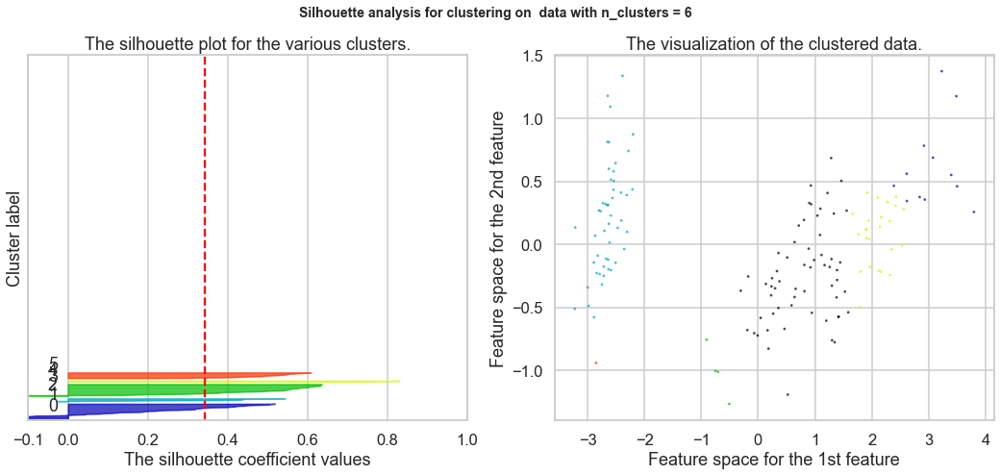

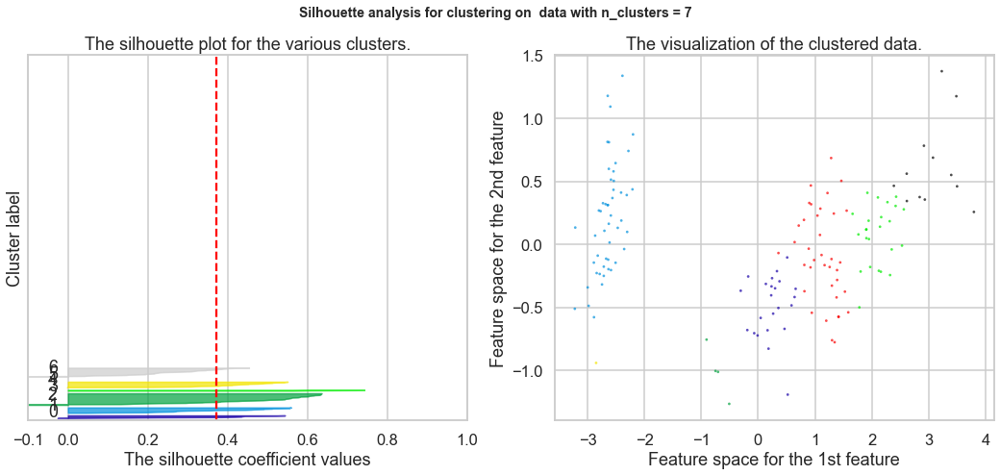

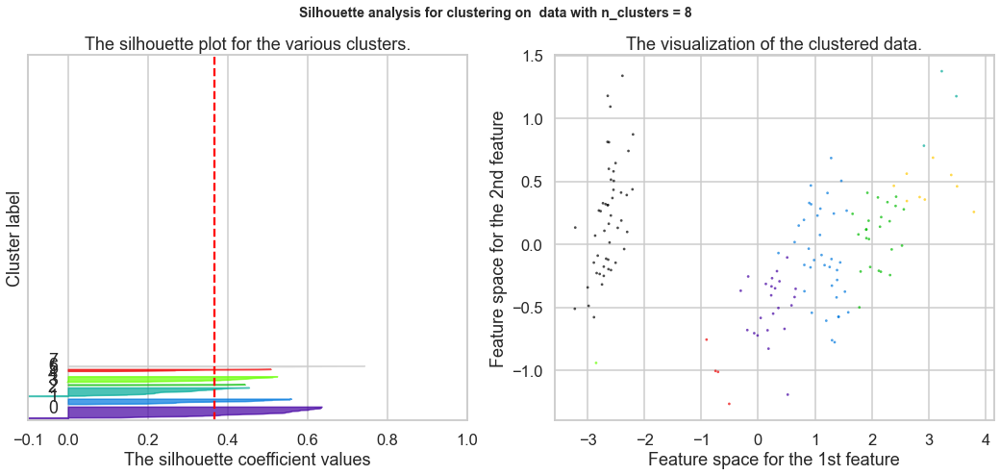

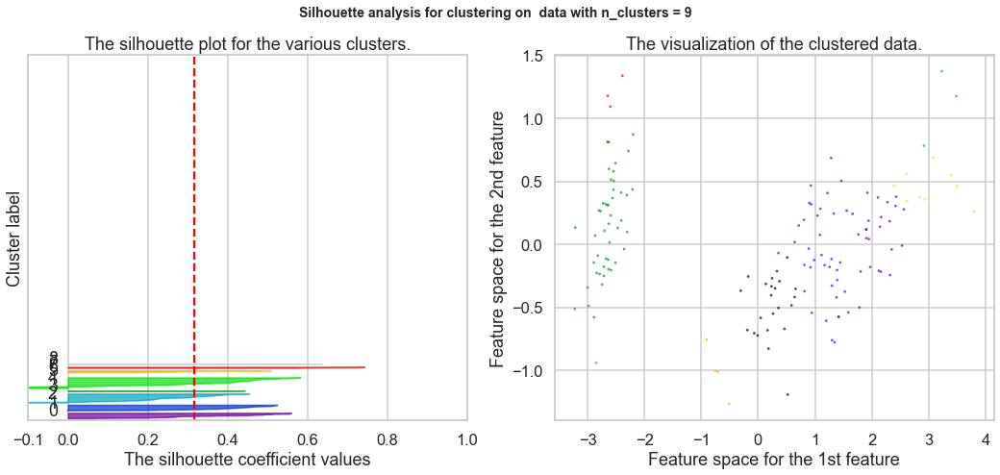

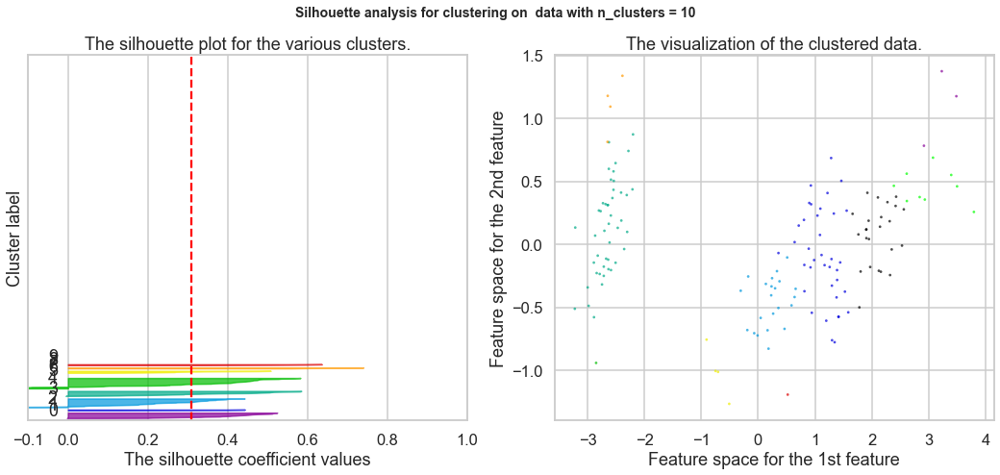

In [50]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='average')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Cosine & Single
(Based on the Silhouette Score the best K is  2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.5538078922044992
For n_clusters = 4 The average silhouette_score is : 0.3926213524338442
For n_clusters = 5 The average silhouette_score is : 0.34676782293978053
For n_clusters = 6 The average silhouette_score is : 0.34236552203239207
For n_clusters = 7 The average silhouette_score is : 0.1709024184601565
For n_clusters = 8 The average silhouette_score is : 0.004585618737091863
For n_clusters = 9 The average silhouette_score is : -0.08052047920874854
For n_clusters = 10 The average silhouette_score is : -0.10796587851518566


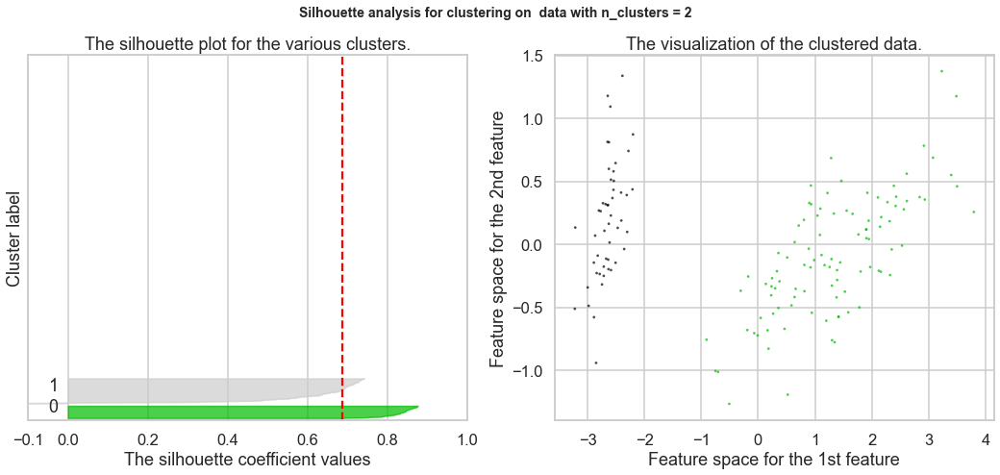

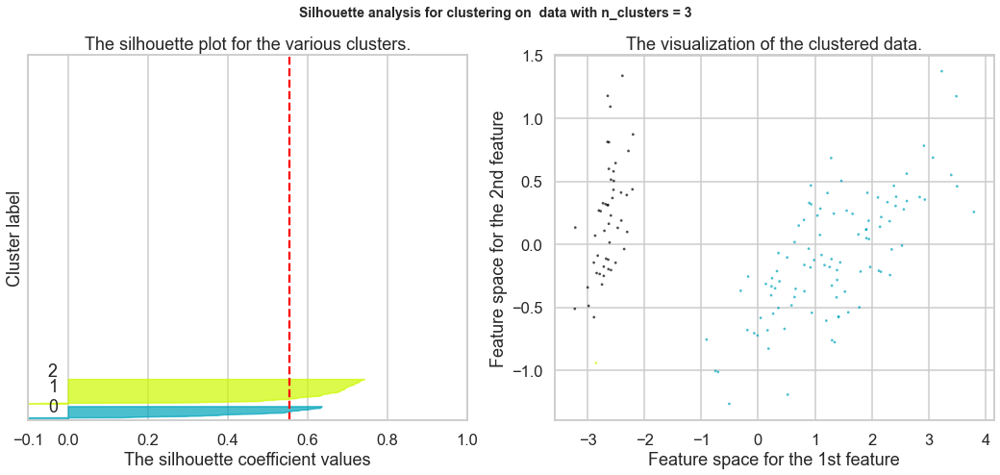

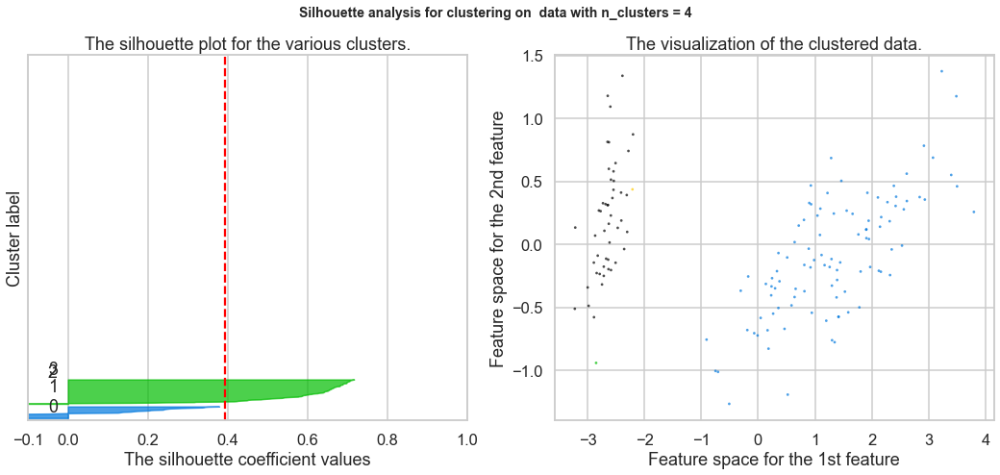

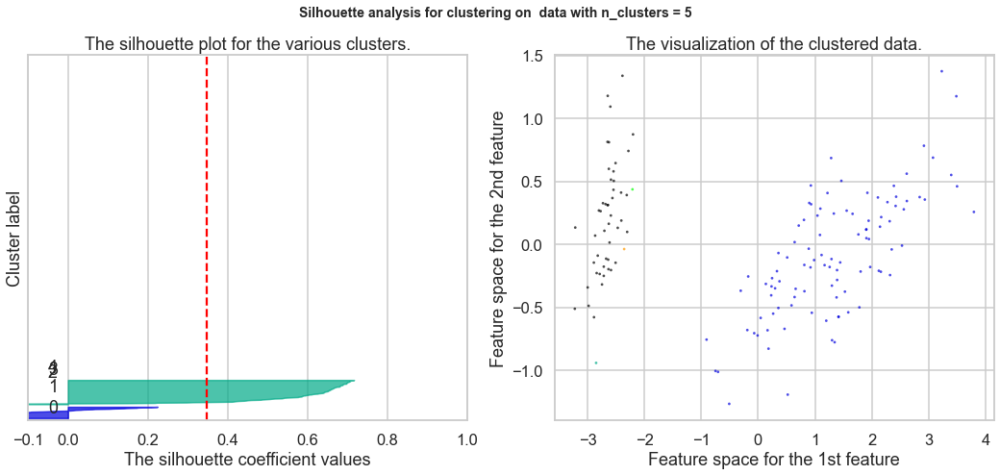

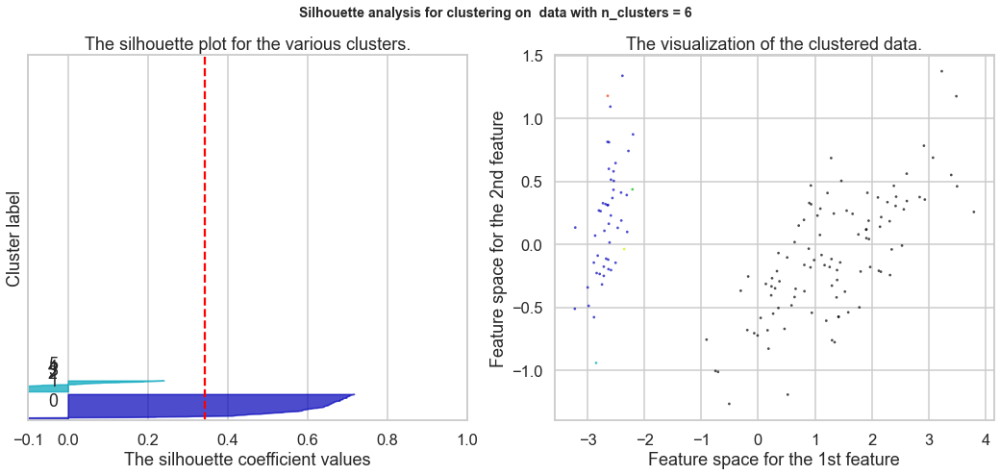

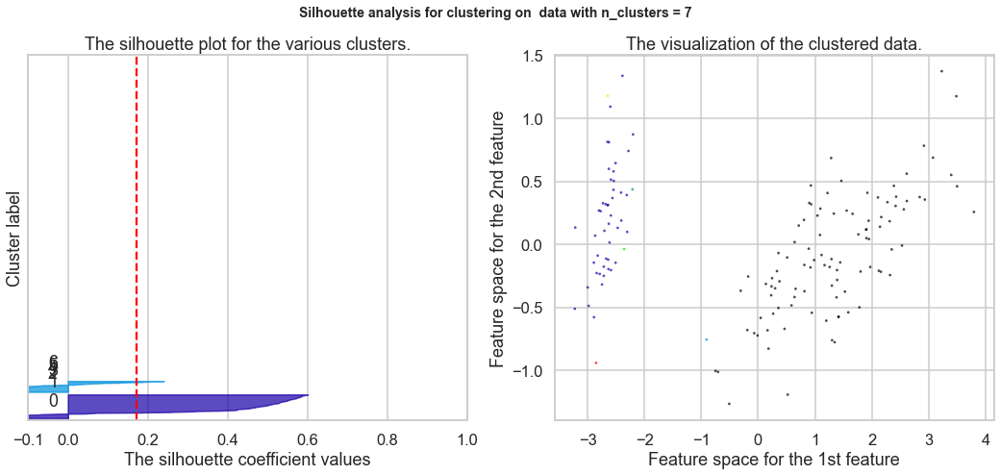

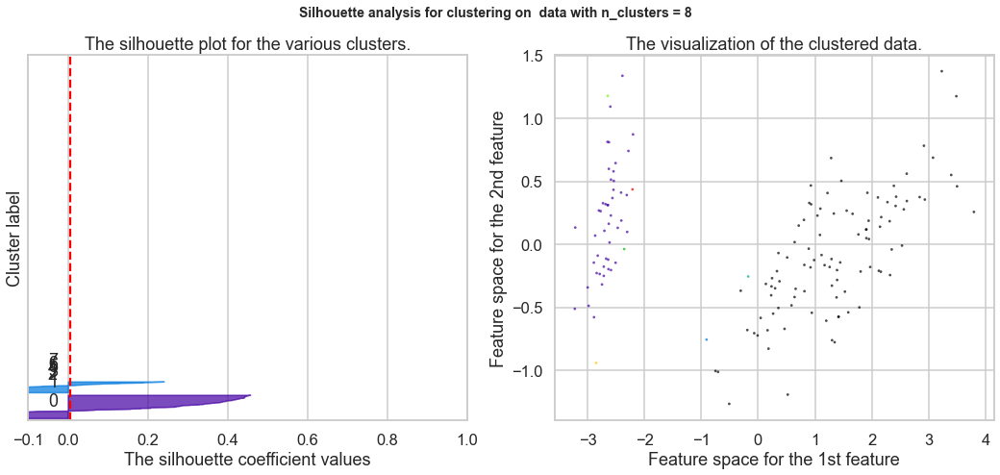

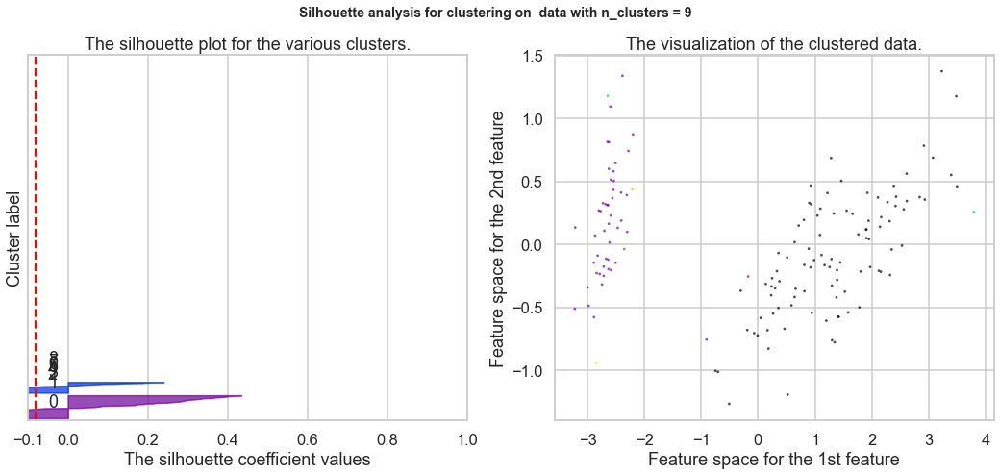

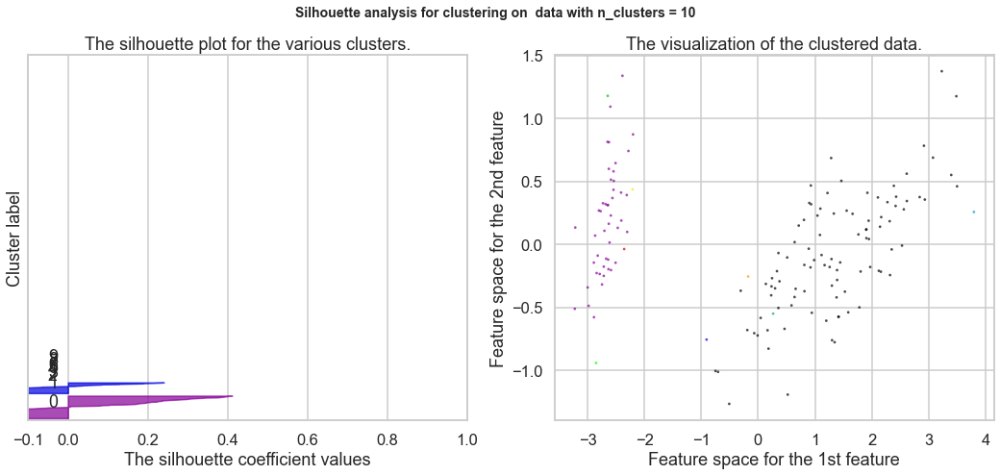

In [51]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='single')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Cosine & Average
(Based on the Silhouette Score the best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.5538078922044992
For n_clusters = 4 The average silhouette_score is : 0.3594039453869132
For n_clusters = 5 The average silhouette_score is : 0.26559130213721477
For n_clusters = 6 The average silhouette_score is : 0.19797507337578052
For n_clusters = 7 The average silhouette_score is : 0.1415608412966915
For n_clusters = 8 The average silhouette_score is : 0.09605797462261692
For n_clusters = 9 The average silhouette_score is : 0.08307467648047547
For n_clusters = 10 The average silhouette_score is : 0.023206381101452567


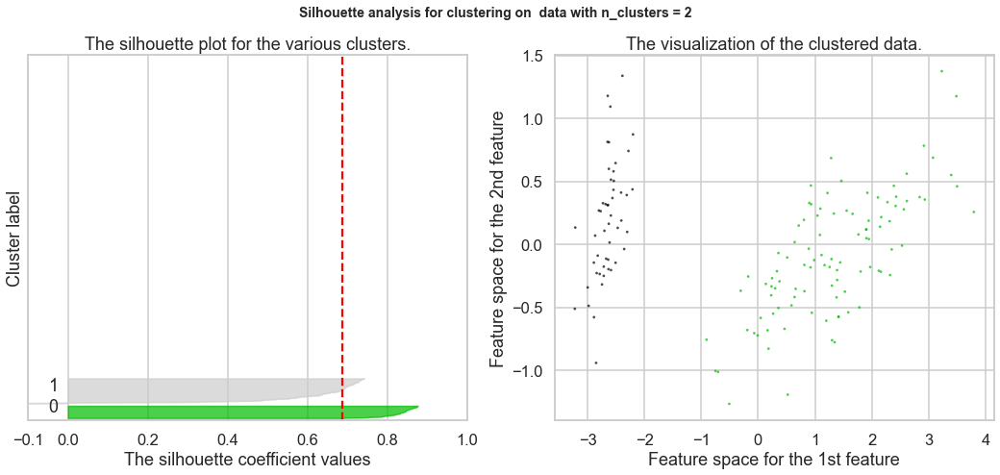

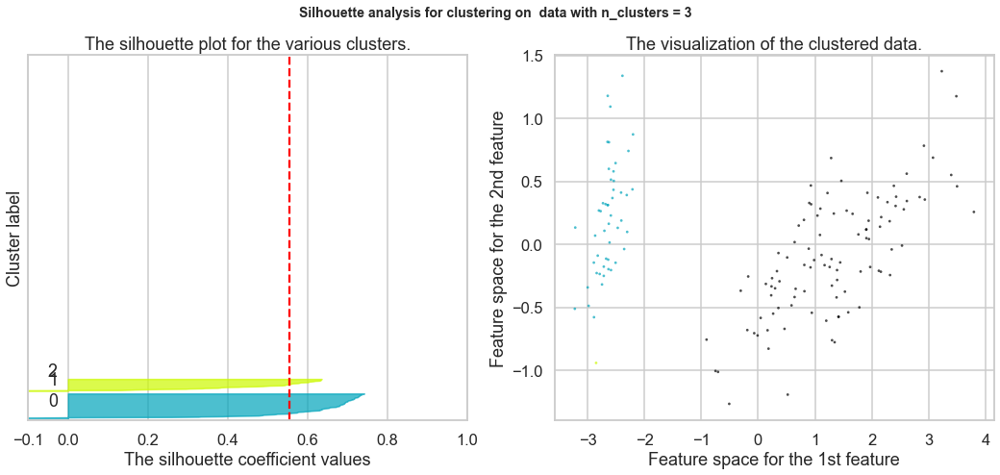

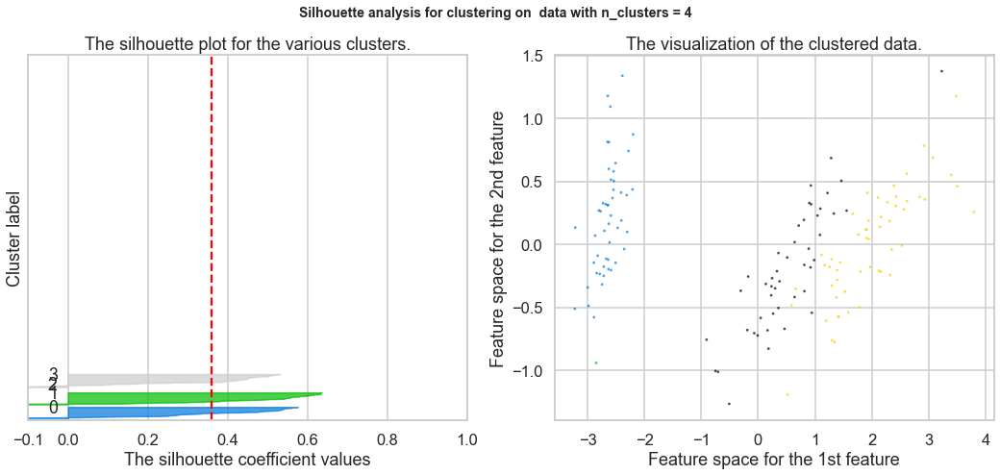

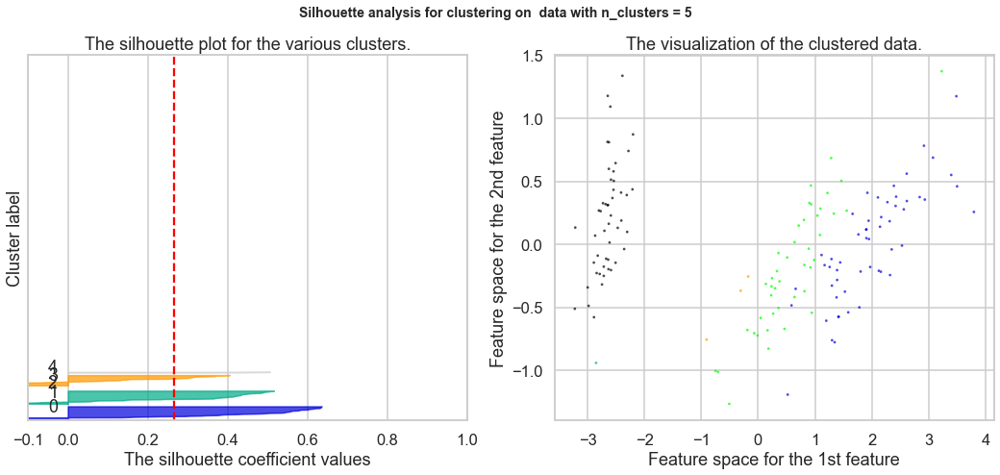

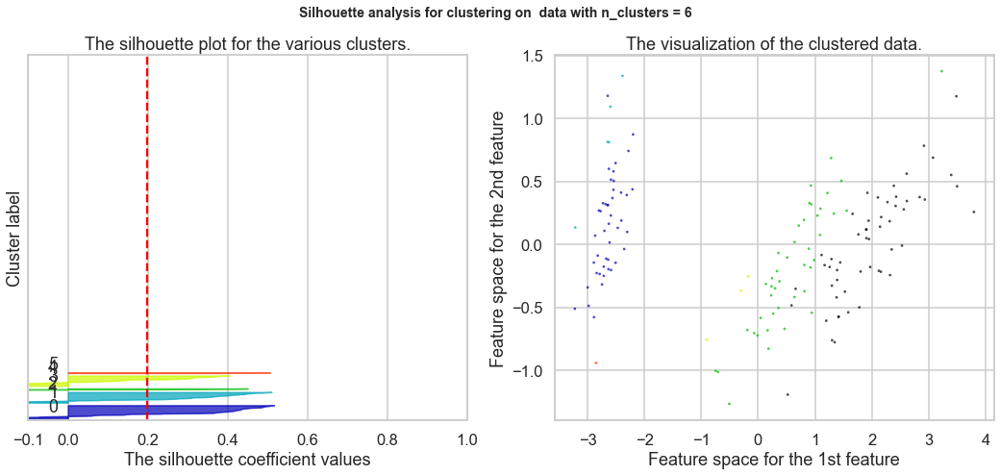

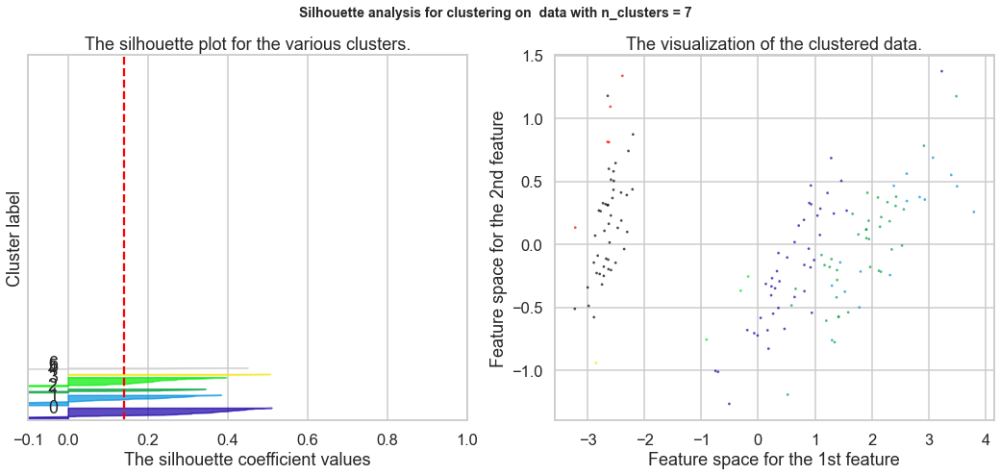

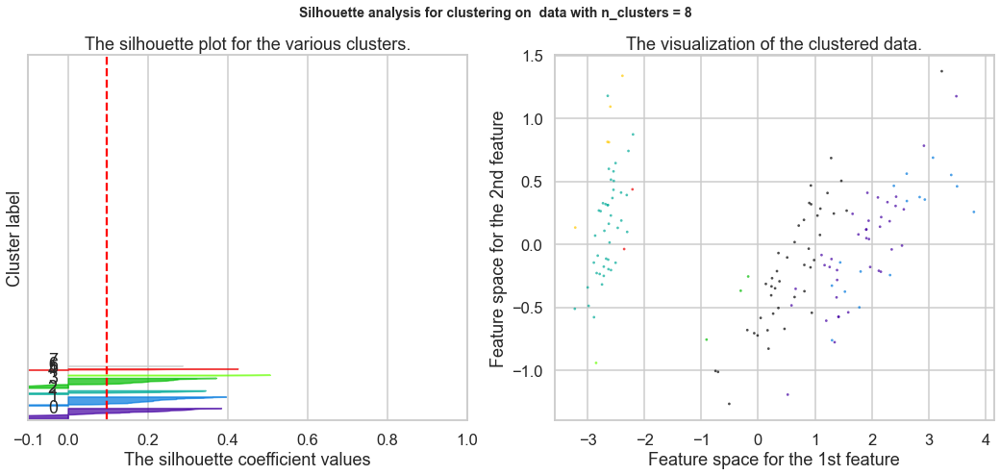

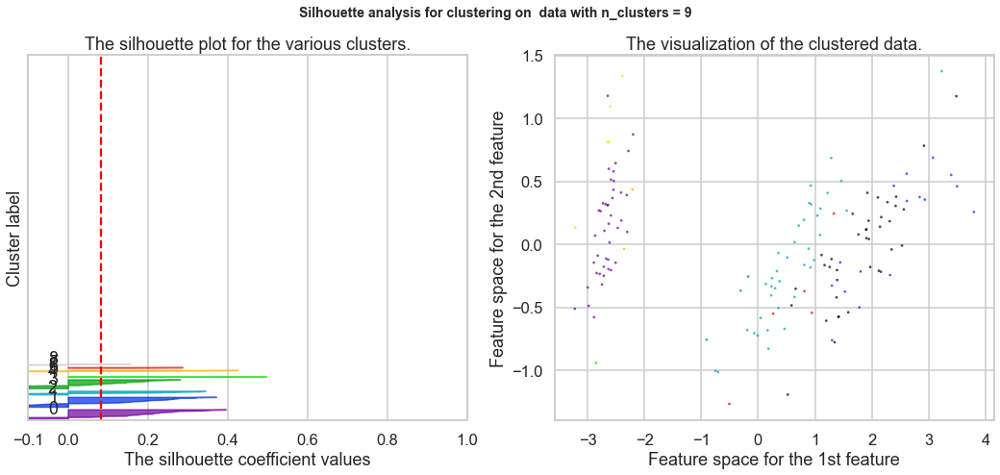

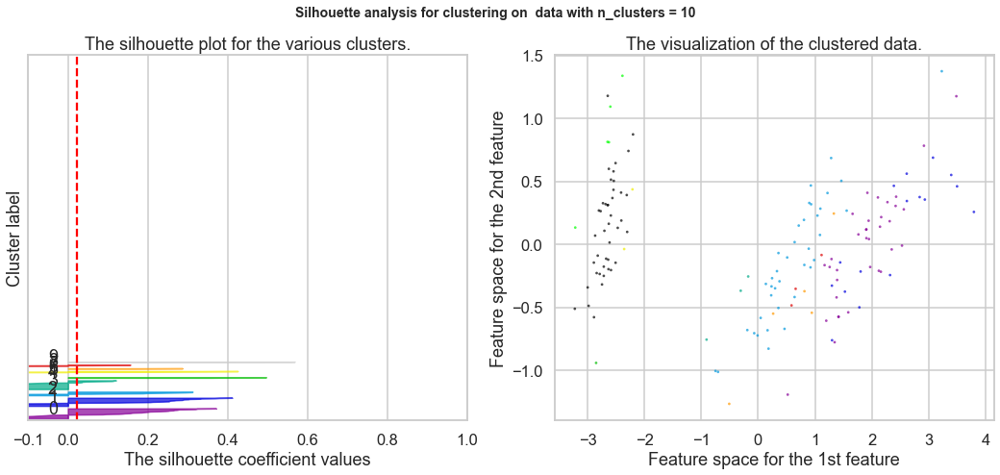

In [52]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='average')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Manhattan & Single
(Based on the Silhouette Score the best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.34029603418948823
For n_clusters = 4 The average silhouette_score is : 0.19471845564874565
For n_clusters = 5 The average silhouette_score is : 0.21943654413134425
For n_clusters = 6 The average silhouette_score is : 0.14611056666235595
For n_clusters = 7 The average silhouette_score is : 0.14738244260973818
For n_clusters = 8 The average silhouette_score is : 0.19335526110542062
For n_clusters = 9 The average silhouette_score is : 0.15751281737501313
For n_clusters = 10 The average silhouette_score is : 0.06883322621905781


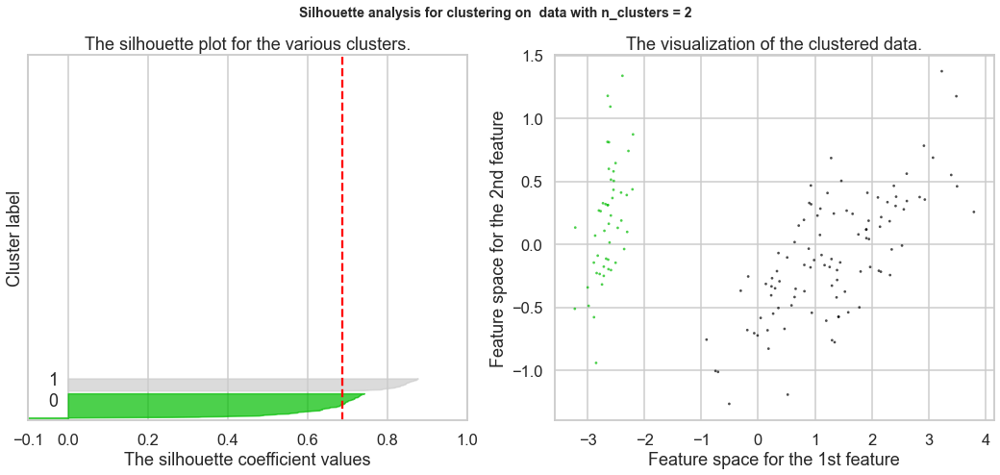

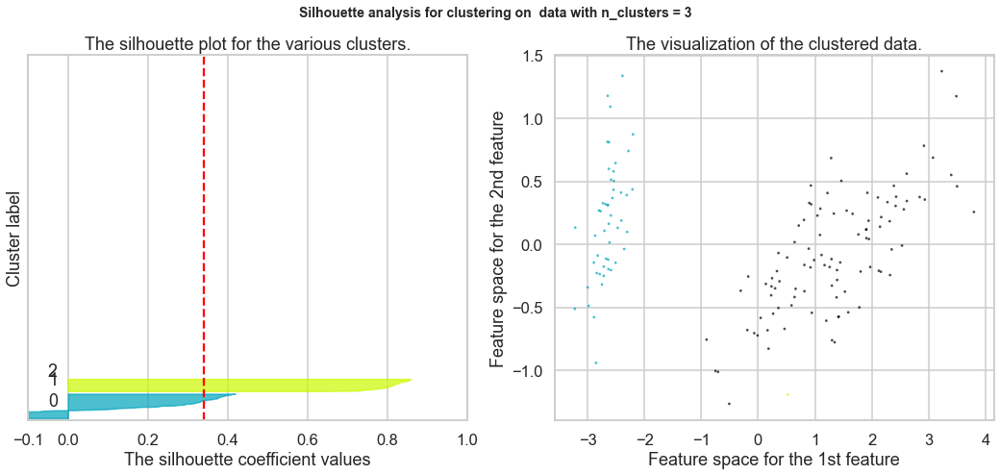

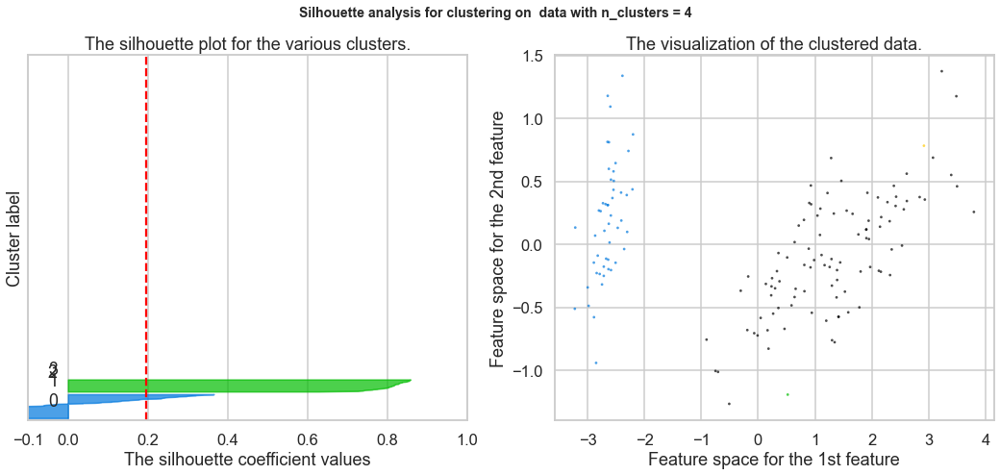

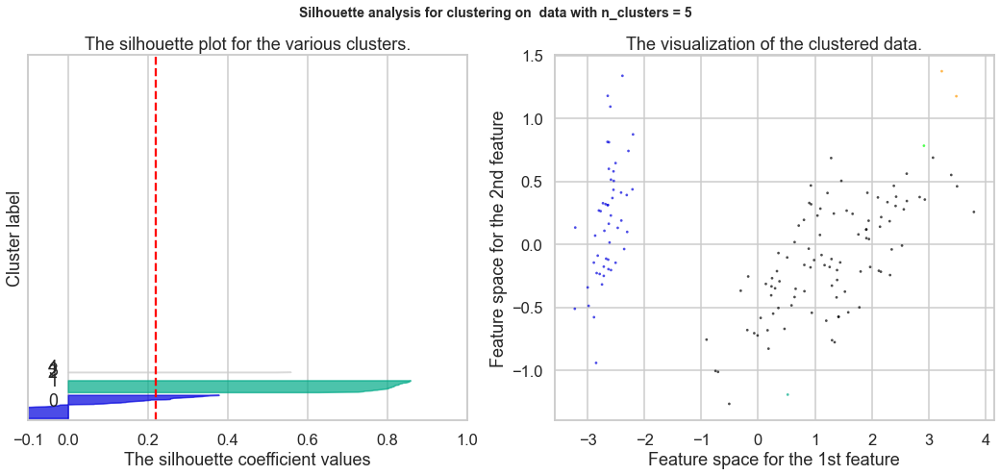

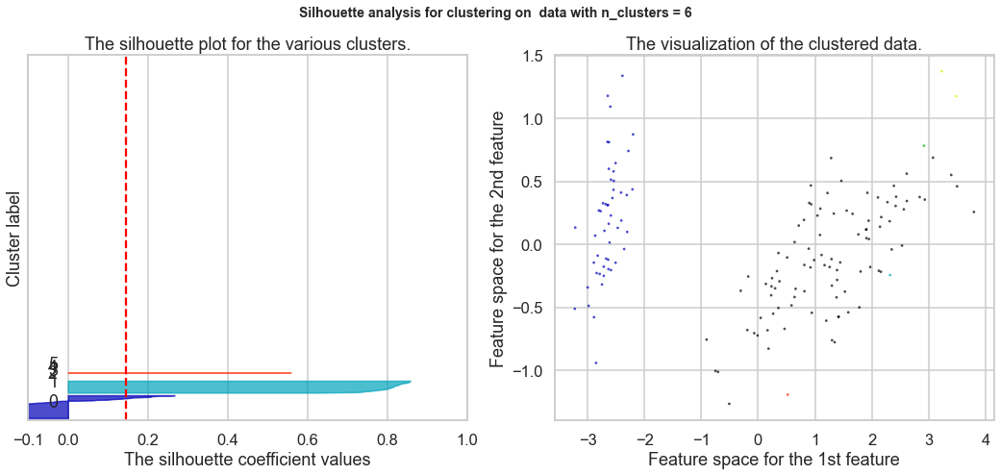

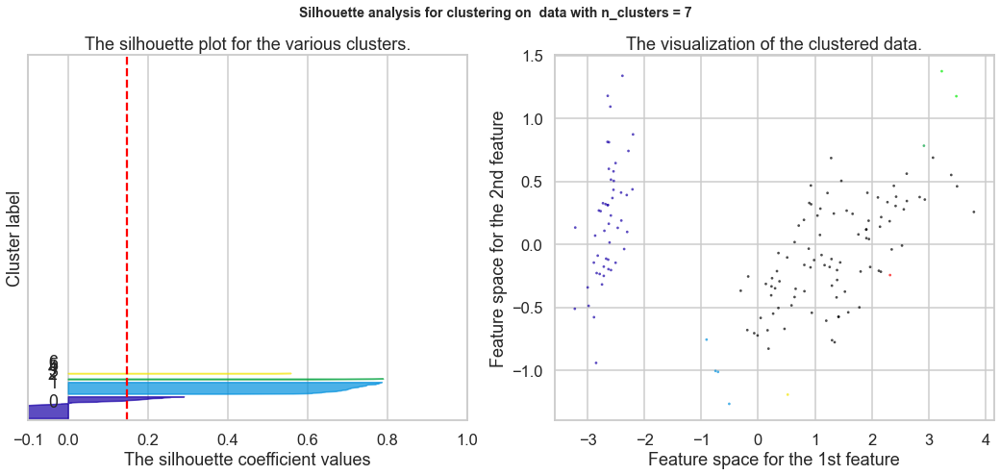

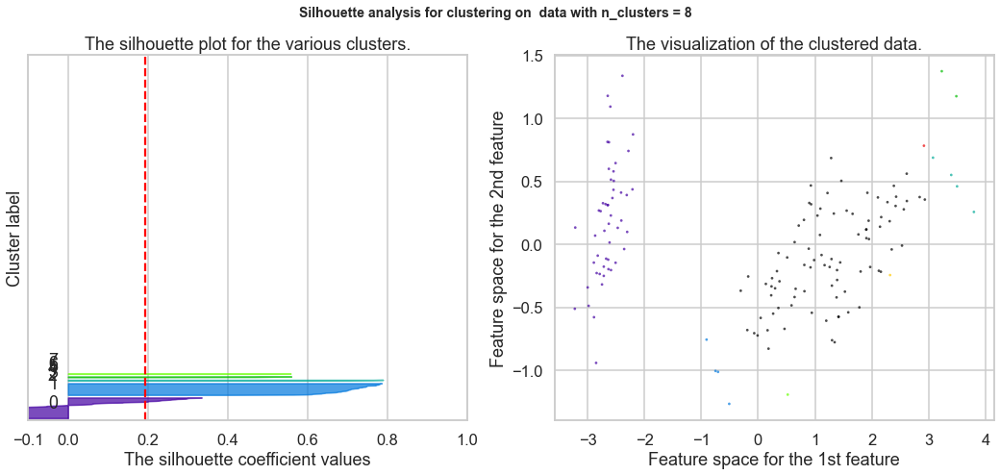

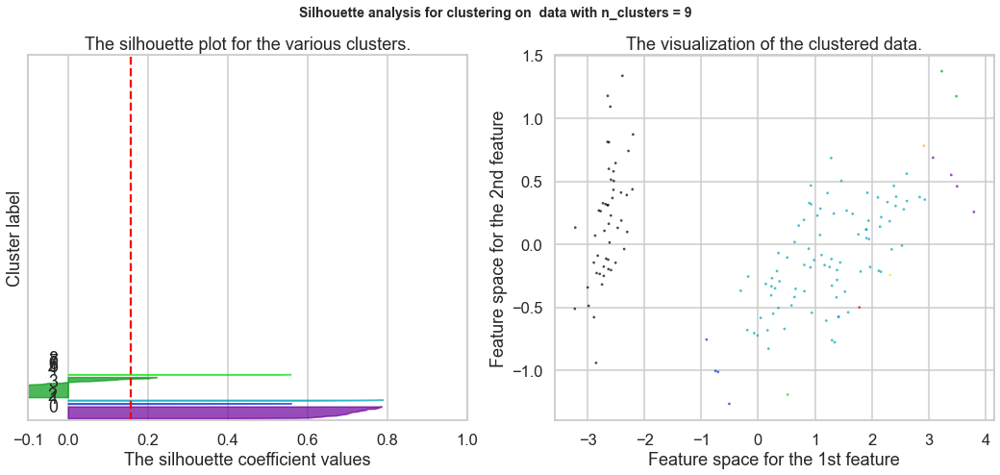

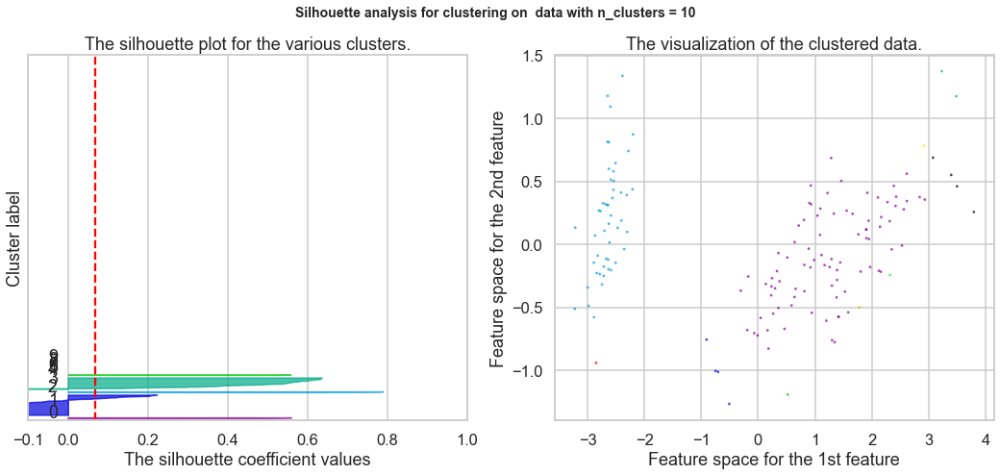

In [53]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='single')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Manhattan & Average
(Based on the Silhouette Score the best K is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.6867350732769777
For n_clusters = 3 The average silhouette_score is : 0.5535372928319979
For n_clusters = 4 The average silhouette_score is : 0.47195185980984994
For n_clusters = 5 The average silhouette_score is : 0.43184804588959724
For n_clusters = 6 The average silhouette_score is : 0.343168454733642
For n_clusters = 7 The average silhouette_score is : 0.3570118422489229
For n_clusters = 8 The average silhouette_score is : 0.3485202563407556
For n_clusters = 9 The average silhouette_score is : 0.3274655508007351
For n_clusters = 10 The average silhouette_score is : 0.3305029942920309


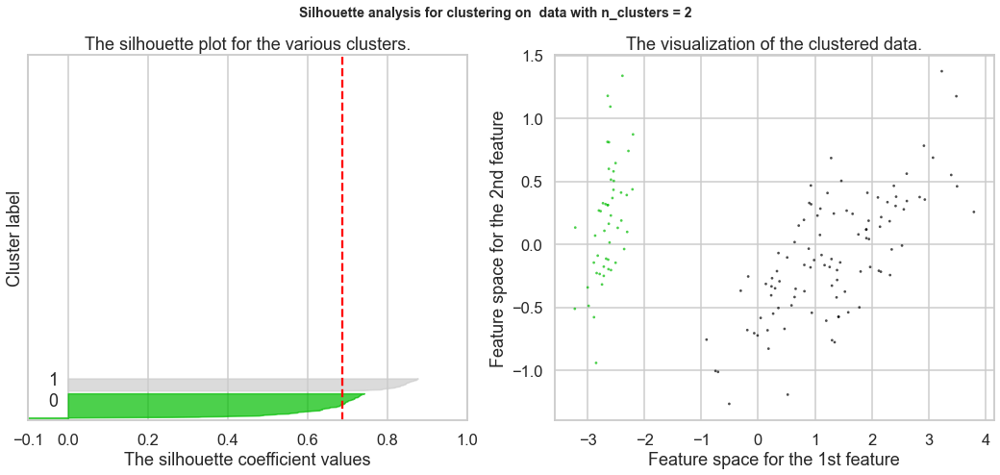

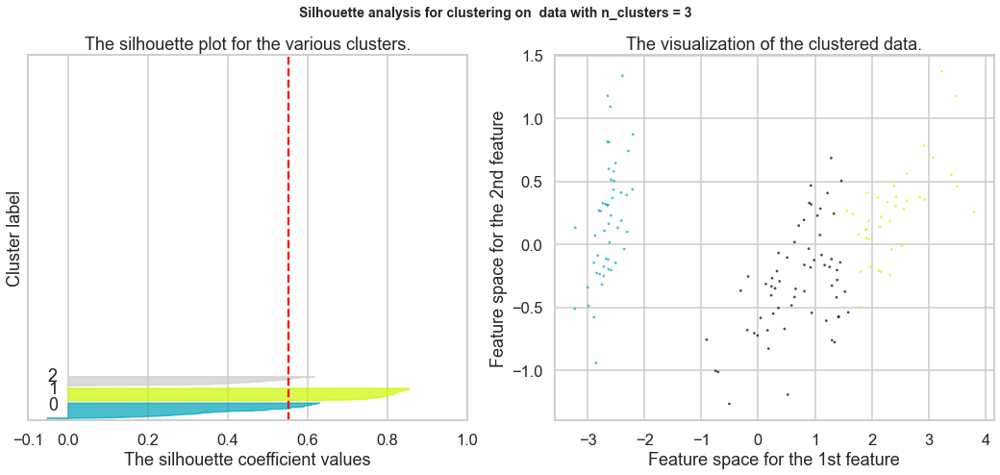

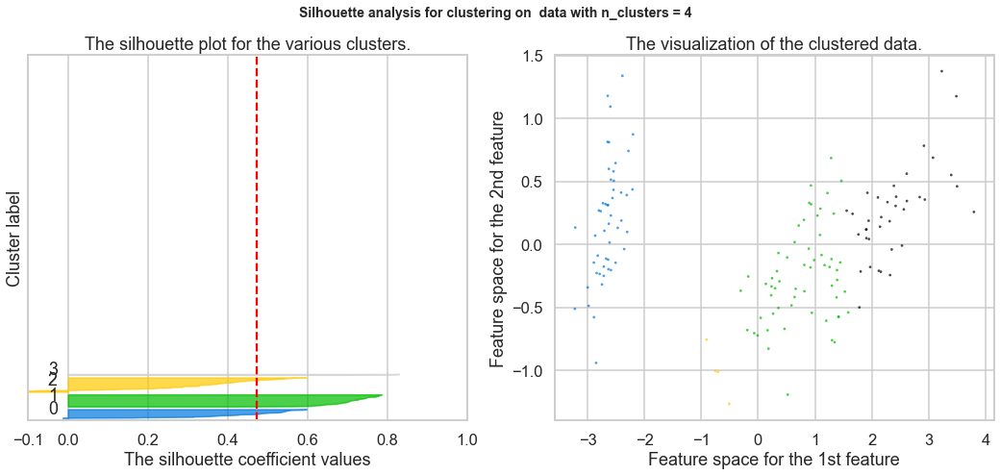

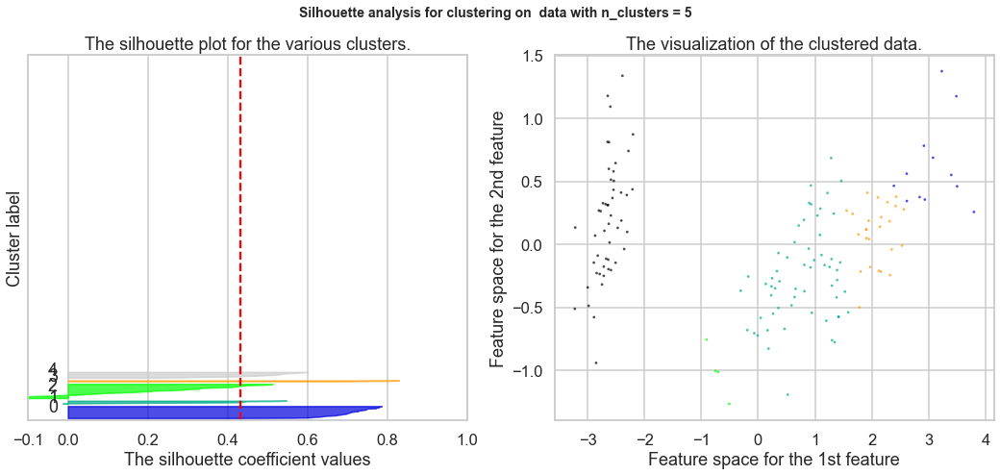

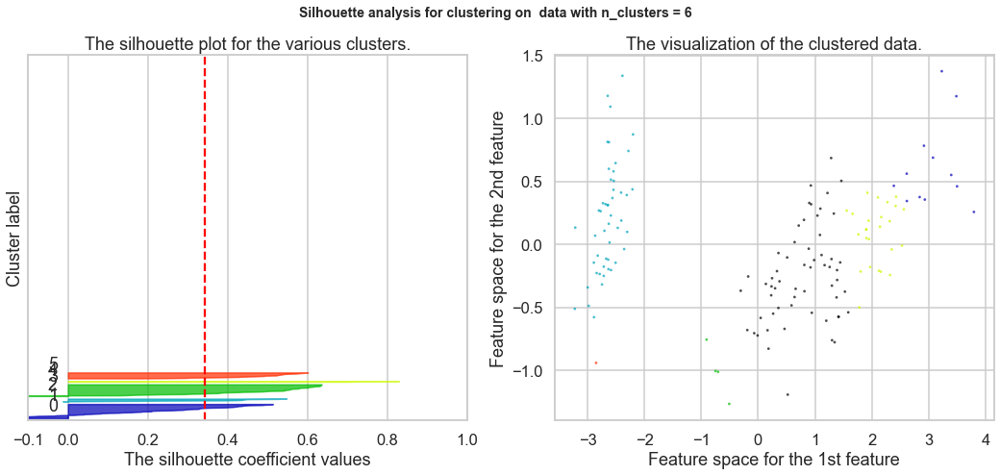

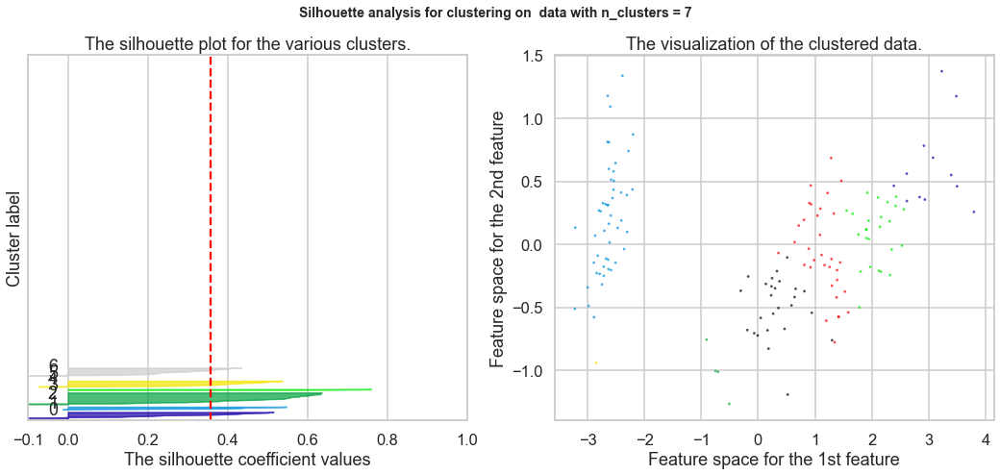

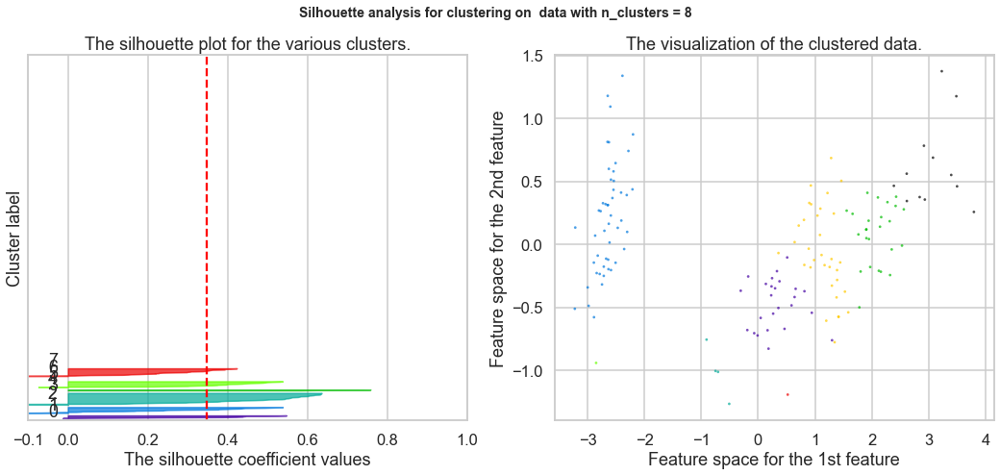

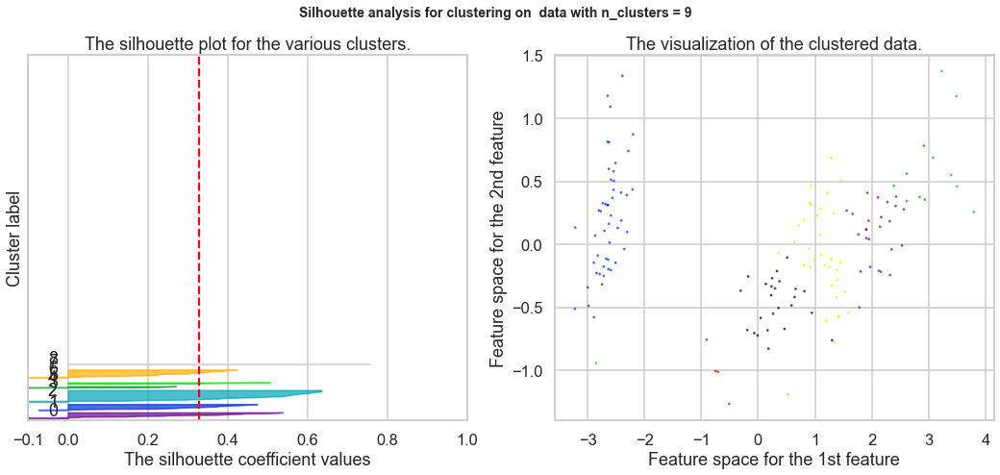

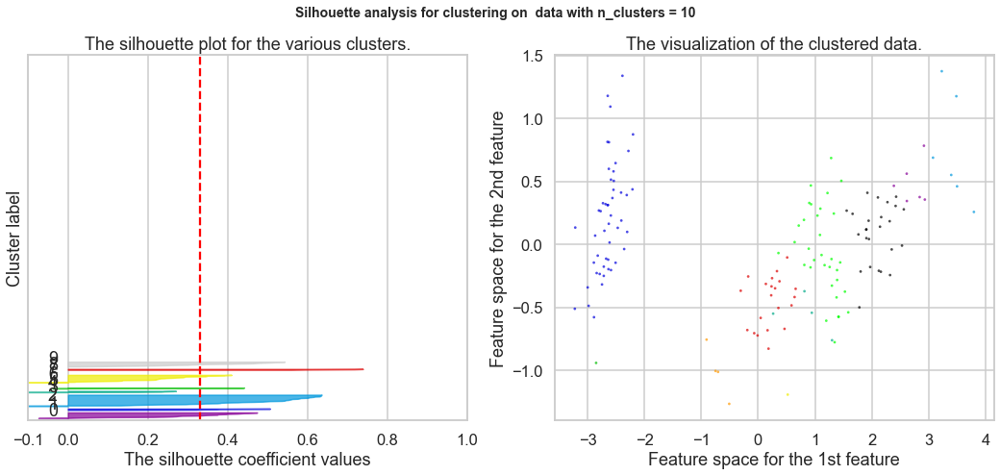

In [54]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(Multi_blob_Data) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='average')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


In [57]:
def hierachy_plot(df1, numk):
    distortions = []
    for k in range(2,numk):
        hac = AgglomerativeClustering(n_clusters=k).fit(df1)
        df1_l = hac.labels_
        distortions.append(silhouette_score(df1, df1_l))

    print(distortions)
    K = range(2, numk)    
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title('The Hierachy Method using silhouette_score')
    plt.show()

[0.5770346019475988, 0.4466890410285909, 0.4006363159855973, 0.33058726295230545, 0.31485480100512825, 0.316969830299128, 0.310946529007258, 0.31143422475471655, 0.3161120375980681, 0.2990064463470654, 0.3050717010768743, 0.31729733710109526, 0.3165285044481548]


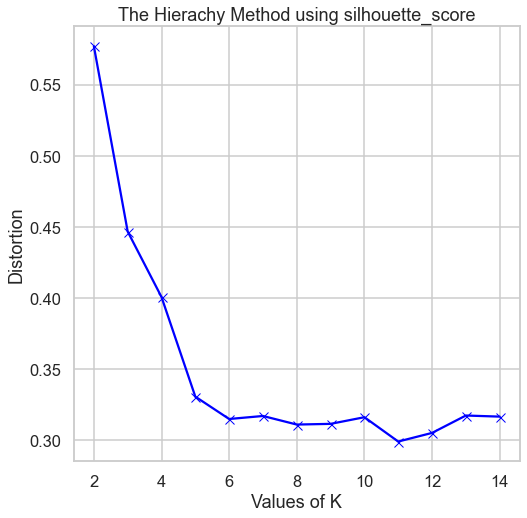

In [60]:
df_scale1=StandardScaler().fit_transform(X)
hierachy_plot(df_scale1, 15)

In [62]:
hac = AgglomerativeClustering(n_clusters= 2).fit(df_scale1)
df_scale1_1 = hac.labels_
db_clustered1_l=hac.labels_
print('/*---------------- Grap Hierarchical----------------*/')
db_clustered1 = df_scale1[(df_scale1_1 >= 0)]
print(silhouette_score(db_clustered1, db_clustered1_l))
print('/*---------------- overall Hierarchical----------------*/')
silhouette_score(df_scale1, df_scale1_1 )

/*---------------- Grap Hierarchical----------------*/
0.5770346019475988
/*---------------- overall Hierarchical----------------*/


0.5770346019475988

# DBScan

In [63]:
import numpy as np
import pandas as pd
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
 
# Defining the list of hyperparameters to try
eps_list=np.arange(start=0.1, stop=3, step=0.1)
min_sample_list=np.arange(start=5, stop=25, step=1)
 
# Creating empty data frame to store the silhouette scores for each trials
silhouette_scores_data=pd.DataFrame()
 
for eps_trial in eps_list:
    for min_sample_trial in min_sample_list:
        
        # Generating DBSAN clusters
        db = DBSCAN(eps=eps_trial, min_samples=min_sample_trial)
        
        if(len(np.unique(db.fit_predict(X)))>1):
            sil_score=silhouette_score(X, db.fit_predict(X))
        else:
            continue
        trial_parameters="eps:" + str(eps_trial.round(1)) +" min_sample :" + str(min_sample_trial)
        
        silhouette_scores_data=silhouette_scores_data.append(pd.DataFrame(data=[[sil_score,trial_parameters]], columns=["score", "parameters"]))
 
# Finding out the best hyperparameters with highest Score
silhouette_scores_data.sort_values(by='score', ascending=False).head(1)


,score,parameters
0,0.686735,eps:1.0 min_sample :10


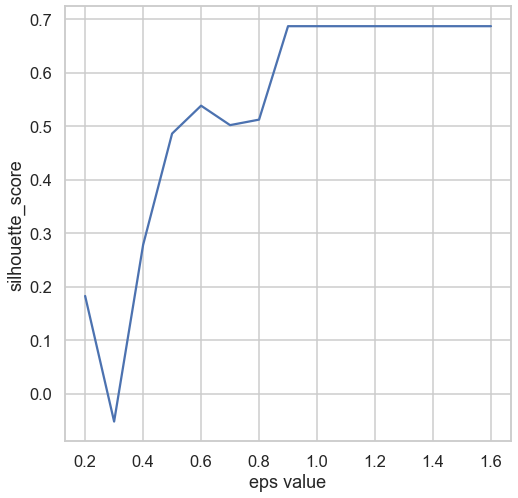

In [168]:
from sklearn.metrics import silhouette_score

# list of eps values
# eps_range=[0.1,0.25,0.5,0.75,0.8,0.9,1,1.25,1.5,1.75,1.8,1.9,2,2.25,2.5]
eps_range = [ 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,1.1,1.2,1.3,1.4,1.5,1.6]
#               1.9,2,2.1,2.2,2.3,2.4]
# 2.5,2.6,2.7,2.8,2.9,]

# list to store silhouette_score values
silhouette_scores =[]

# loop over different eps values
for eps in eps_range:
    # perform clustering using DBSCAN
    db = DBSCAN(eps=eps)
    if(len(np.unique(db.fit_predict(X)))>1):
        sil_score=silhouette_score(X, db.fit_predict(X))
    else:
        continue
#     clustering_model.fit(Multi_blob_Data)
    # calculate silhouette_score
    silhouette_score_value = silhouette_score(X, db.labels_)
    # store silhouette_score in list
    silhouette_scores.append(silhouette_score_value)
    

# plot silhouette_score versus eps

plt.plot(eps_range, silhouette_scores)
plt.xlabel('eps value')
plt.ylabel('silhouette_score')
plt.show()

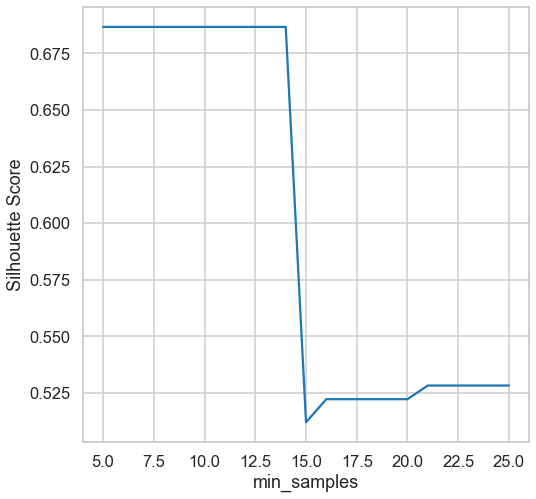

In [75]:
min_samples_values = [5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25]

scores = []

for min_samples in min_samples_values:
    dbscan = DBSCAN(min_samples=min_samples, eps=1)
    dbscan.fit(X)
    labels = dbscan.labels_
    scores.append(silhouette_score(X, labels))

plt.plot(min_samples_values, scores)
plt.xlabel('min_samples')
plt.ylabel('Silhouette Score')
plt.show()

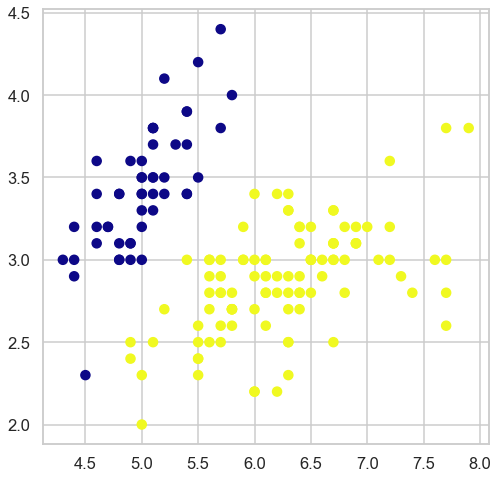

{0, 1}
Estimated no. of clusters: 2
Estimated no. of noise points: 0


In [82]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps = 1, min_samples = 10).fit(X) # fitting the model
labels = dbscan.labels_ # getting the labels
core_samples_mask=np.zeros_like(dbscan.labels_,dtype=bool)
core_samples_mask[dbscan.core_sample_indices_]=True
plt.scatter(X[:, 0], X[:,1], c = labels, cmap= "plasma") # plotting the clusters
plt.show() # showing the plot
no_clusters = len(set(labels))
no_noise = list(labels).count(-1)
print(set(labels))
print('Estimated no. of clusters: %d' % no_clusters)
print('Estimated no. of noise points: %d' % no_noise)

In [84]:
from numpy import unique
model = DBSCAN(eps=1, min_samples= 10)
# rule of thumb for min_samples: 2*len(cluster_df.columns)
# fit model and predict clusters
yhat = model.fit_predict(X)
# retrieve unique clusters
clusters = unique(yhat)
score_dbsacn_s = silhouette_score(X, yhat, metric='euclidean')
print('Silhouette Score: %.4f' % score_dbsacn_s)

Silhouette Score: 0.6867


# Gaussian Mixture

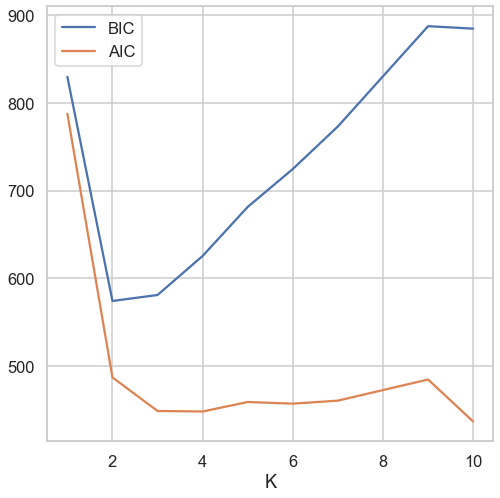

In [133]:
n_components = np.arange(1, 11)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(X) for n in n_components]
plt.plot(n_components, [m.bic(X) for m in models], label='BIC')
plt.plot(n_components, [m.aic(X) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('K');

In [134]:
gmm = GaussianMixture(n_components=2)
gmm.fit(X)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=2, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

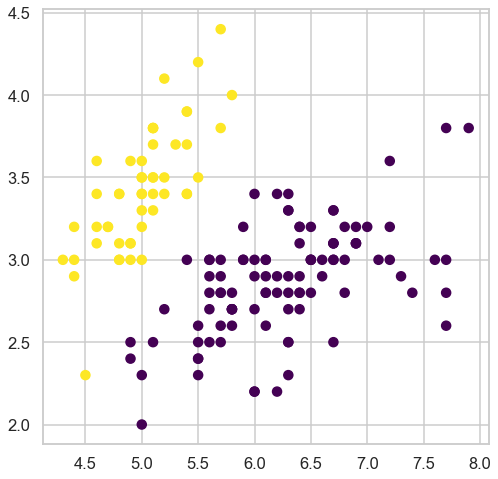

In [135]:
labels = gmm.predict(X)
plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis');

## Customer dataset
Repeat all the above on the customer data set 

# Kmeans

In [91]:
dfc = pd.read_csv('Customer data.csv')
dfc.head()


,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [92]:
dfc.drop(['ID'], axis=1)

,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,0,0,67,2,124670,1,2
1,1,1,22,1,150773,1,2
2,0,0,49,1,89210,0,0
3,0,0,45,1,171565,1,1
4,0,0,53,1,149031,1,1
...,...,...,...,...,...,...,...
1995,1,0,47,1,123525,0,0
1996,1,1,27,1,117744,1,0
1997,0,0,31,0,86400,0,0
1998,1,1,24,1,97968,0,0


In [94]:
from sklearn.preprocessing import StandardScaler, normalize
scaler = StandardScaler()
dfc = scaler.fit_transform(dfc)
dfc

array([[-1.731185  , -0.91739884, -0.99302433, ...,  0.09752361,
         0.29682303,  1.552326  ],
       [-1.72945295,  1.09003844,  1.00702467, ...,  0.78265438,
         0.29682303,  1.552326  ],
       [-1.7277209 , -0.91739884, -0.99302433, ..., -0.83320224,
        -1.26952539, -0.90972951],
       ...,
       [ 1.7277209 , -0.91739884, -0.99302433, ..., -0.90695688,
        -1.26952539, -0.90972951],
       [ 1.72945295,  1.09003844,  1.00702467, ..., -0.60332923,
        -1.26952539, -0.90972951],
       [ 1.731185  , -0.91739884, -0.99302433, ..., -1.3789866 ,
        -1.26952539, -0.90972951]])

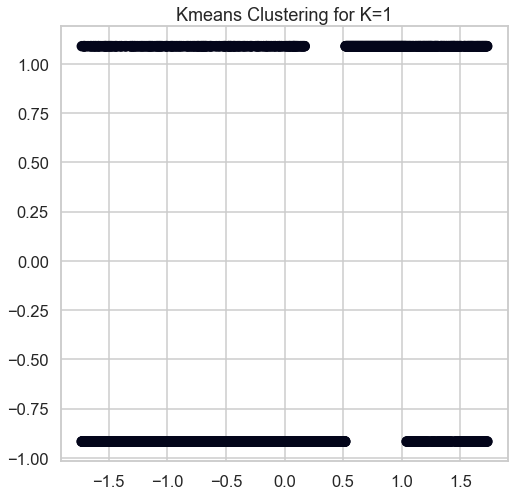

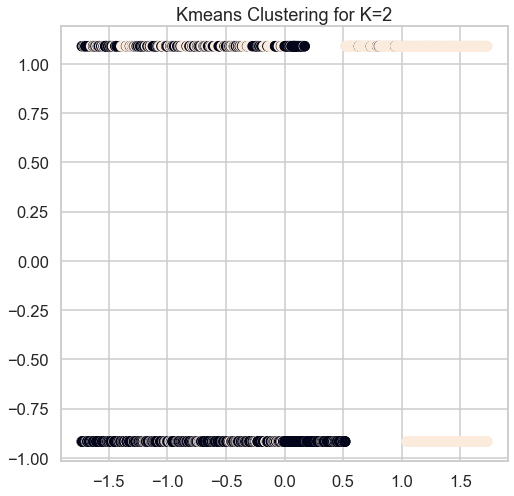

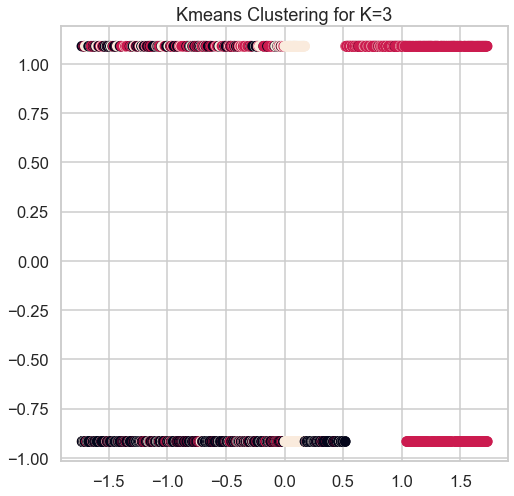

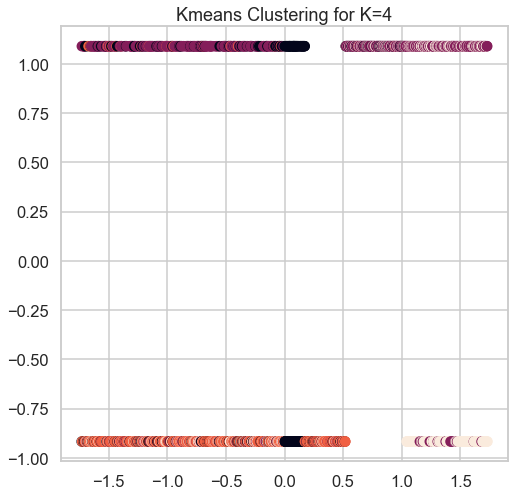

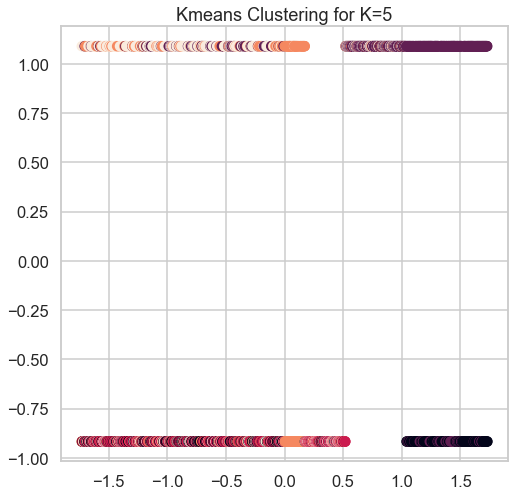

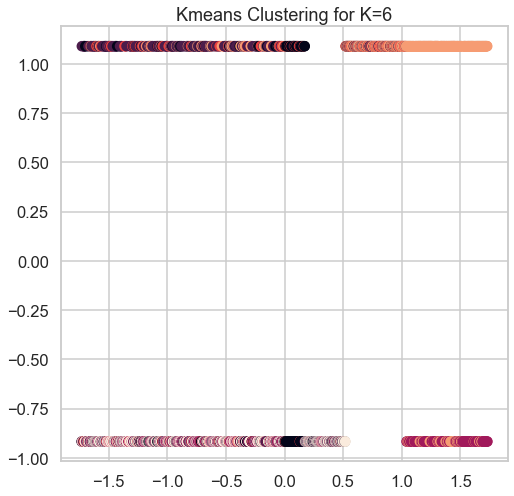

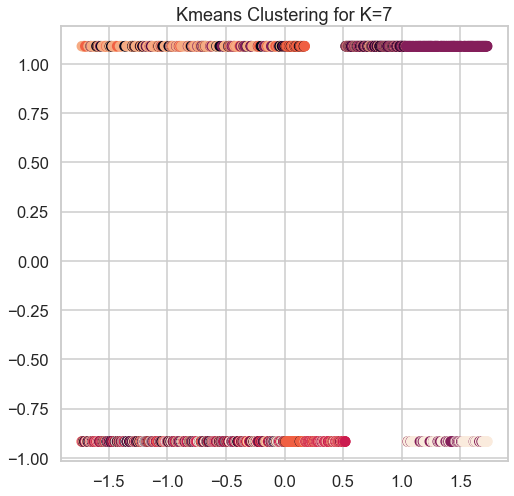

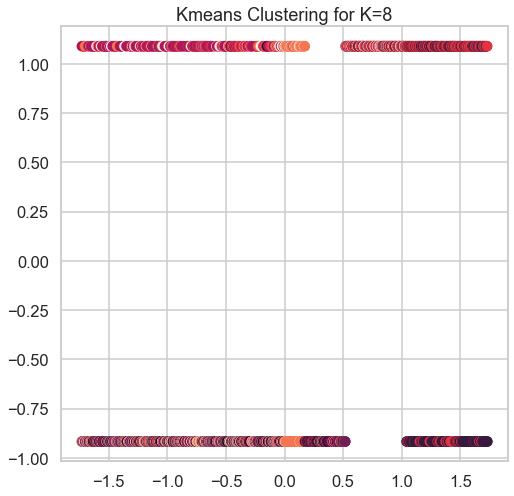

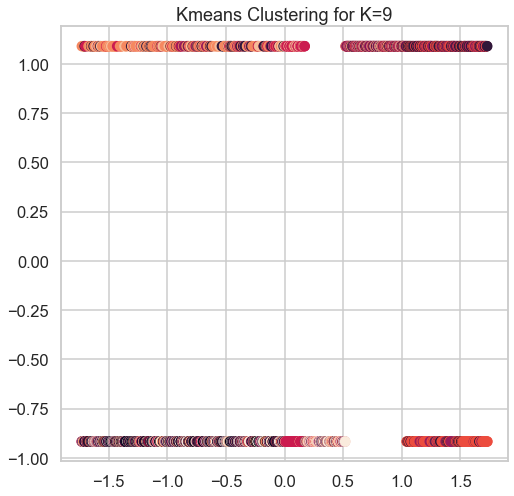

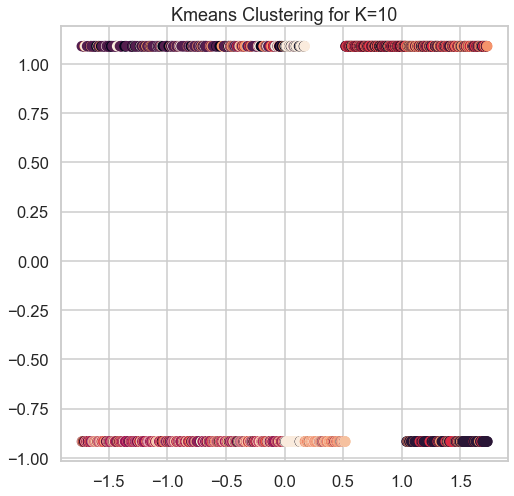

In [97]:
# dfc = pd.read_csv('Customer data.csv')
cs = []
for k in range (1,11):
    kmeans = KMeans(n_clusters = k, init = 'k-means++', max_iter = 30, n_init = 10, random_state = 0)
    kmeans.fit(dfc)
    cs.append(kmeans.inertia_)
    plt.scatter(dfc[:,0], dfc[:,1], c=kmeans.labels_)
    plt.title("Kmeans Clustering for K="+str(k))
    plt.show()

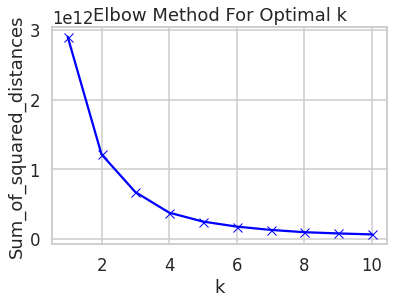

3

In [115]:
inertia = []
K = range(1,11)
distortions=[]
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(dfc)
    inertia.append(km.inertia_)
    distortions.append(sum(np.min(scipy.spatial.distance.cdist(dfc,
    km.cluster_centers_, 'euclidean'),axis=1)) /
    df.shape[0])
plt.plot(K, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()
kl = KneeLocator(range(1, 11), inertia, curve="convex", direction="decreasing")
kl.elbow

Silhouette Score for k=2 is 0.23413810062406393
Silhouette Score for k=3 is 0.24439365126030935
Silhouette Score for k=4 is 0.23461397302170642
Silhouette Score for k=5 is 0.22467182429652655
Silhouette Score for k=6 is 0.23450626116541007
Silhouette Score for k=7 is 0.23502047972286647
Silhouette Score for k=8 is 0.24084308524753117
Silhouette Score for k=9 is 0.24240260425272075
Silhouette Score for k=10 is 0.24737990838496185


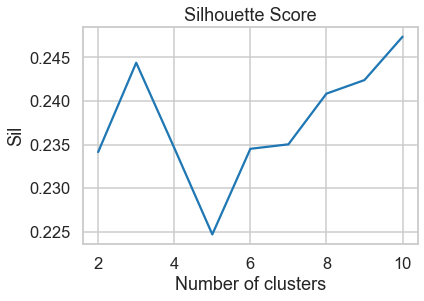

In [99]:
sil = []
scores=[]

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, 11):
  kmeans = KMeans(n_clusters = k).fit(dfc)
  labels = kmeans.labels_
  score=np.array(silhouette_score(dfc, labels))
  sil.append(score)
  print("Silhouette Score for k="+str(k),"is",str(score))
plt.plot(range(2, 11), sil)
plt.title('Silhouette Score')
plt.xlabel('Number of clusters')
plt.ylabel('Sil')
plt.show()

# Hierarchal Clustering

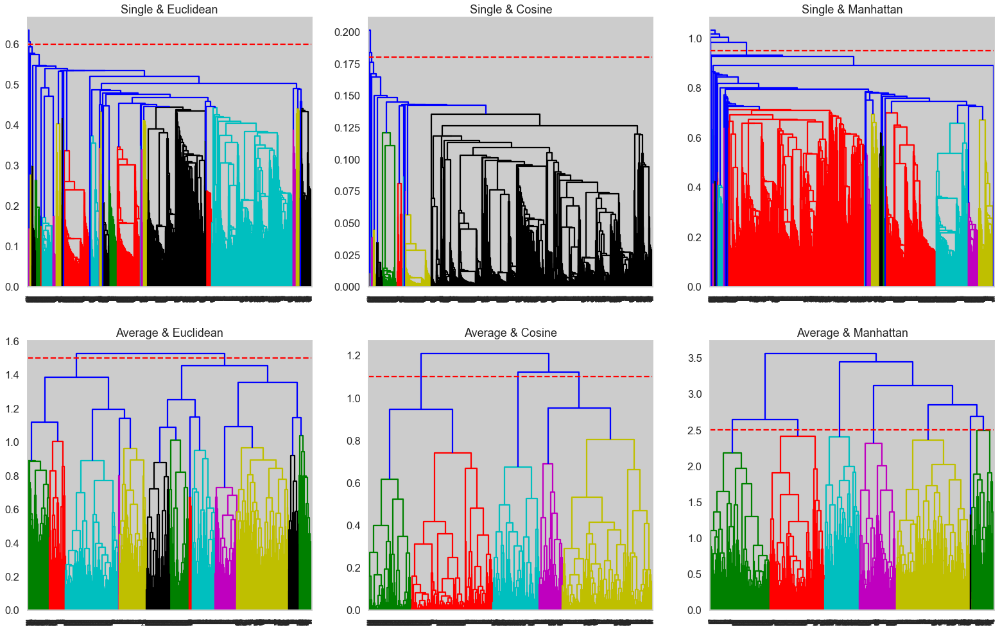

In [120]:
from sklearn.preprocessing import normalize
X_2 = normalize(dfc)
Z1_2 = shc.linkage(X_2, method='single', metric='euclidean')
Z2_2 = shc.linkage(X_2, method='single', metric='cosine')
Z3_2 = shc.linkage(X_2, method='single', metric='cityblock')
Z4_2 = shc.linkage(X_2, method='average', metric='euclidean')
Z5_2 = shc.linkage(X_2, method='average', metric='cosine')
Z6_2 = shc.linkage(X_2, method='average', metric='cityblock')
plt.figure(figsize=(27, 17))
plt.subplot(2,3,1), dendrogram(Z1_2), plt.title('Single & Euclidean'),plt.axhline(y=0.6, color='r', linestyle='--')
plt.subplot(2,3,2), dendrogram(Z2_2), plt.title('Single & Cosine'),plt.axhline(y=0.18, color='r', linestyle='--')
plt.subplot(2,3,3), dendrogram(Z3_2), plt.title('Single & Manhattan'),plt.axhline(y=0.95, color='r', linestyle='--')
plt.subplot(2,3,4), dendrogram(Z4_2), plt.title('Average & Euclidean'),plt.axhline(y=1.5, color='r', linestyle='--')
plt.subplot(2,3,5), dendrogram(Z5_2), plt.title('Average & Cosine'),plt.axhline(y=1.1, color='r', linestyle='--')
plt.subplot(2,3,6), dendrogram(Z6_2), plt.title("Average & Manhattan"),plt.axhline(y=2.5, color='r', linestyle='--')
plt.show()

[2.72965067 1.85521555]


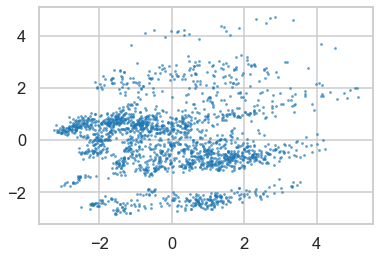

In [103]:
from sklearn.decomposition import PCA
#PCA with two principal components
PCA_2d = PCA(n_components=2).fit(dfc)
#PCA_2d.head()
print(PCA_2d.explained_variance_)
PCA_2d = PCA(n_components=2).fit_transform(dfc)
plt.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7, edgecolor='k')

Euclidean & Single
(Based on the silhouette Sore the best k is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.30991073468773084
For n_clusters = 3 The average silhouette_score is : 0.27639525619748767
For n_clusters = 4 The average silhouette_score is : 0.23126578336451484
For n_clusters = 5 The average silhouette_score is : 0.1846695256133408
For n_clusters = 6 The average silhouette_score is : 0.1712284710774885
For n_clusters = 7 The average silhouette_score is : 0.16370946428392416
For n_clusters = 8 The average silhouette_score is : 0.13116144389968018
For n_clusters = 9 The average silhouette_score is : 0.10829609064424278
For n_clusters = 10 The average silhouette_score is : 0.08726003190359637


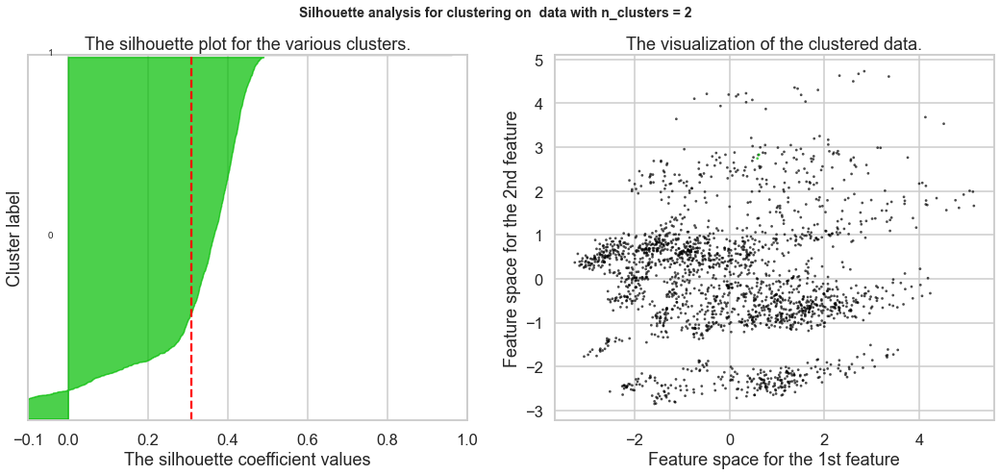

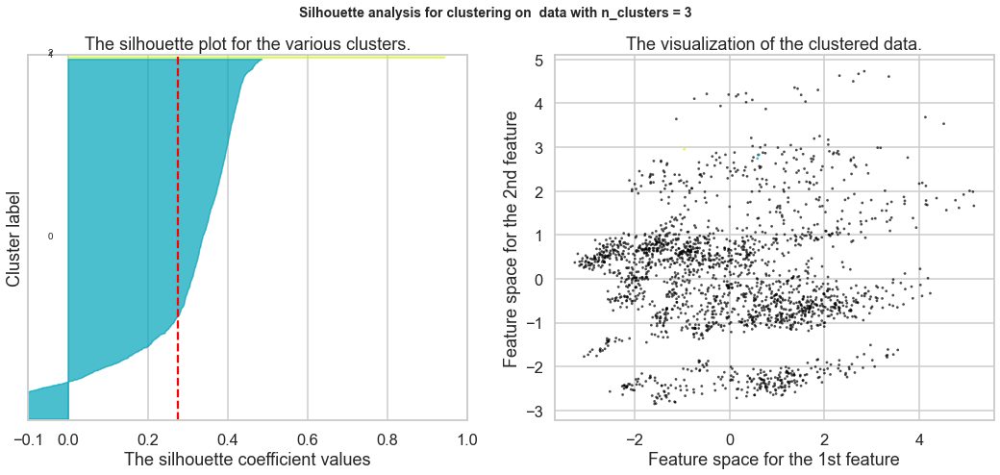

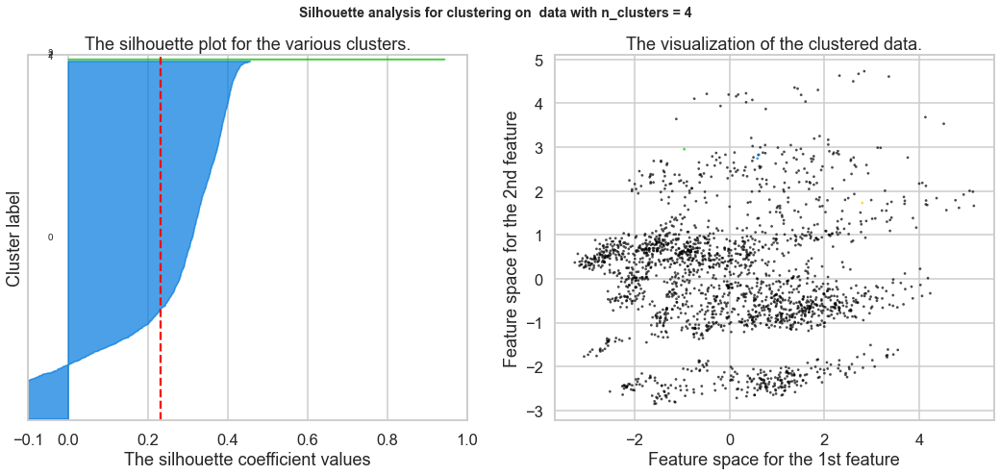

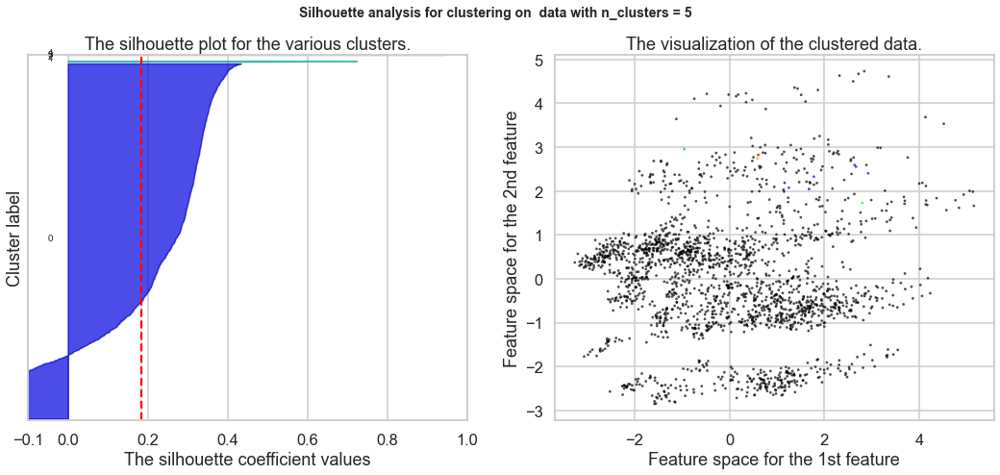

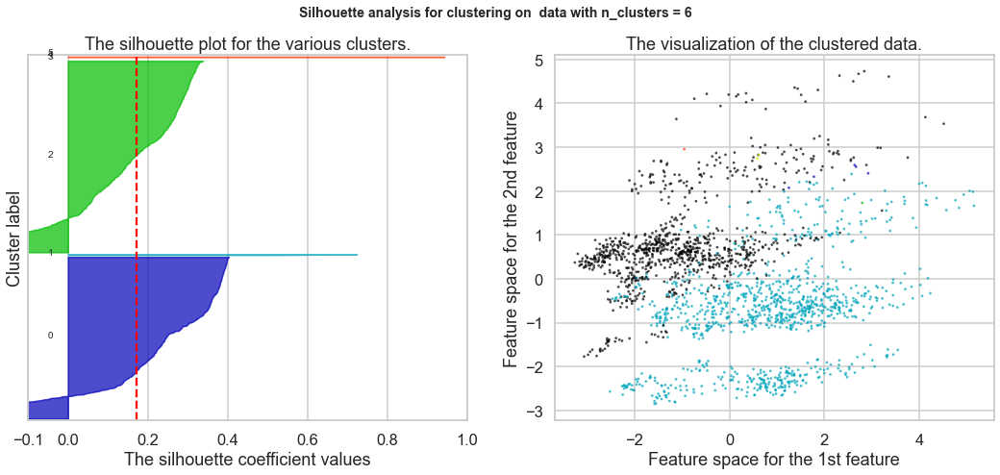

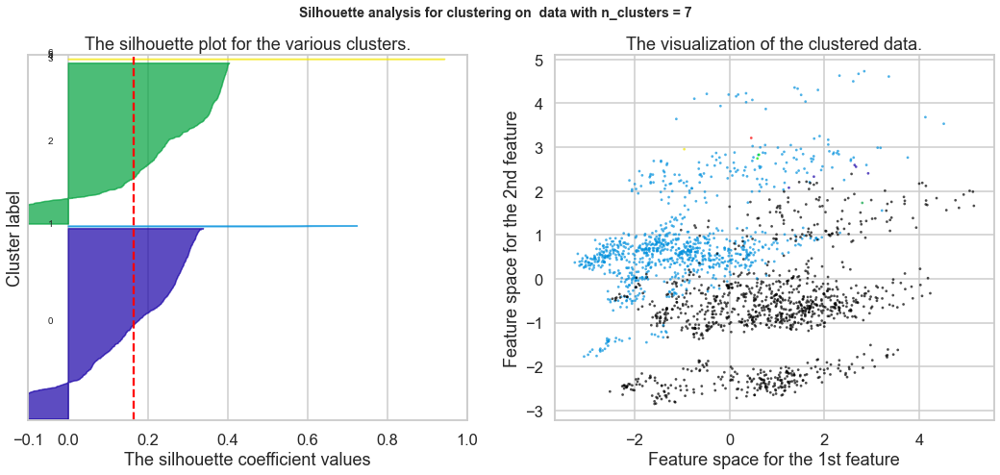

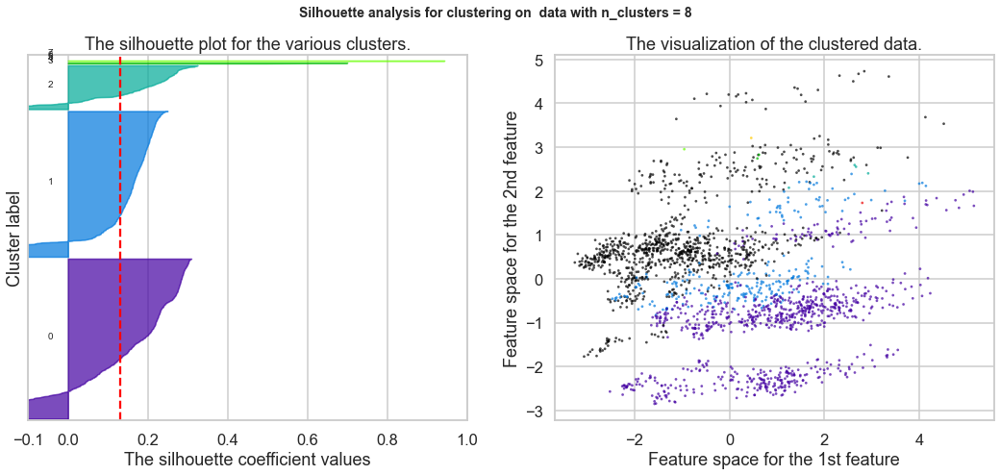

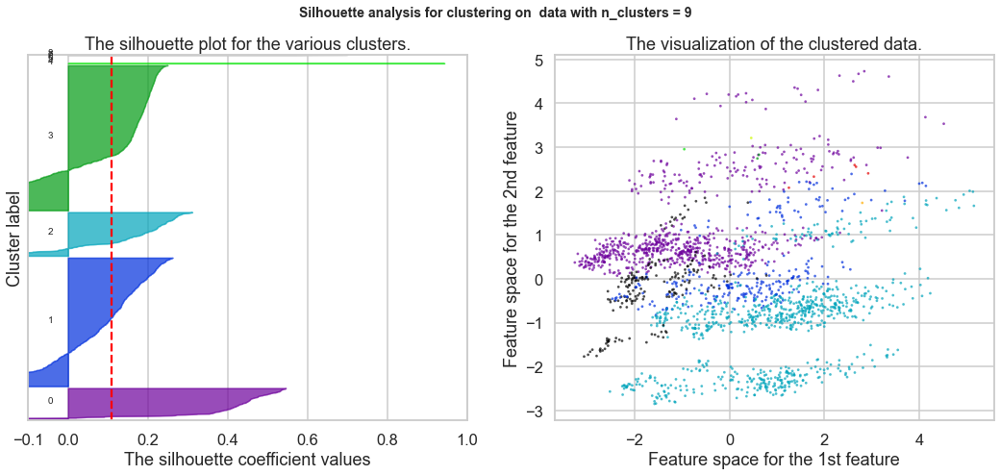

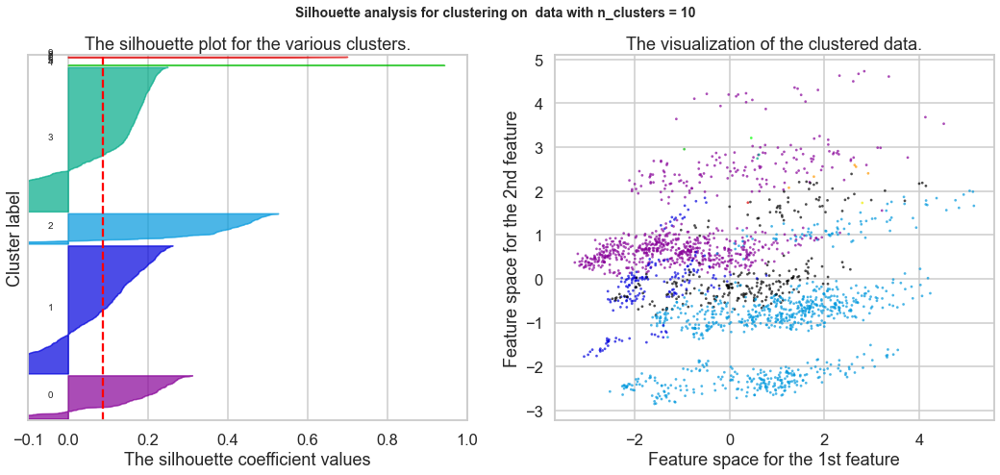

In [104]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='single')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()


Euclidean & Average
(Based on the silhouette Sore the best k is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.36592852067351805
For n_clusters = 3 The average silhouette_score is : 0.22072768475399238
For n_clusters = 4 The average silhouette_score is : 0.2080535467523126
For n_clusters = 5 The average silhouette_score is : 0.2202134054093152
For n_clusters = 6 The average silhouette_score is : 0.21554867937771469
For n_clusters = 7 The average silhouette_score is : 0.20137634229466272
For n_clusters = 8 The average silhouette_score is : 0.17568717545833112
For n_clusters = 9 The average silhouette_score is : 0.17220631245870885
For n_clusters = 10 The average silhouette_score is : 0.1973538031059848


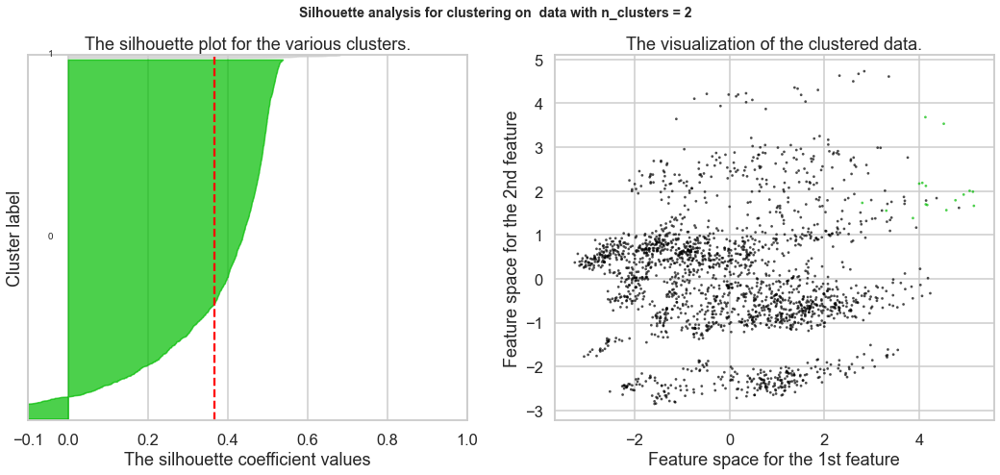

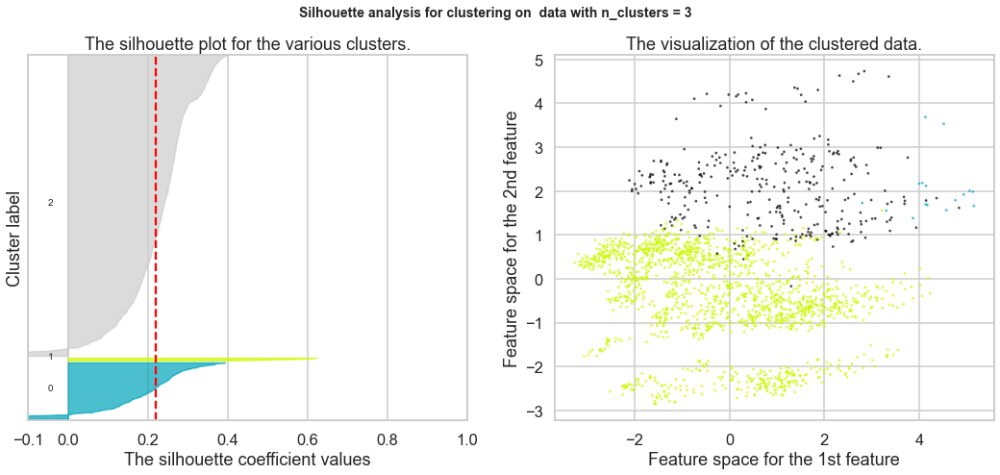

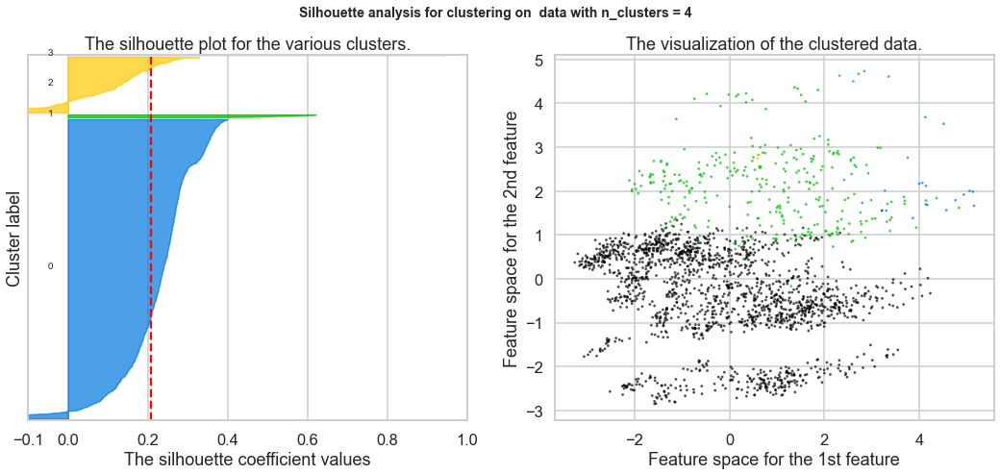

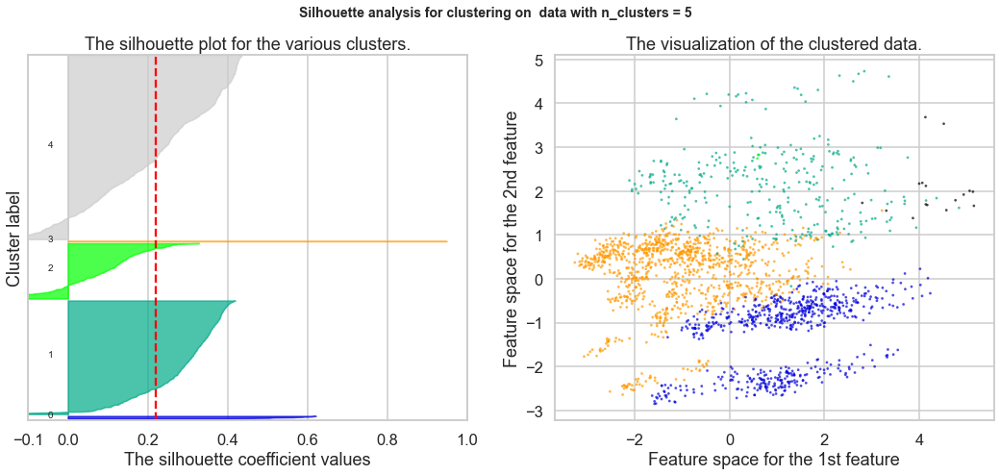

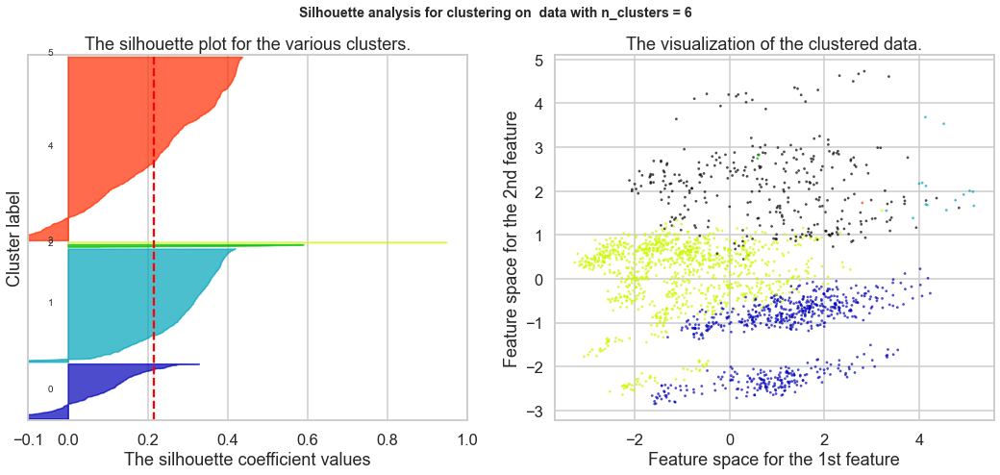

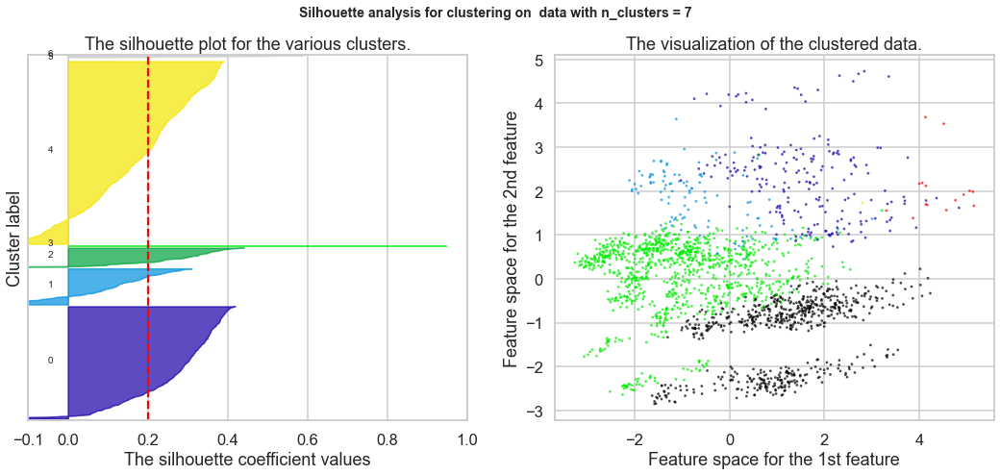

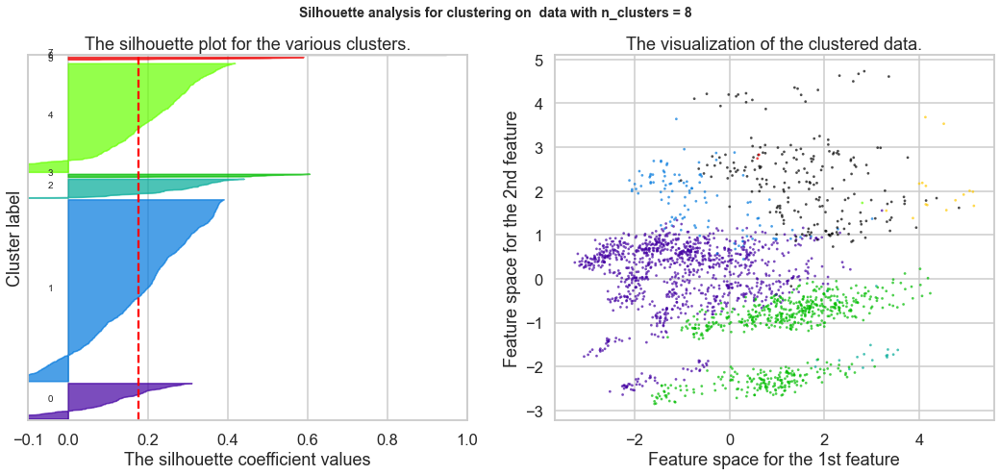

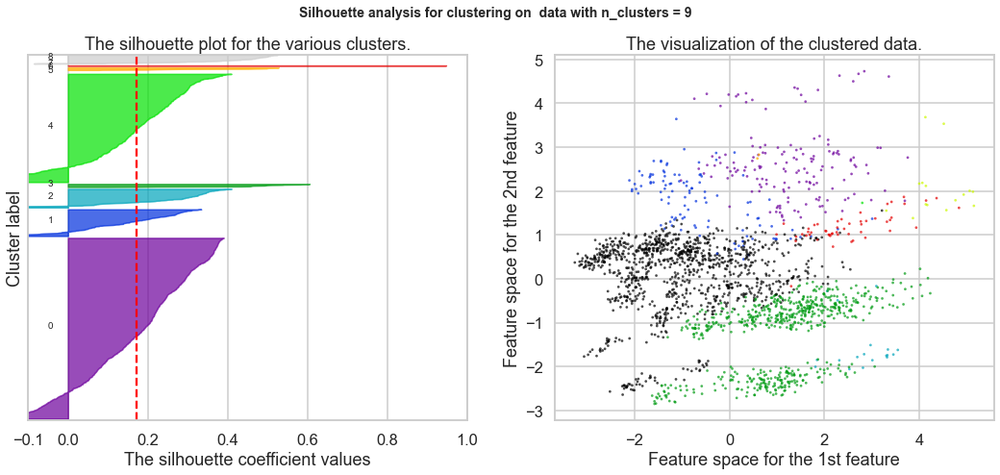

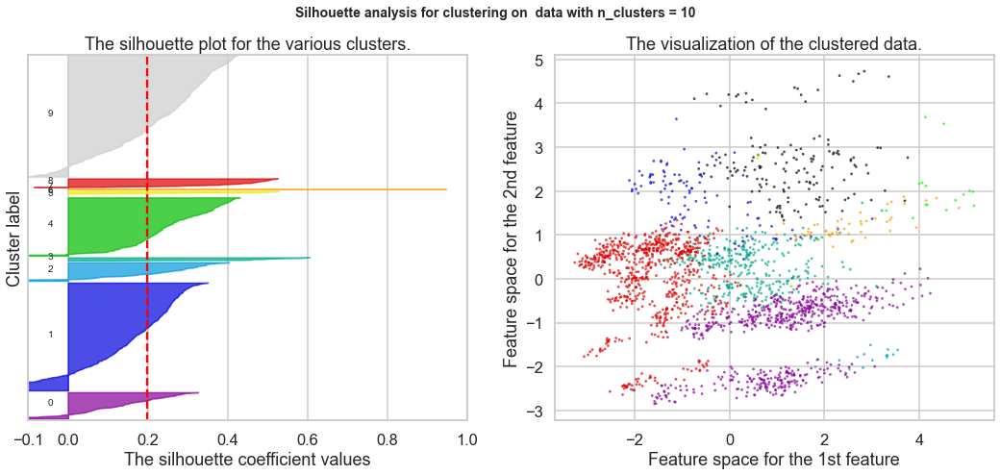

In [105]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='average')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Cosine & Single
(Based on the silhouette Sore the best k is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.024081288003810687
For n_clusters = 3 The average silhouette_score is : -0.08038076810969869
For n_clusters = 4 The average silhouette_score is : -0.13878641478657783
For n_clusters = 5 The average silhouette_score is : -0.19695983609262904
For n_clusters = 6 The average silhouette_score is : -0.2138573753810864
For n_clusters = 7 The average silhouette_score is : -0.22736403957894577
For n_clusters = 8 The average silhouette_score is : -0.21666006851343617
For n_clusters = 9 The average silhouette_score is : -0.18293603609125011
For n_clusters = 10 The average silhouette_score is : -0.17353716646648054


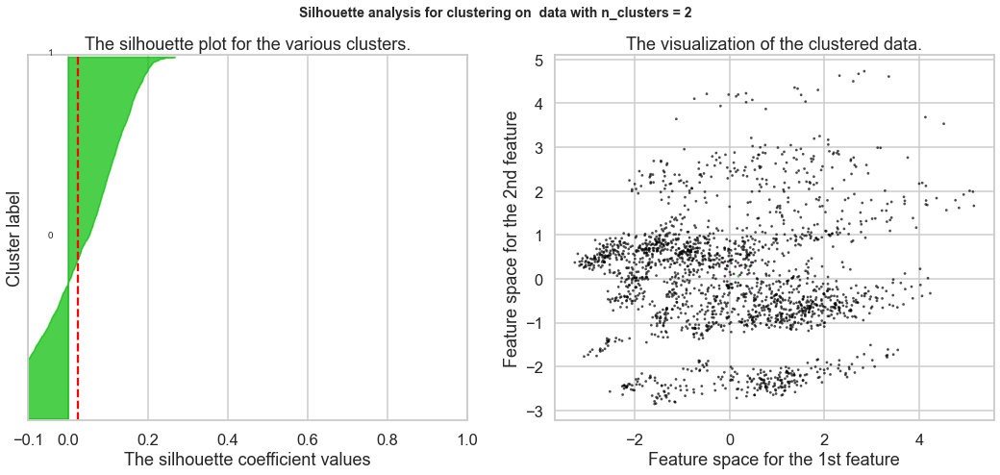

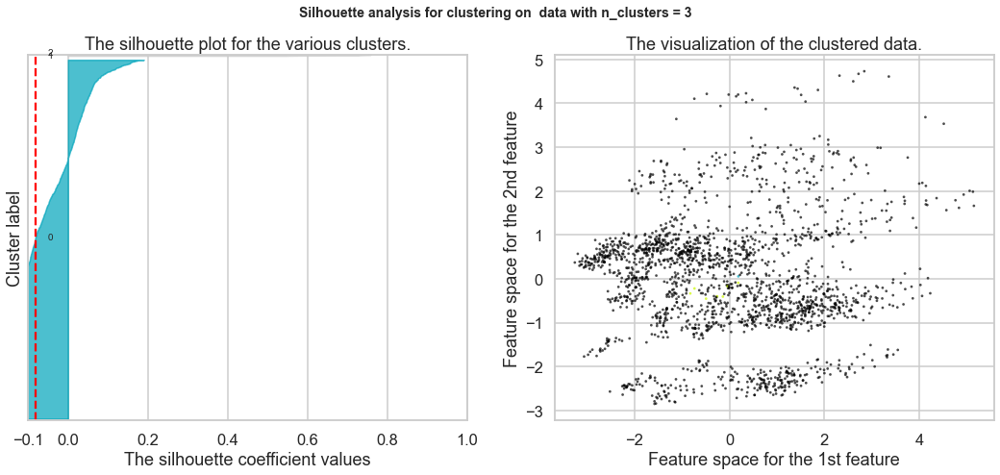

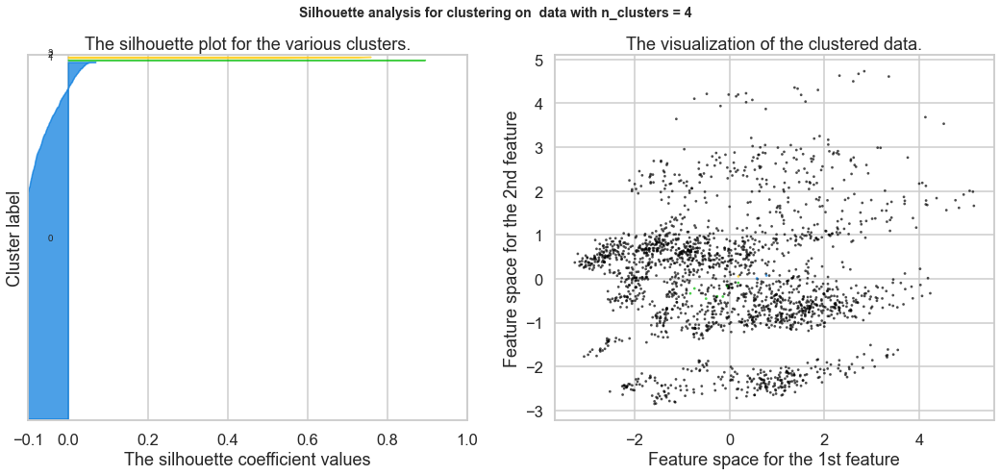

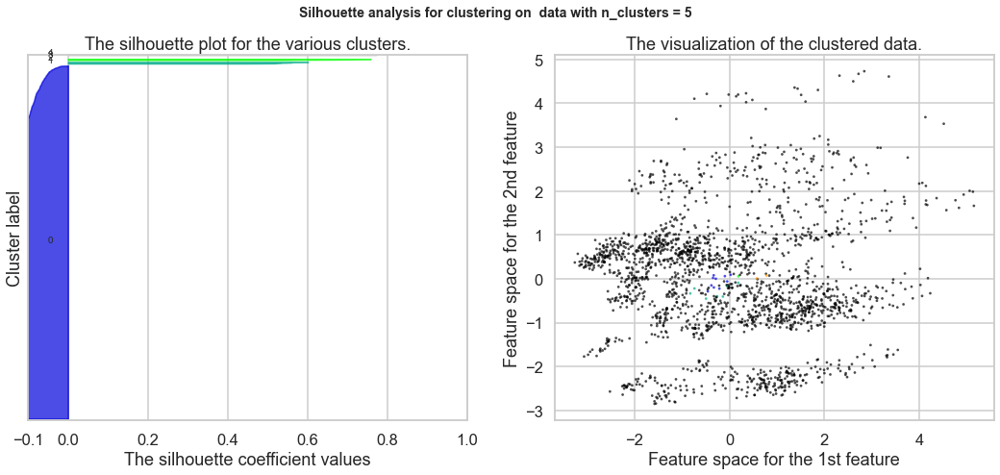

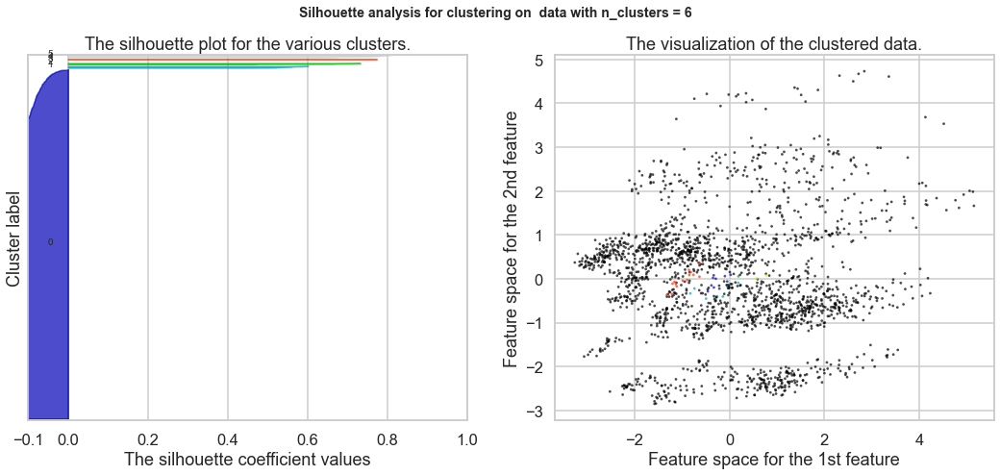

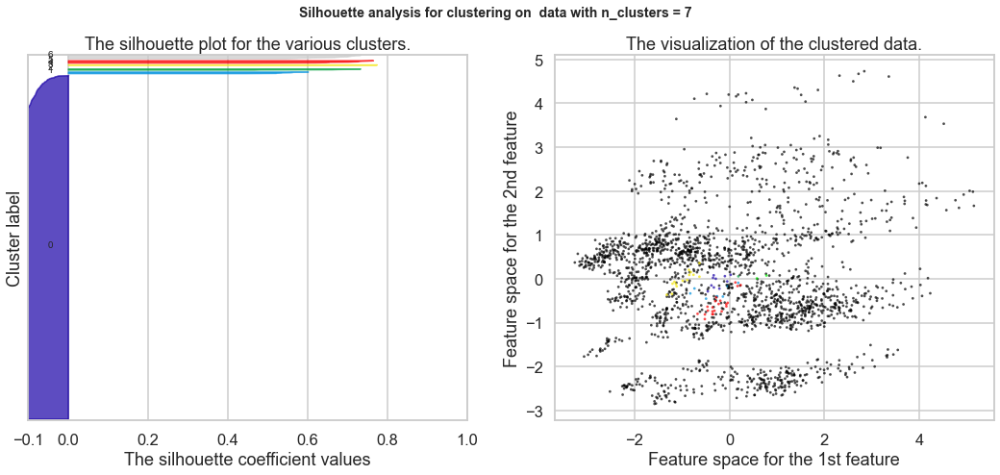

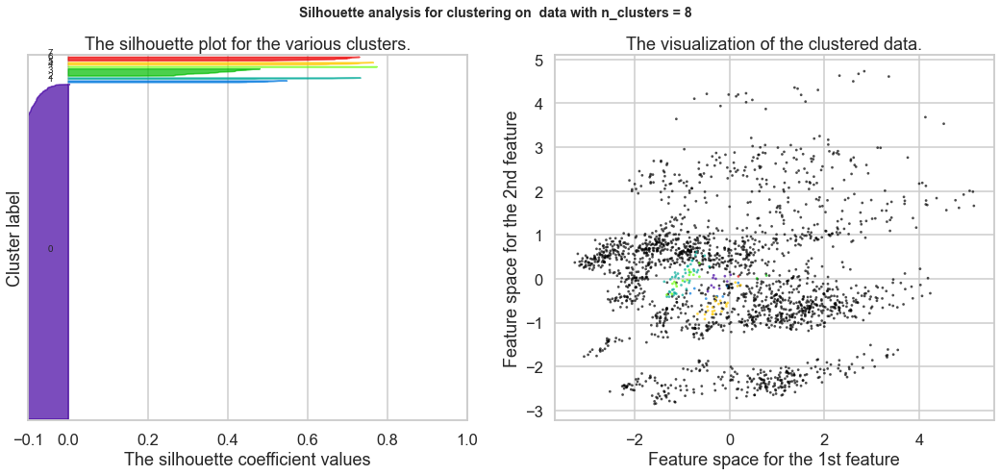

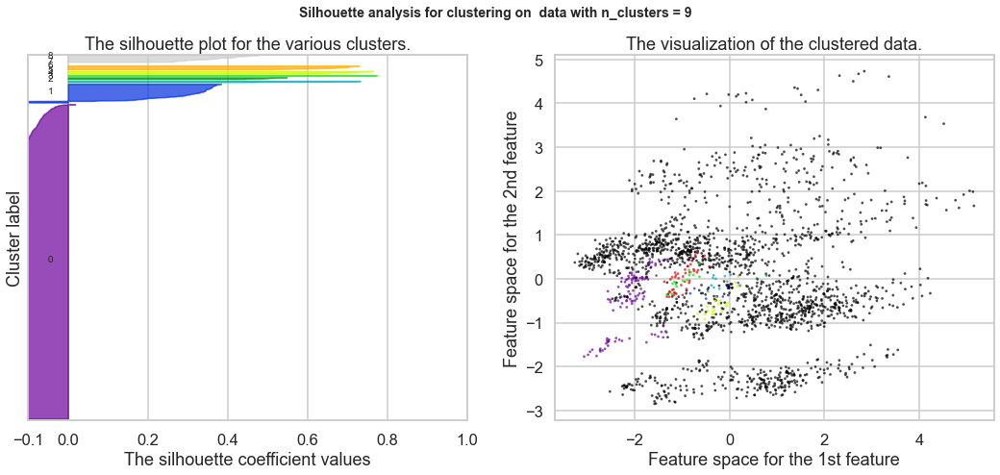

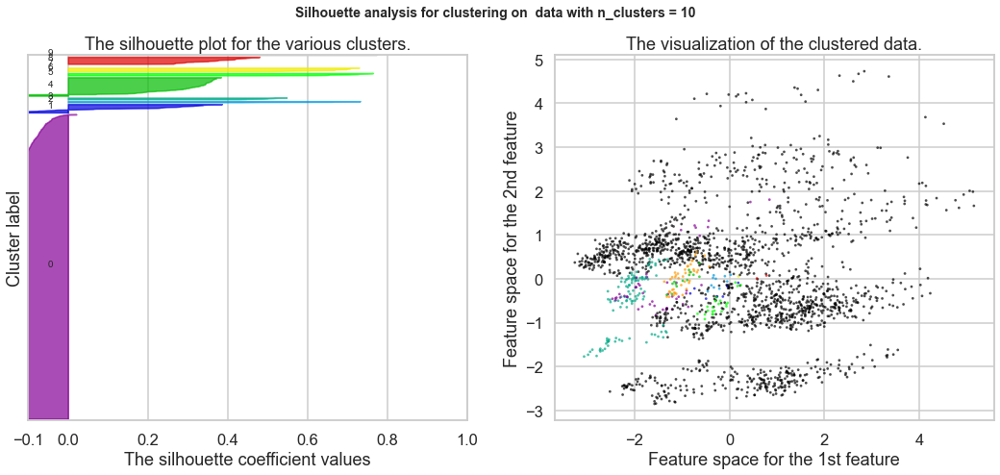

In [106]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='single')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Cosine & Average
(Based on the silhouette Sore the best k is 3 clusters)

For n_clusters = 2 The average silhouette_score is : 0.19383718113668488
For n_clusters = 3 The average silhouette_score is : 0.2382214196203108
For n_clusters = 4 The average silhouette_score is : 0.1757647087871298
For n_clusters = 5 The average silhouette_score is : 0.19262678092116825
For n_clusters = 6 The average silhouette_score is : 0.19921463914002108
For n_clusters = 7 The average silhouette_score is : 0.21044367331453384
For n_clusters = 8 The average silhouette_score is : 0.19867109635512384
For n_clusters = 9 The average silhouette_score is : 0.21417097091612441
For n_clusters = 10 The average silhouette_score is : 0.21056016138378952


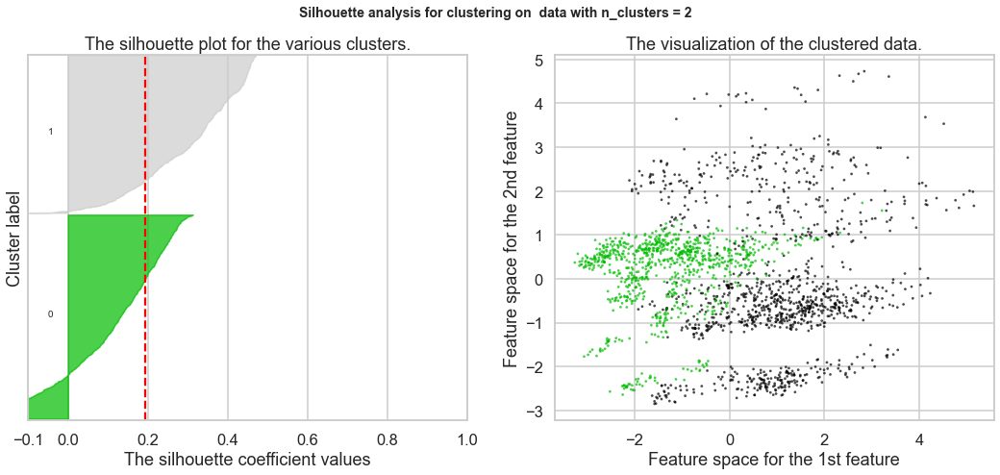

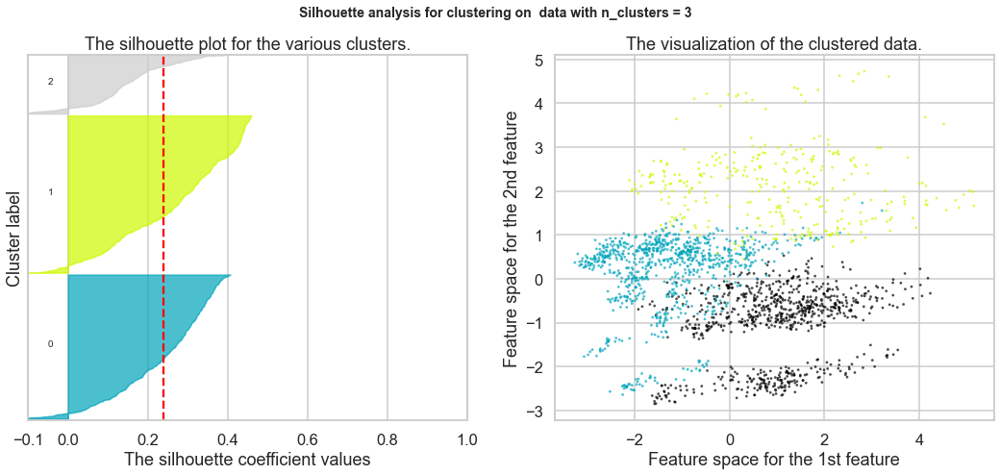

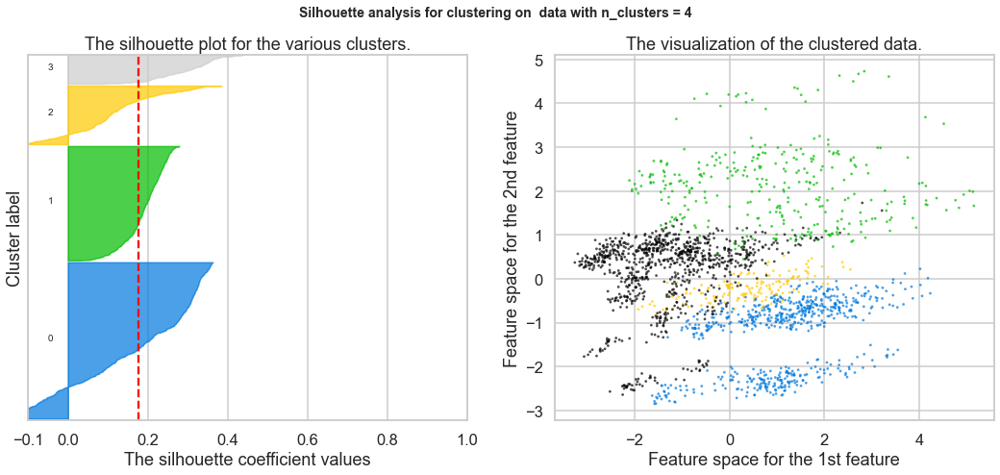

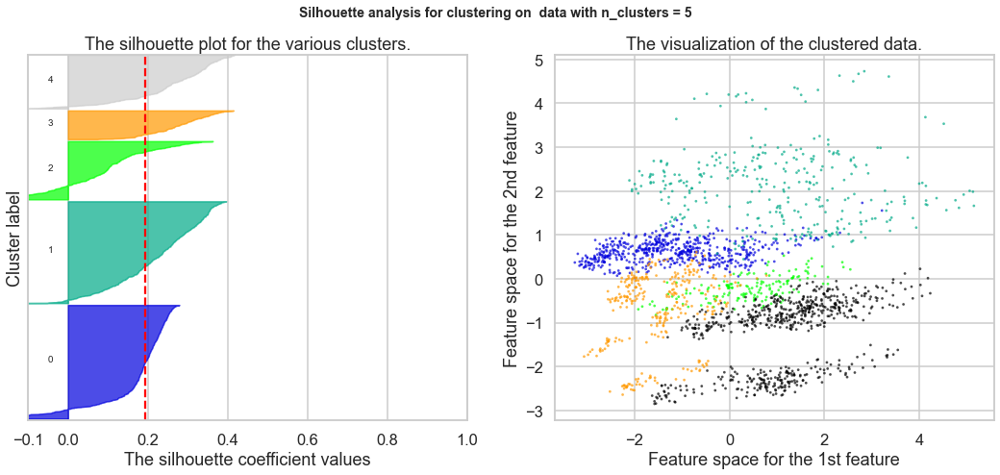

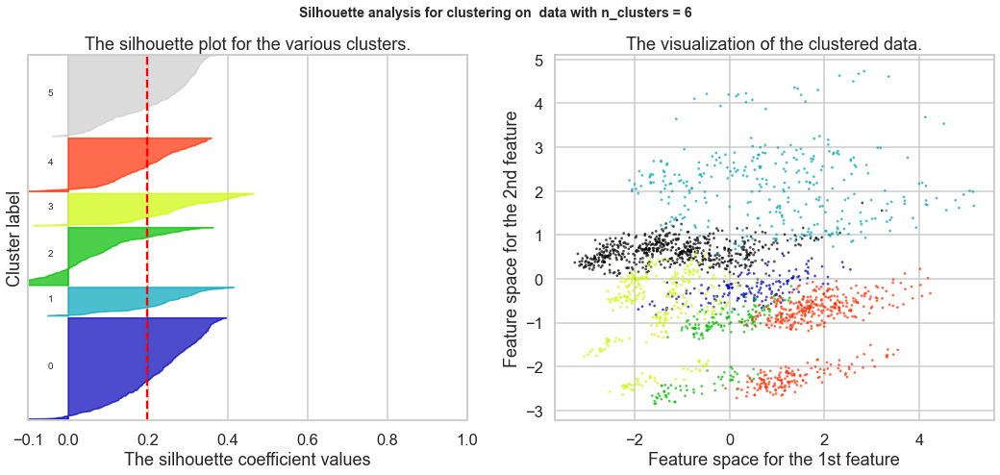

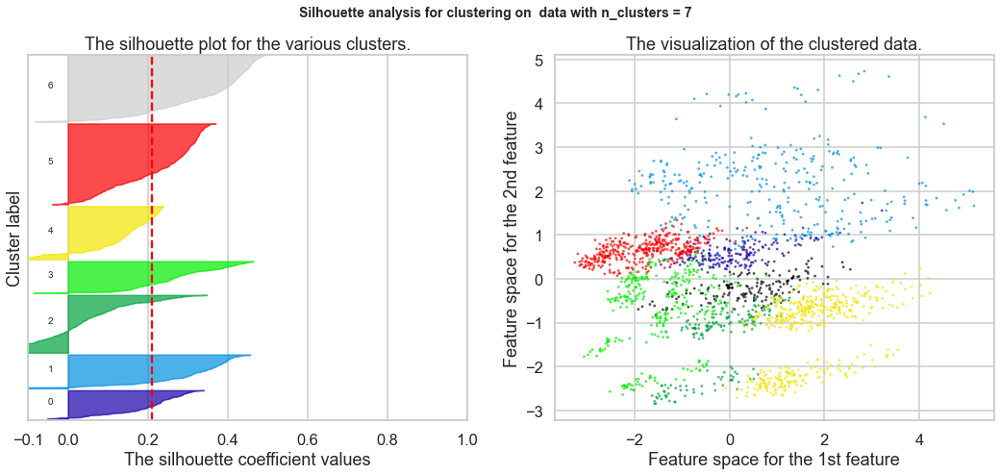

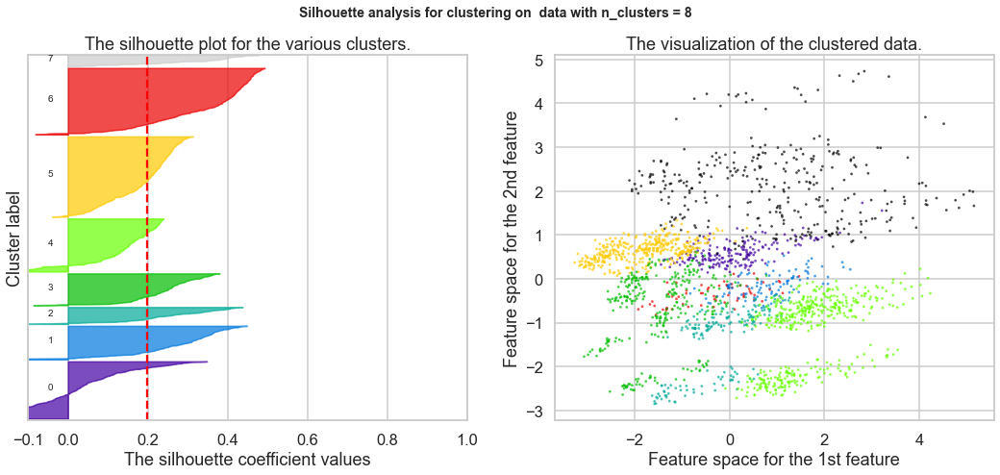

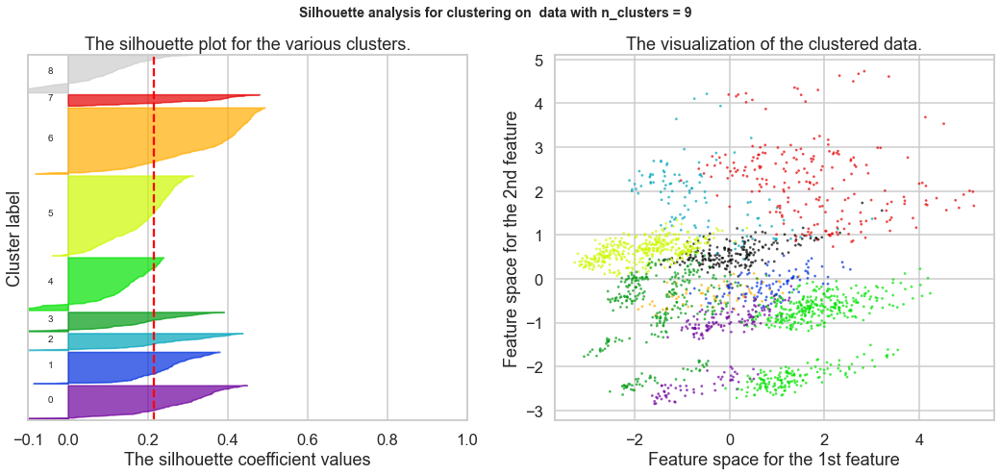

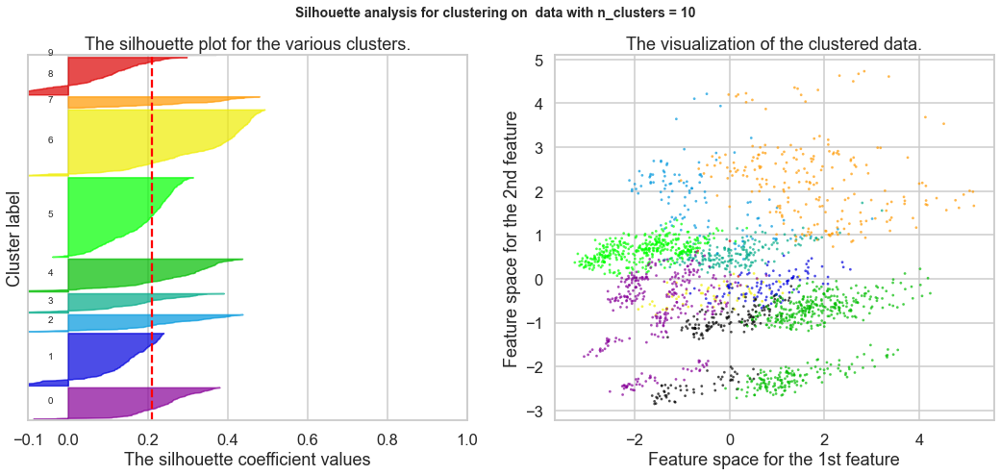

In [107]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cosine', linkage='average')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Manhattan & Single
(Based on the silhouette Sore the best k is 2 clusters)

For n_clusters = 2 The average silhouette_score is : 0.30991073468773084
For n_clusters = 3 The average silhouette_score is : 0.27639525619748767
For n_clusters = 4 The average silhouette_score is : 0.17980330701713504
For n_clusters = 5 The average silhouette_score is : 0.17474765294949338
For n_clusters = 6 The average silhouette_score is : 0.1547921697927178
For n_clusters = 7 The average silhouette_score is : 0.01980820386257434
For n_clusters = 8 The average silhouette_score is : 0.021144233643569373
For n_clusters = 9 The average silhouette_score is : -0.021691255268454262
For n_clusters = 10 The average silhouette_score is : -0.029886075078008435


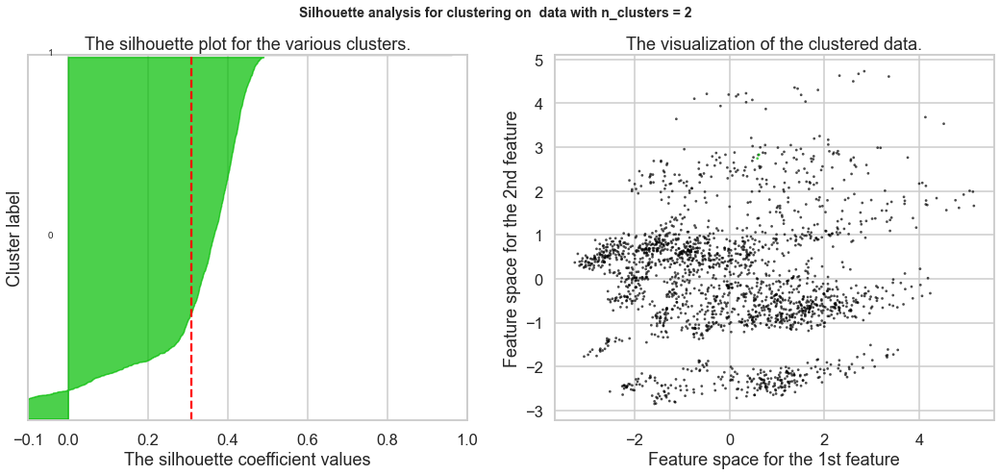

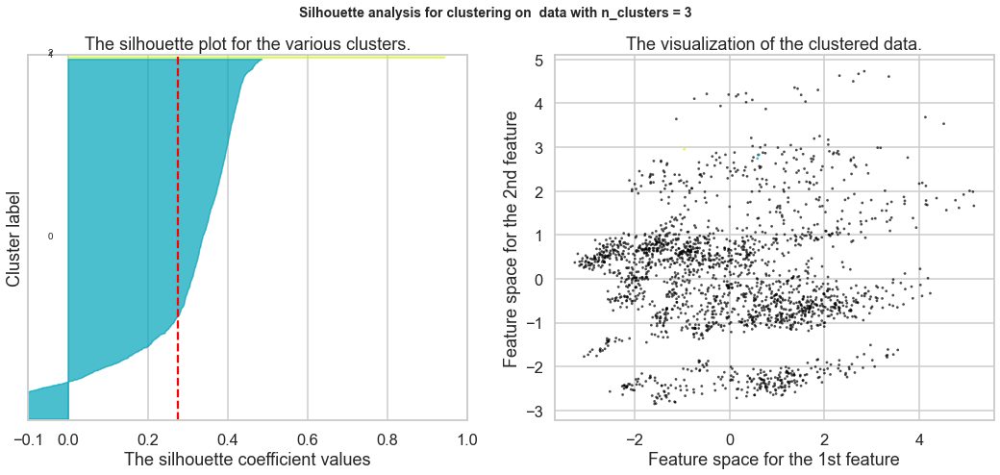

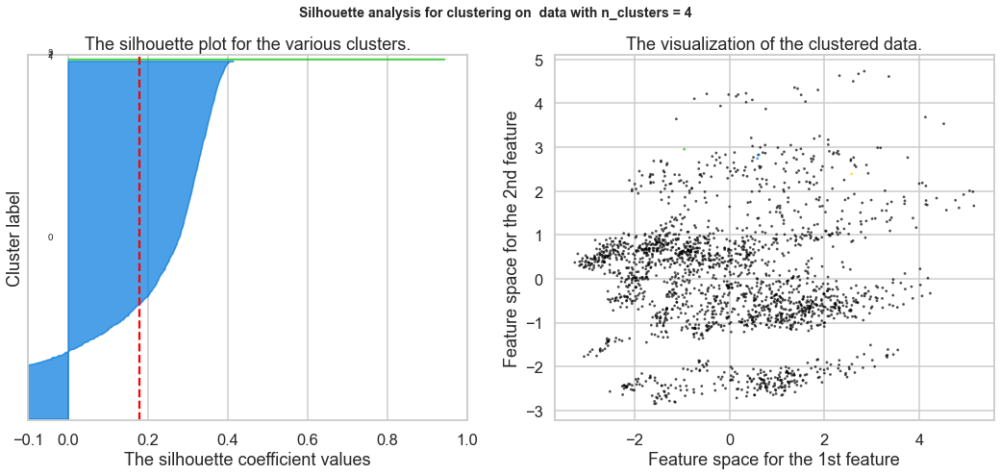

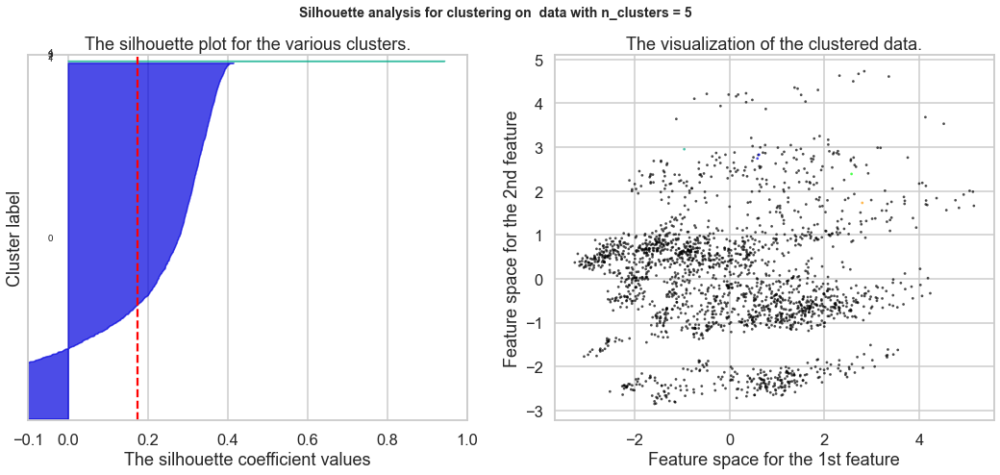

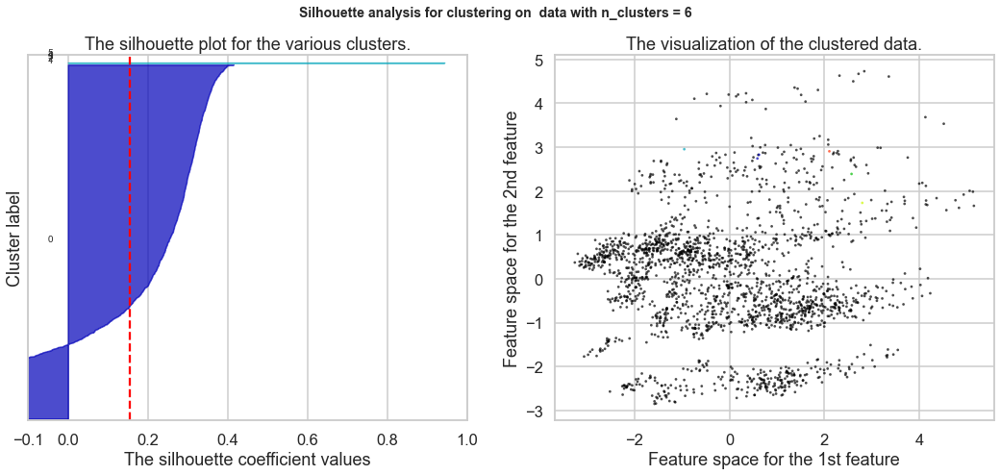

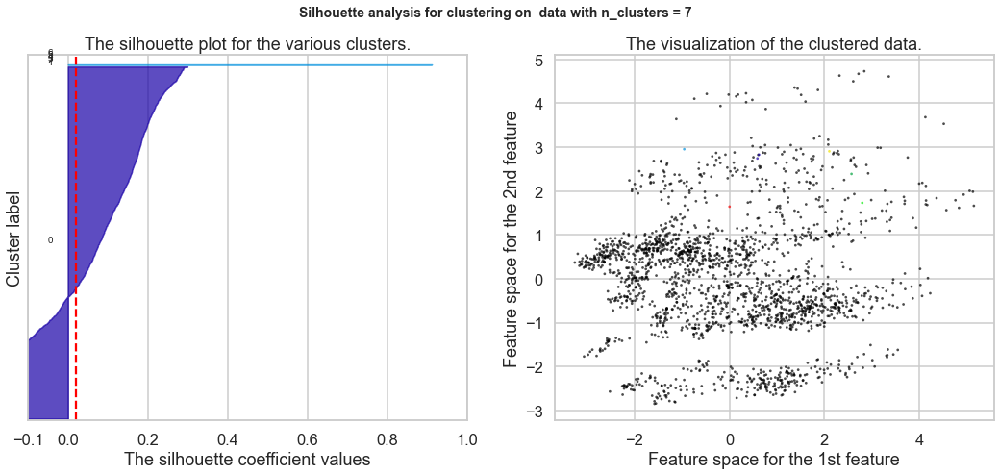

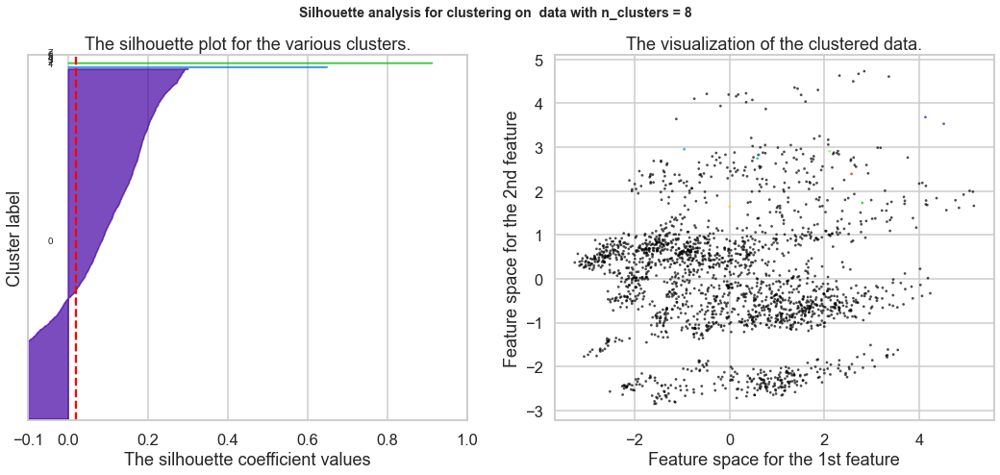

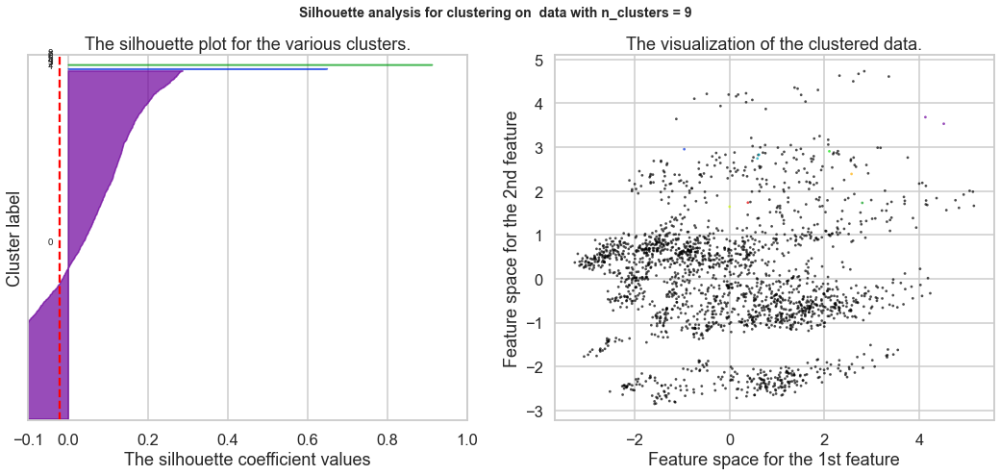

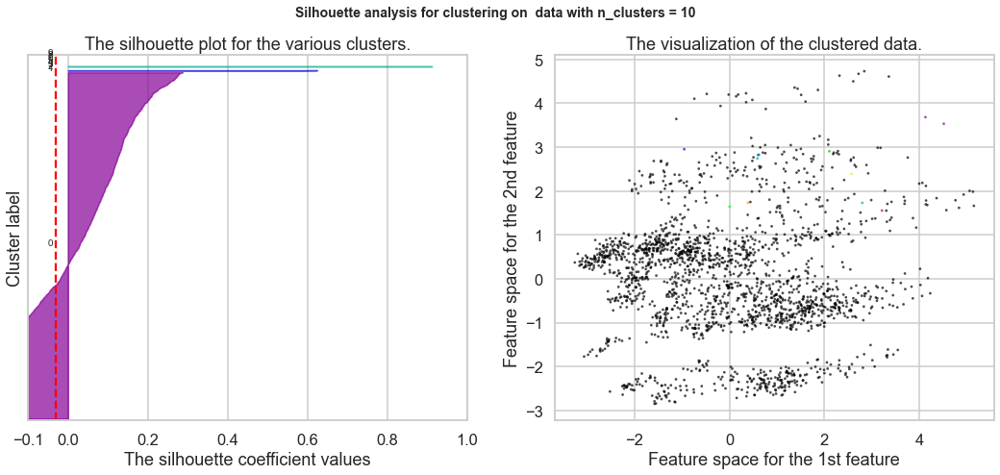

In [108]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='single')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Manhattan & Average
(Based on the silhouette Sore the best k is 8 clusters)

For n_clusters = 2 The average silhouette_score is : 0.20536034264399053
For n_clusters = 3 The average silhouette_score is : 0.19428677174823436
For n_clusters = 4 The average silhouette_score is : 0.21479735326063176
For n_clusters = 5 The average silhouette_score is : 0.21136062578244919
For n_clusters = 6 The average silhouette_score is : 0.20468837518718302
For n_clusters = 7 The average silhouette_score is : 0.22523508787299465
For n_clusters = 8 The average silhouette_score is : 0.2309595226877624
For n_clusters = 9 The average silhouette_score is : 0.22928072538138122
For n_clusters = 10 The average silhouette_score is : 0.20696692262812313


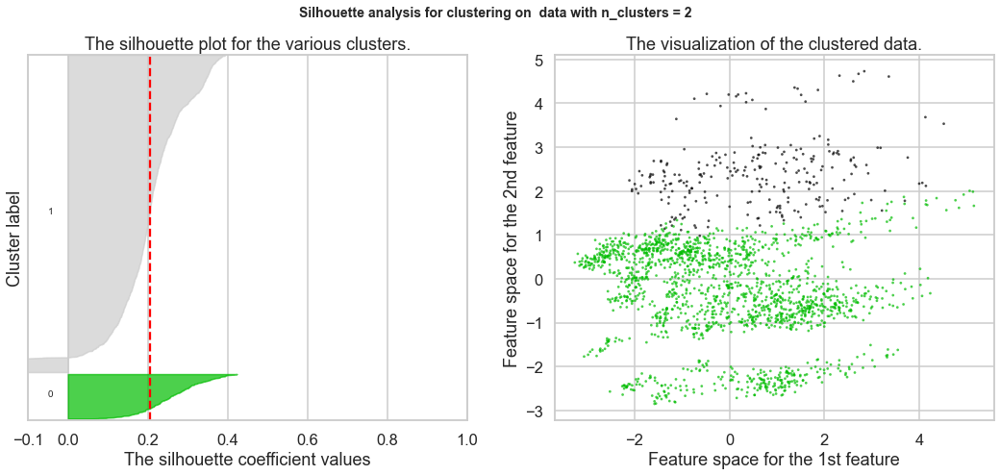

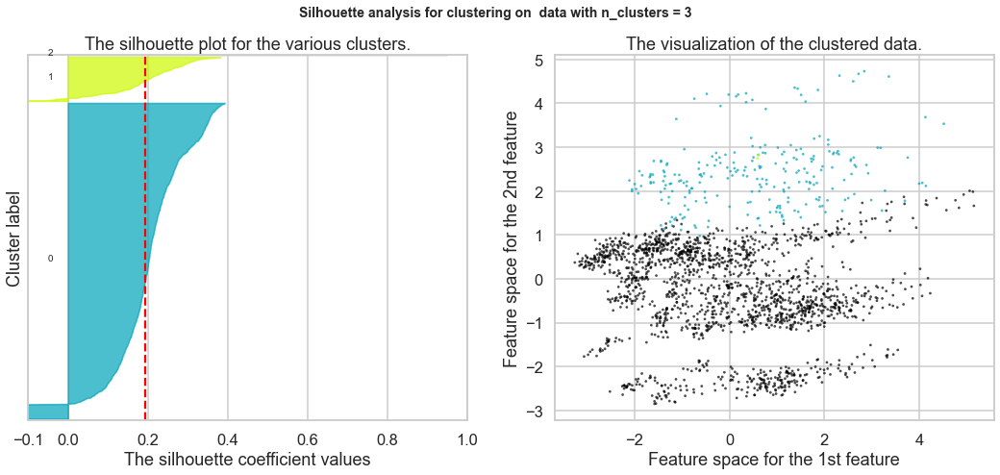

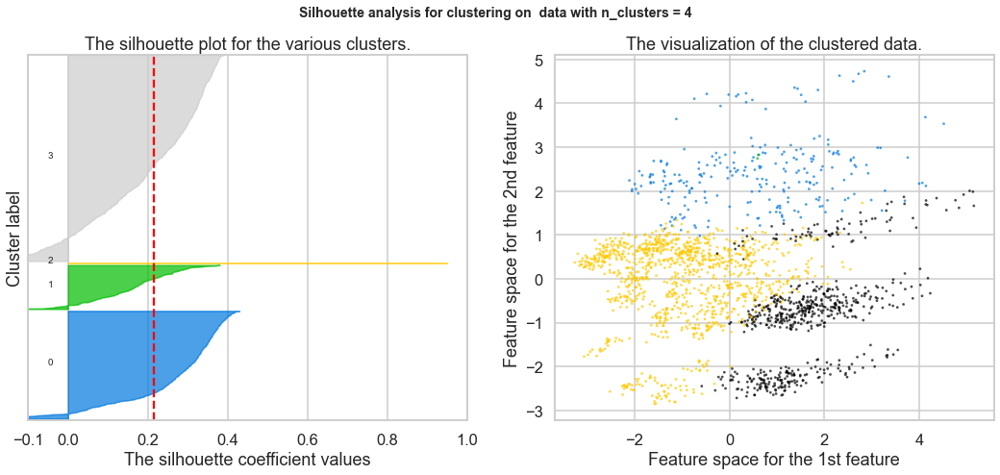

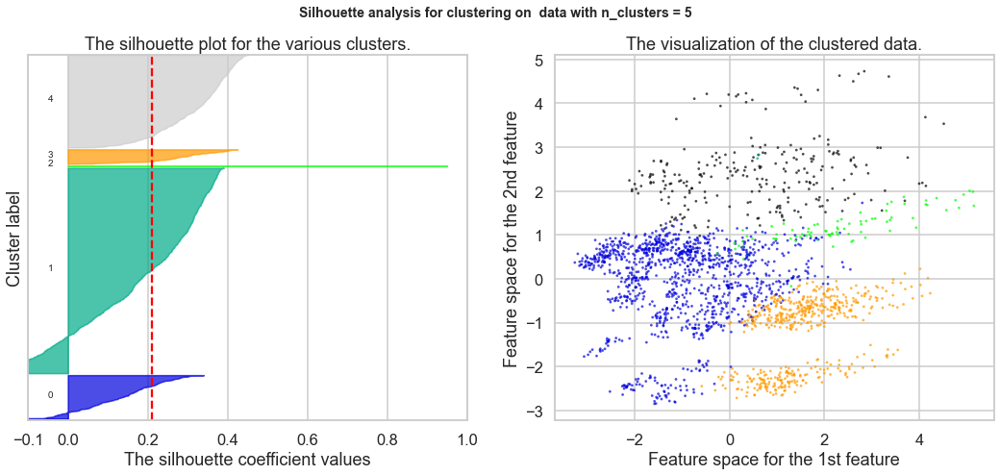

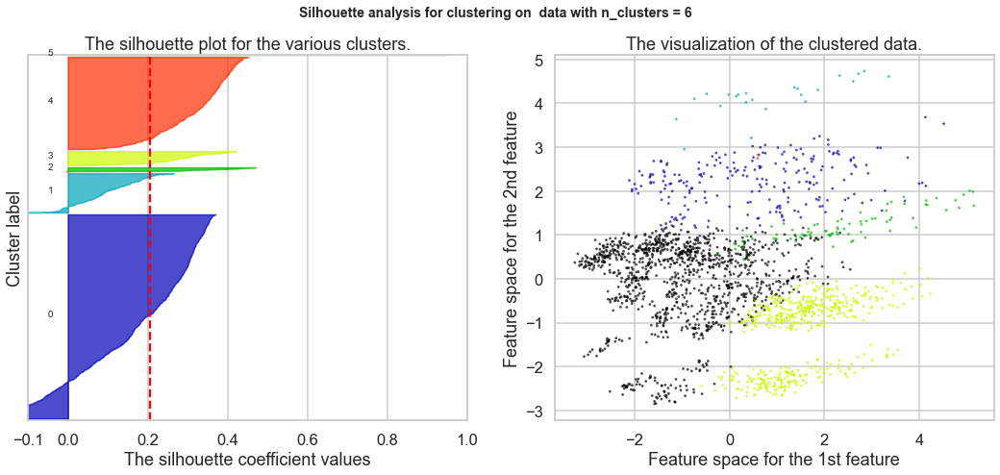

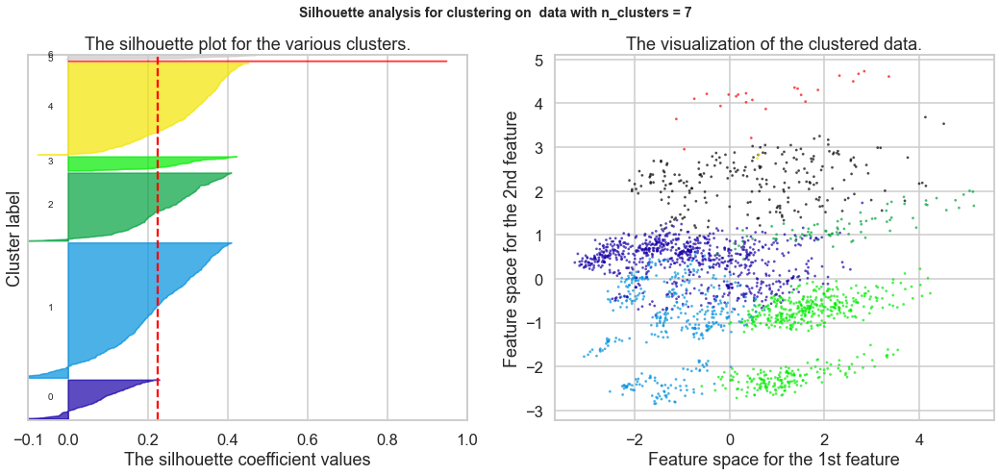

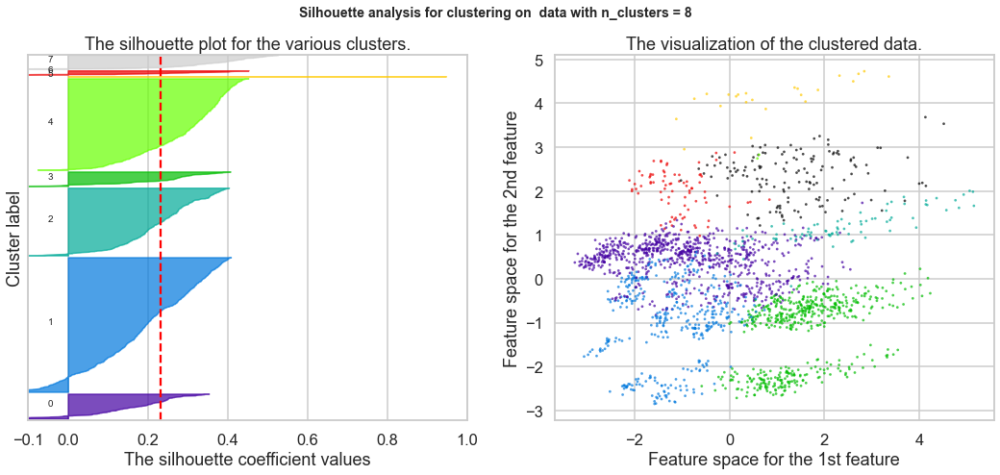

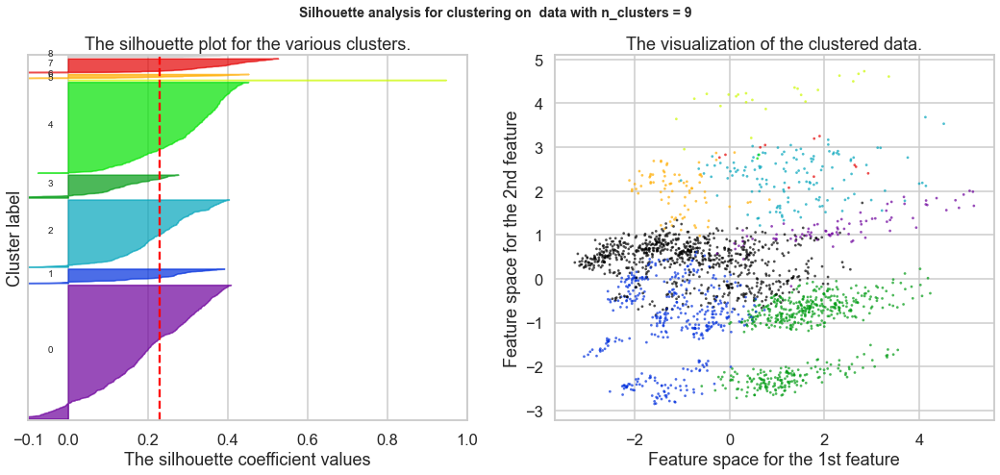

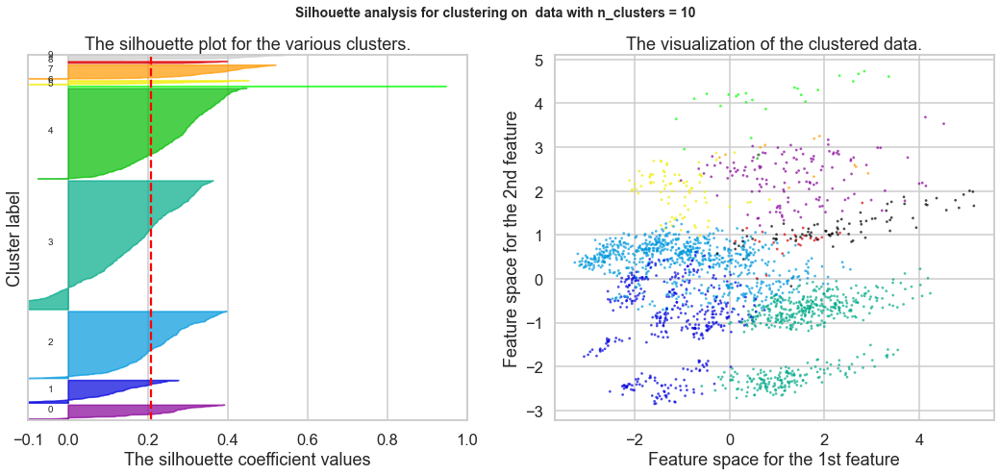

In [109]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import AgglomerativeClustering
import matplotlib.cm as cm

for n_clusters in range(2,11):
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
 
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(dfc) + (n_clusters) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='average')
    cluster_labels = clusterer.fit_predict(dfc)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(dfc, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(dfc, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i+1) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral((cluster_labels.astype(float)) / n_clusters)
    ax2.scatter(PCA_2d[:, 0], PCA_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

   

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for clustering on  data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

In [110]:
def hierachy_plot(df1, numk):
    distortions = []
    for k in range(2,numk):
        hac = AgglomerativeClustering(n_clusters=k).fit(df1)
        df_2 = hac.labels_
        distortions.append(silhouette_score(df1, df_2))

    print(distortions)
    K = range(2, numk)    
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title('The Hierachy Method using silhouette_score')
    plt.show()

[0.5770346019475988, 0.4466890410285909, 0.4006363159855973, 0.33058726295230545, 0.31485480100512825, 0.316969830299128, 0.310946529007258, 0.31143422475471655, 0.3161120375980681, 0.2990064463470654, 0.3050717010768743, 0.31729733710109526, 0.3165285044481548]


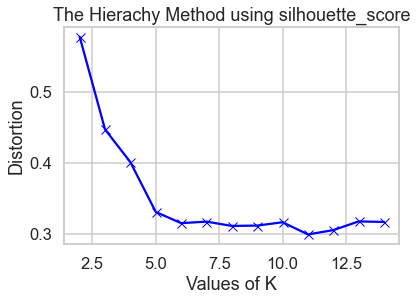

In [111]:
df_scale2=StandardScaler().fit_transform(dfc)
hierachy_plot(df_scale1, 15)

In [112]:
hac = AgglomerativeClustering(n_clusters= 2).fit(df_scale2)
df_scale1_2 = hac.labels_
db_clustered1_2=hac.labels_
print('/*---------------- Grap Hierarchical----------------*/')
db_clustered2 = df_scale2[(df_scale1_2 >= 0)]
print(silhouette_score(db_clustered2, db_clustered1_2))
print('/*---------------- overall Hierarchical----------------*/')
silhouette_score(df_scale2, df_scale1_2 )

/*---------------- Grap Hierarchical----------------*/
0.21081864797400243
/*---------------- overall Hierarchical----------------*/


0.21081864797400243

# DBScan

In [114]:
import numpy as np
import pandas as pd
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
 
# Defining the list of hyperparameters to try
eps_list=np.arange(start=0.1, stop=3, step=0.1)
min_sample_list=np.arange(start=5, stop=25, step=1)
 
# Creating empty data frame to store the silhouette scores for each trials
silhouette_scores_data=pd.DataFrame()
 
for eps_trial in eps_list:
    for min_sample_trial in min_sample_list:
        
        # Generating DBSAN clusters
        db = DBSCAN(eps=eps_trial, min_samples=min_sample_trial)
        
        if(len(np.unique(db.fit_predict(dfc)))>1):
            sil_score=silhouette_score(dfc, db.fit_predict(dfc))
        else:
            continue
        trial_parameters="eps:" + str(eps_trial.round(1)) +" min_sample :" + str(min_sample_trial)
        
        silhouette_scores_data=silhouette_scores_data.append(pd.DataFrame(data=[[sil_score,trial_parameters]], columns=["score", "parameters"]))
 
# Finding out the best hyperparameters with highest Score
silhouette_scores_data.sort_values(by='score', ascending=False).head(1)

,score,parameters
0,0.368443,eps:2.3 min_sample :16


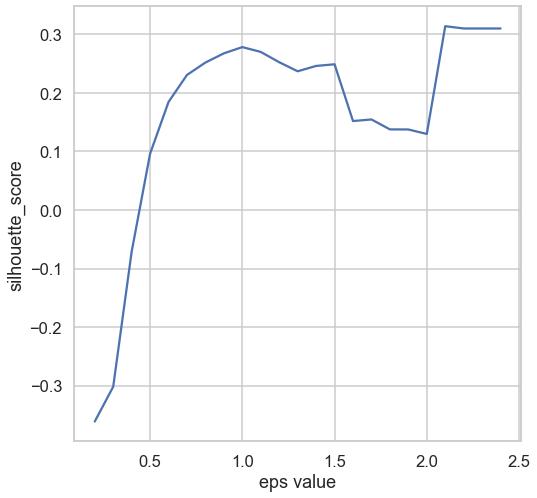

In [187]:
# from sklearn.metrics import silhouette_score

# list of eps values
#  eps_range=[0.1,0.25,0.5,0.75,0.8,0.9,1,1.25,1.5,1.75,1.8,1.9,2,2.25,2.5]
eps_range = [ 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8,1.9,2,2.1,2.2,2.3,2.4]
#               1.9,2,2.1,2.2,2.3,2.4]
# 2.5,2.6,2.7,2.8,2.9,]

# list to store silhouette_score values
silhouette_scores =[]

# loop over different eps values
for eps in eps_range:
    # perform clustering using DBSCAN
    db = DBSCAN(eps=eps)
    if(len(np.unique(db.fit_predict(dfc)))>1):
        sil_score=silhouette_score(dfc, db.fit_predict(dfc))
    else:
        continue
#     clustering_model.fit(Multi_blob_Data)
    # calculate silhouette_score
    silhouette_score_value = silhouette_score(dfc, db.labels_)
    # store silhouette_score in list
    silhouette_scores.append(silhouette_score_value)

# plot silhouette_score versus eps

plt.plot(eps_range, silhouette_scores)
plt.xlabel('eps value')
plt.ylabel('silhouette_score')
plt.show()

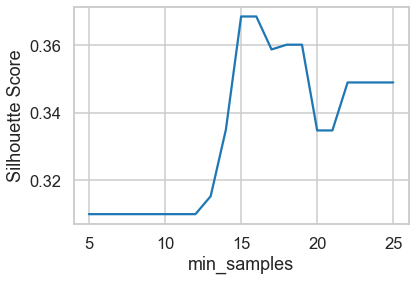

In [116]:
min_samples_values = [5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25]

scores = []

for min_samples in min_samples_values:
    dbscan = DBSCAN(min_samples=min_samples, eps=2.3)
    dbscan.fit(dfc)
    labels = dbscan.labels_
    scores.append(silhouette_score(dfc, labels))

plt.plot(min_samples_values, scores)
plt.xlabel('min_samples')
plt.ylabel('Silhouette Score')
plt.show()

In [117]:
from numpy import unique
model = DBSCAN(eps=2.3, min_samples= 16)
# rule of thumb for min_samples: 2*len(cluster_df.columns)
# fit model and predict clusters
yhat = model.fit_predict(dfc)
# retrieve unique clusters
clusters = unique(yhat)
score_dbsacn_s = silhouette_score(dfc, yhat, metric='euclidean')
print('Silhouette Score: %.4f' % score_dbsacn_s)

Silhouette Score: 0.3684


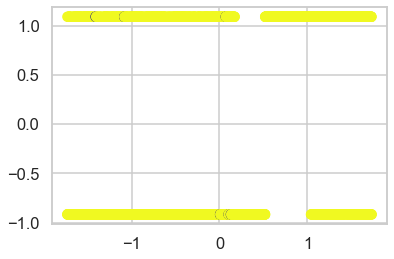

{0, -1}
Estimated no. of clusters: 2
Estimated no. of noise points: 6


In [118]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps = 2.3, min_samples = 16).fit(dfc) # fitting the model
labels = dbscan.labels_ # getting the labels
core_samples_mask=np.zeros_like(dbscan.labels_,dtype=bool)
core_samples_mask[dbscan.core_sample_indices_]=True
plt.scatter(dfc[:, 0], dfc[:,1], c = labels, cmap= "plasma") # plotting the clusters
plt.show() # showing the plot
no_clusters = len(set(labels))
no_noise = list(labels).count(-1)
print(set(labels))
print('Estimated no. of clusters: %d' % no_clusters)
print('Estimated no. of noise points: %d' % no_noise)

Gaussian Mixture 


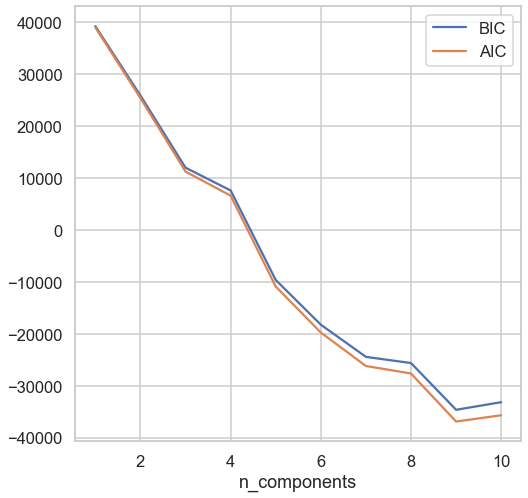

In [136]:
n_components = np.arange(1, 11)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(dfc) for n in n_components]
plt.plot(n_components, [m.bic(dfc) for m in models], label='BIC')
plt.plot(n_components, [m.aic(dfc) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

In [138]:
gmm = GaussianMixture(n_components=3)
gmm.fit(dfc)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=3, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

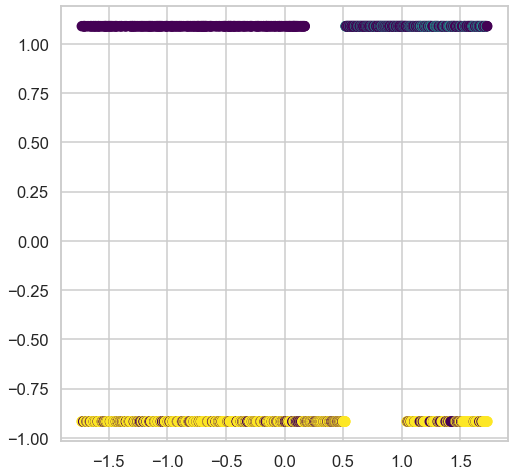

In [139]:
labels = gmm.predict(dfc)
plt.scatter(dfc[:, 0], dfc[:, 1], c=labels, cmap='viridis');